# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!mkdir data

## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:19, 9.51MB/s]                                     
SVHN Testing Set: 64.3MB [00:07, 8.50MB/s]                                     


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

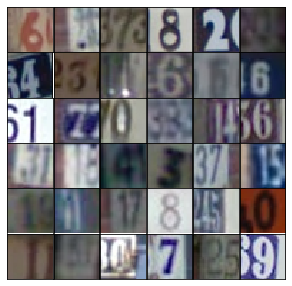

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # batch_size = z.shape.as_list()[0]
        
        # First fully connected layer, 4x4x1024
        x = tf.layers.dense(z, 4*4*1024, activation=None, use_bias=False)
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.reshape(tf.maximum(x, alpha * x), [-1, 4, 4, 1024])
    
        # convolutional layer 1, 8x8x512
        conv1 = tf.layers.conv2d_transpose(x, 512, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv1 = tf.layers.batch_normalization(conv1, training=training)
        conv1 = tf.maximum(conv1, alpha * conv1)
        
        # convolutional layer 2, 16x16x256
        conv2 = tf.layers.conv2d_transpose(conv1, 256, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv2 = tf.layers.batch_normalization(conv2, training=training)
        conv2 = tf.maximum(conv2, alpha * conv2)
        
        # convolutional layer 3, 32x32x128
        conv3 = tf.layers.conv2d_transpose(conv2, 128, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv3 = tf.layers.batch_normalization(conv3, training=training)
        conv3 = tf.maximum(conv3, alpha * conv3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d(conv3, output_dim, 5, strides=1, padding='same', activation=None, use_bias=True)
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        
        # convolutional layer 1, 16x16x64. No batch normalization on this layer
        conv1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same', activation=None, use_bias=True)
        conv1 = tf.maximum(conv1, alpha * conv1)
        
        # convolutional layer 2, 8x8x128
        conv2 = tf.layers.conv2d(conv1, 128, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv2 = tf.layers.batch_normalization(conv2, training=True)
        conv2 = tf.maximum(conv2, alpha * conv2)
        
        # convolutional layer 3, 4x4x256
        conv3 = tf.layers.conv2d(conv2, 256, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv3 = tf.layers.batch_normalization(conv3, training=True)
        conv3 = tf.maximum(conv3, alpha * conv3)
        
        # final fully connected layer, to a single sigmoid output
        #orig_shape = conv3.get_shape().as_list()
        #conv3_reshaped = tf.reshape(conv3, shape=[-1, orig_shape[1] * orig_shape[2] * orig_shape[3]])
        conv3_reshaped = tf.reshape(conv3, shape=[-1, 4*4*256])
        logits = tf.layers.dense(conv3_reshaped, 1, activation=None, use_bias=True)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [17]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.9197... Generator Loss: 1.3342
Epoch 1/25... Discriminator Loss: 0.2285... Generator Loss: 2.5630
Epoch 1/25... Discriminator Loss: 0.3159... Generator Loss: 1.6006
Epoch 1/25... Discriminator Loss: 0.2158... Generator Loss: 2.0027
Epoch 1/25... Discriminator Loss: 0.1750... Generator Loss: 2.3609
Epoch 1/25... Discriminator Loss: 0.0772... Generator Loss: 3.2661
Epoch 1/25... Discriminator Loss: 0.0781... Generator Loss: 3.2789
Epoch 1/25... Discriminator Loss: 0.1102... Generator Loss: 2.9216
Epoch 1/25... Discriminator Loss: 0.0997... Generator Loss: 3.0401
Epoch 1/25... Discriminator Loss: 0.1612... Generator Loss: 2.5855


C:\Users\Jack\Miniconda3\envs\jkbml\lib\site-packages\matplotlib\axes\_base.py:1330: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


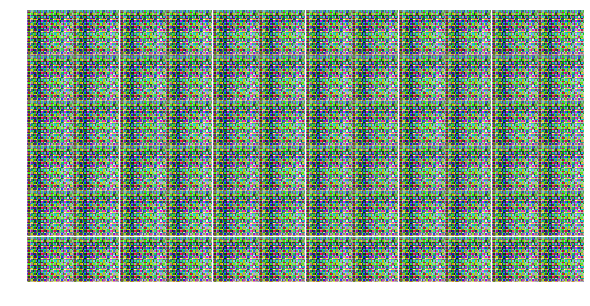

Epoch 1/25... Discriminator Loss: 0.0530... Generator Loss: 3.4394
Epoch 1/25... Discriminator Loss: 0.0998... Generator Loss: 3.2152
Epoch 1/25... Discriminator Loss: 0.1238... Generator Loss: 3.2697
Epoch 1/25... Discriminator Loss: 0.3777... Generator Loss: 1.7230
Epoch 1/25... Discriminator Loss: 0.5185... Generator Loss: 2.1998
Epoch 1/25... Discriminator Loss: 1.2119... Generator Loss: 1.3962
Epoch 1/25... Discriminator Loss: 0.3669... Generator Loss: 2.0342
Epoch 1/25... Discriminator Loss: 0.2788... Generator Loss: 2.2272
Epoch 1/25... Discriminator Loss: 0.2307... Generator Loss: 2.2134
Epoch 1/25... Discriminator Loss: 0.1172... Generator Loss: 2.9719


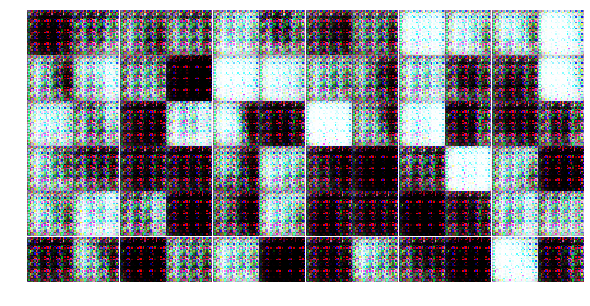

Epoch 1/25... Discriminator Loss: 0.0577... Generator Loss: 4.3244
Epoch 1/25... Discriminator Loss: 0.0987... Generator Loss: 3.0413
Epoch 1/25... Discriminator Loss: 0.3177... Generator Loss: 1.4930
Epoch 1/25... Discriminator Loss: 0.7792... Generator Loss: 1.4856
Epoch 1/25... Discriminator Loss: 0.1933... Generator Loss: 2.5893
Epoch 1/25... Discriminator Loss: 0.7412... Generator Loss: 1.9905
Epoch 1/25... Discriminator Loss: 0.1229... Generator Loss: 2.7995
Epoch 1/25... Discriminator Loss: 0.5009... Generator Loss: 1.9372
Epoch 1/25... Discriminator Loss: 0.3245... Generator Loss: 2.0752
Epoch 1/25... Discriminator Loss: 0.3297... Generator Loss: 3.0297


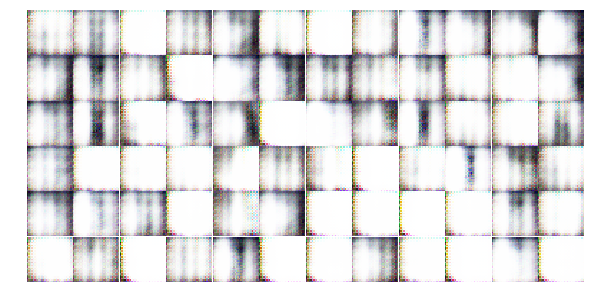

Epoch 1/25... Discriminator Loss: 0.7674... Generator Loss: 1.8444
Epoch 1/25... Discriminator Loss: 0.4377... Generator Loss: 1.7148
Epoch 1/25... Discriminator Loss: 1.2945... Generator Loss: 0.4103
Epoch 1/25... Discriminator Loss: 0.4150... Generator Loss: 1.4080
Epoch 1/25... Discriminator Loss: 0.1945... Generator Loss: 2.8311
Epoch 1/25... Discriminator Loss: 0.3974... Generator Loss: 2.6400
Epoch 1/25... Discriminator Loss: 0.4196... Generator Loss: 1.3487
Epoch 1/25... Discriminator Loss: 0.8573... Generator Loss: 1.8172
Epoch 1/25... Discriminator Loss: 0.7850... Generator Loss: 3.6646
Epoch 1/25... Discriminator Loss: 1.1304... Generator Loss: 0.7585


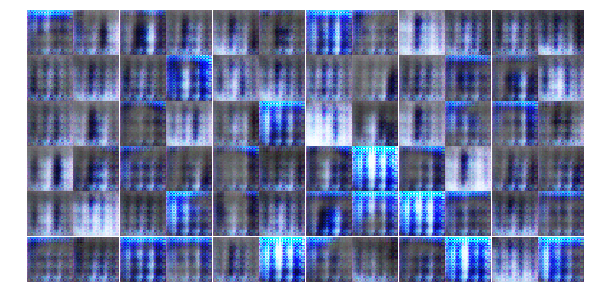

Epoch 1/25... Discriminator Loss: 0.6440... Generator Loss: 1.3851
Epoch 1/25... Discriminator Loss: 0.9746... Generator Loss: 1.5389
Epoch 1/25... Discriminator Loss: 0.5902... Generator Loss: 1.2245
Epoch 1/25... Discriminator Loss: 0.5621... Generator Loss: 1.5735
Epoch 1/25... Discriminator Loss: 0.7970... Generator Loss: 2.5939
Epoch 1/25... Discriminator Loss: 0.4193... Generator Loss: 3.0636
Epoch 1/25... Discriminator Loss: 0.7713... Generator Loss: 0.8410
Epoch 1/25... Discriminator Loss: 1.3554... Generator Loss: 2.8052
Epoch 1/25... Discriminator Loss: 1.3192... Generator Loss: 0.4468
Epoch 1/25... Discriminator Loss: 1.0196... Generator Loss: 1.2867


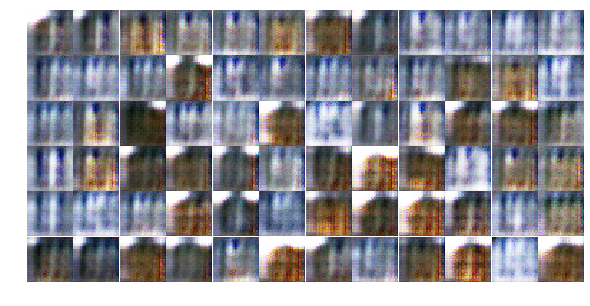

Epoch 1/25... Discriminator Loss: 0.7961... Generator Loss: 1.1573
Epoch 1/25... Discriminator Loss: 1.5151... Generator Loss: 0.4590
Epoch 1/25... Discriminator Loss: 0.9825... Generator Loss: 2.1818
Epoch 1/25... Discriminator Loss: 1.0604... Generator Loss: 0.6513
Epoch 1/25... Discriminator Loss: 0.8769... Generator Loss: 1.4665
Epoch 1/25... Discriminator Loss: 0.7192... Generator Loss: 1.3684
Epoch 1/25... Discriminator Loss: 0.6228... Generator Loss: 2.6319
Epoch 2/25... Discriminator Loss: 0.6468... Generator Loss: 2.1541
Epoch 2/25... Discriminator Loss: 1.5410... Generator Loss: 0.6832
Epoch 2/25... Discriminator Loss: 0.7433... Generator Loss: 1.4537


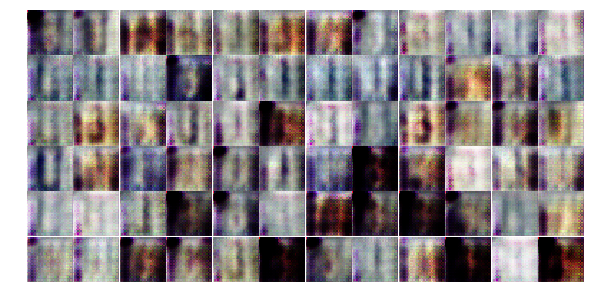

Epoch 2/25... Discriminator Loss: 1.0199... Generator Loss: 1.1233
Epoch 2/25... Discriminator Loss: 0.4168... Generator Loss: 2.3356
Epoch 2/25... Discriminator Loss: 0.3508... Generator Loss: 3.0572
Epoch 2/25... Discriminator Loss: 1.3435... Generator Loss: 0.4515
Epoch 2/25... Discriminator Loss: 0.3752... Generator Loss: 1.8255
Epoch 2/25... Discriminator Loss: 0.7795... Generator Loss: 1.1914
Epoch 2/25... Discriminator Loss: 1.3541... Generator Loss: 0.6828
Epoch 2/25... Discriminator Loss: 0.6800... Generator Loss: 1.4104
Epoch 2/25... Discriminator Loss: 0.7019... Generator Loss: 1.7420
Epoch 2/25... Discriminator Loss: 1.5461... Generator Loss: 0.5613


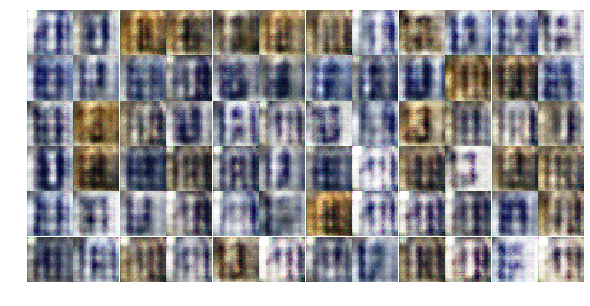

Epoch 2/25... Discriminator Loss: 1.4532... Generator Loss: 2.2901
Epoch 2/25... Discriminator Loss: 0.8173... Generator Loss: 1.2934
Epoch 2/25... Discriminator Loss: 0.7017... Generator Loss: 1.1403
Epoch 2/25... Discriminator Loss: 0.5113... Generator Loss: 1.4031
Epoch 2/25... Discriminator Loss: 0.9464... Generator Loss: 0.8021
Epoch 2/25... Discriminator Loss: 0.7202... Generator Loss: 1.7331
Epoch 2/25... Discriminator Loss: 0.8324... Generator Loss: 1.0677
Epoch 2/25... Discriminator Loss: 0.6652... Generator Loss: 1.0234
Epoch 2/25... Discriminator Loss: 0.6391... Generator Loss: 1.2978
Epoch 2/25... Discriminator Loss: 0.6018... Generator Loss: 1.1297


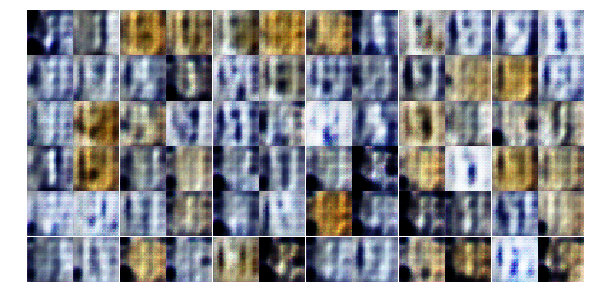

Epoch 2/25... Discriminator Loss: 0.6475... Generator Loss: 1.1385
Epoch 2/25... Discriminator Loss: 0.8602... Generator Loss: 0.9425
Epoch 2/25... Discriminator Loss: 0.3352... Generator Loss: 2.9069
Epoch 2/25... Discriminator Loss: 0.3701... Generator Loss: 2.0804
Epoch 2/25... Discriminator Loss: 0.3095... Generator Loss: 1.7495
Epoch 2/25... Discriminator Loss: 1.0050... Generator Loss: 1.2984
Epoch 2/25... Discriminator Loss: 0.3503... Generator Loss: 1.9191
Epoch 2/25... Discriminator Loss: 1.5726... Generator Loss: 0.4661
Epoch 2/25... Discriminator Loss: 0.5063... Generator Loss: 1.4508
Epoch 2/25... Discriminator Loss: 0.6338... Generator Loss: 1.0479


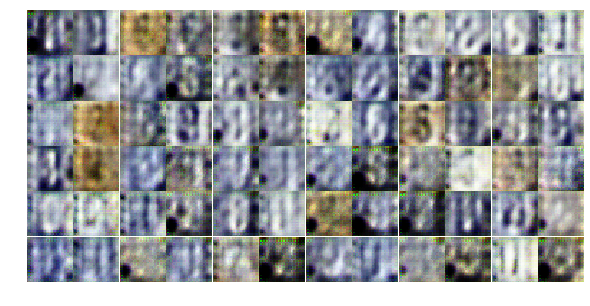

Epoch 2/25... Discriminator Loss: 0.0456... Generator Loss: 4.2093
Epoch 2/25... Discriminator Loss: 0.3541... Generator Loss: 1.9523
Epoch 2/25... Discriminator Loss: 0.1001... Generator Loss: 3.8289
Epoch 2/25... Discriminator Loss: 0.5302... Generator Loss: 4.2110
Epoch 2/25... Discriminator Loss: 0.8167... Generator Loss: 0.9926
Epoch 2/25... Discriminator Loss: 0.5744... Generator Loss: 1.4671
Epoch 2/25... Discriminator Loss: 0.6704... Generator Loss: 2.0716
Epoch 2/25... Discriminator Loss: 0.2865... Generator Loss: 3.7335
Epoch 2/25... Discriminator Loss: 0.1831... Generator Loss: 2.7561
Epoch 2/25... Discriminator Loss: 1.6890... Generator Loss: 0.2994


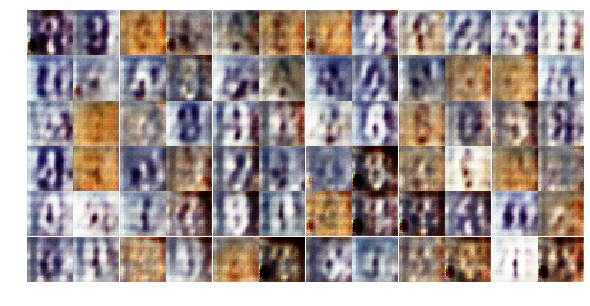

Epoch 2/25... Discriminator Loss: 0.3165... Generator Loss: 2.1961
Epoch 2/25... Discriminator Loss: 1.2935... Generator Loss: 1.4563
Epoch 2/25... Discriminator Loss: 0.4617... Generator Loss: 2.4337
Epoch 2/25... Discriminator Loss: 0.5661... Generator Loss: 3.9940
Epoch 2/25... Discriminator Loss: 0.6942... Generator Loss: 1.6057
Epoch 2/25... Discriminator Loss: 1.3677... Generator Loss: 0.5339
Epoch 2/25... Discriminator Loss: 0.3409... Generator Loss: 2.2475
Epoch 2/25... Discriminator Loss: 0.6805... Generator Loss: 0.9316
Epoch 2/25... Discriminator Loss: 1.0205... Generator Loss: 0.5806
Epoch 2/25... Discriminator Loss: 0.6707... Generator Loss: 2.3852


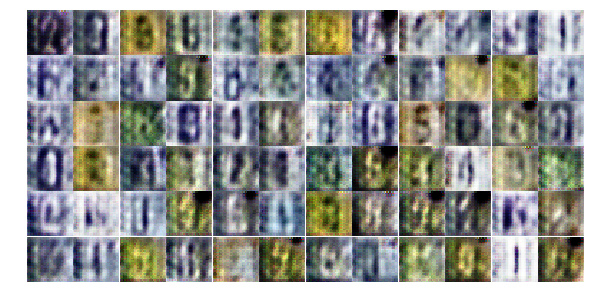

Epoch 2/25... Discriminator Loss: 0.6110... Generator Loss: 4.4813
Epoch 2/25... Discriminator Loss: 0.9246... Generator Loss: 0.8224
Epoch 2/25... Discriminator Loss: 0.4519... Generator Loss: 1.5031
Epoch 2/25... Discriminator Loss: 0.5272... Generator Loss: 1.4287
Epoch 3/25... Discriminator Loss: 0.2801... Generator Loss: 2.3017
Epoch 3/25... Discriminator Loss: 1.1846... Generator Loss: 0.4806
Epoch 3/25... Discriminator Loss: 1.0460... Generator Loss: 0.5832
Epoch 3/25... Discriminator Loss: 0.5967... Generator Loss: 1.8280
Epoch 3/25... Discriminator Loss: 0.1060... Generator Loss: 3.3943
Epoch 3/25... Discriminator Loss: 0.4914... Generator Loss: 1.3111


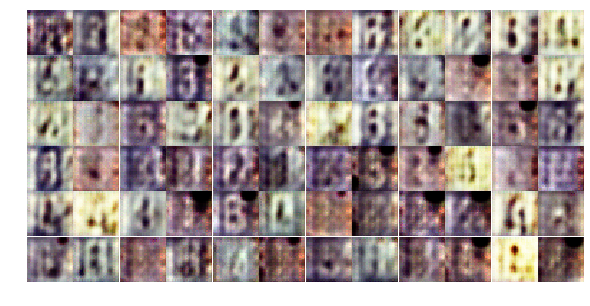

Epoch 3/25... Discriminator Loss: 1.5942... Generator Loss: 0.3995
Epoch 3/25... Discriminator Loss: 1.4275... Generator Loss: 0.3616
Epoch 3/25... Discriminator Loss: 0.6539... Generator Loss: 3.3913
Epoch 3/25... Discriminator Loss: 0.4895... Generator Loss: 1.6988
Epoch 3/25... Discriminator Loss: 0.8566... Generator Loss: 0.6731
Epoch 3/25... Discriminator Loss: 0.5347... Generator Loss: 1.6757
Epoch 3/25... Discriminator Loss: 0.3032... Generator Loss: 2.1752
Epoch 3/25... Discriminator Loss: 0.8908... Generator Loss: 2.0612
Epoch 3/25... Discriminator Loss: 0.6640... Generator Loss: 1.4003
Epoch 3/25... Discriminator Loss: 0.2785... Generator Loss: 1.6888


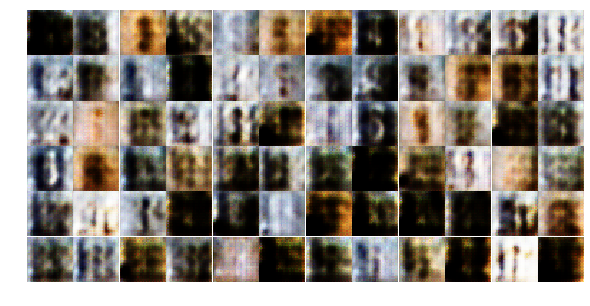

Epoch 3/25... Discriminator Loss: 0.5969... Generator Loss: 1.1657
Epoch 3/25... Discriminator Loss: 0.3165... Generator Loss: 2.6330
Epoch 3/25... Discriminator Loss: 1.2094... Generator Loss: 0.5014
Epoch 3/25... Discriminator Loss: 0.1588... Generator Loss: 3.7235
Epoch 3/25... Discriminator Loss: 1.0622... Generator Loss: 3.8789
Epoch 3/25... Discriminator Loss: 1.6156... Generator Loss: 0.3449
Epoch 3/25... Discriminator Loss: 0.9595... Generator Loss: 0.5737
Epoch 3/25... Discriminator Loss: 0.1319... Generator Loss: 3.5325
Epoch 3/25... Discriminator Loss: 0.4889... Generator Loss: 1.2752
Epoch 3/25... Discriminator Loss: 1.3297... Generator Loss: 0.4476


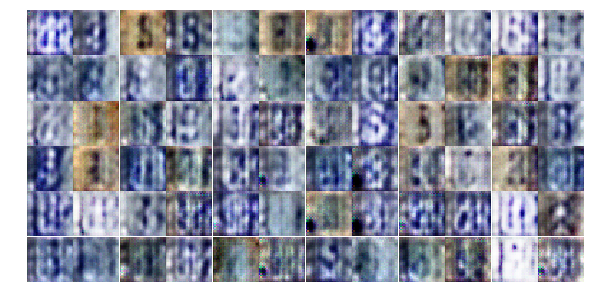

Epoch 3/25... Discriminator Loss: 0.5179... Generator Loss: 1.3912
Epoch 3/25... Discriminator Loss: 0.1046... Generator Loss: 3.3705
Epoch 3/25... Discriminator Loss: 0.5899... Generator Loss: 1.2389
Epoch 3/25... Discriminator Loss: 0.5530... Generator Loss: 1.2184
Epoch 3/25... Discriminator Loss: 0.3537... Generator Loss: 2.1188
Epoch 3/25... Discriminator Loss: 0.3184... Generator Loss: 3.3987
Epoch 3/25... Discriminator Loss: 0.4430... Generator Loss: 2.0440
Epoch 3/25... Discriminator Loss: 0.0683... Generator Loss: 3.2957
Epoch 3/25... Discriminator Loss: 0.9054... Generator Loss: 2.1314
Epoch 3/25... Discriminator Loss: 0.6413... Generator Loss: 3.3062


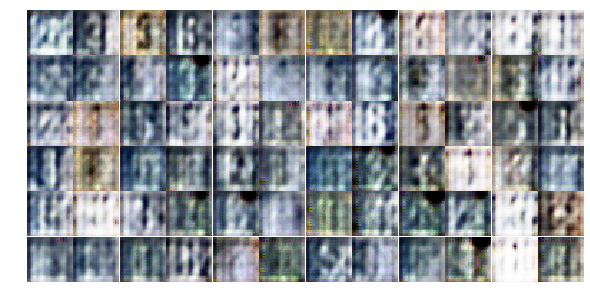

Epoch 3/25... Discriminator Loss: 1.8271... Generator Loss: 3.4435
Epoch 3/25... Discriminator Loss: 0.7852... Generator Loss: 0.8913
Epoch 3/25... Discriminator Loss: 0.1827... Generator Loss: 3.1225
Epoch 3/25... Discriminator Loss: 0.2237... Generator Loss: 2.2038
Epoch 3/25... Discriminator Loss: 0.9014... Generator Loss: 0.6753
Epoch 3/25... Discriminator Loss: 0.5157... Generator Loss: 3.3337
Epoch 3/25... Discriminator Loss: 0.7406... Generator Loss: 0.9136
Epoch 3/25... Discriminator Loss: 0.6029... Generator Loss: 2.0717
Epoch 3/25... Discriminator Loss: 0.4618... Generator Loss: 1.4474
Epoch 3/25... Discriminator Loss: 0.2696... Generator Loss: 2.2471


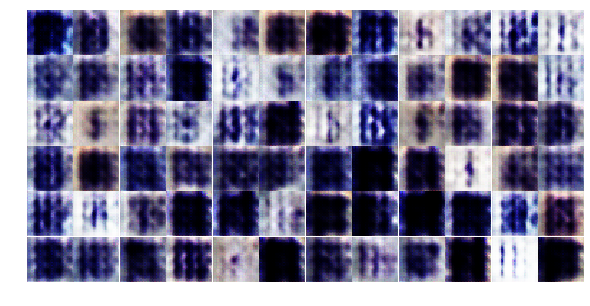

Epoch 3/25... Discriminator Loss: 0.4372... Generator Loss: 1.4162
Epoch 3/25... Discriminator Loss: 0.5480... Generator Loss: 1.4263
Epoch 3/25... Discriminator Loss: 0.1932... Generator Loss: 2.1496
Epoch 3/25... Discriminator Loss: 0.6701... Generator Loss: 0.9771
Epoch 3/25... Discriminator Loss: 0.0178... Generator Loss: 8.1995
Epoch 3/25... Discriminator Loss: 1.0033... Generator Loss: 4.5993
Epoch 3/25... Discriminator Loss: 0.0102... Generator Loss: 8.7264
Epoch 3/25... Discriminator Loss: 0.2966... Generator Loss: 1.8369
Epoch 3/25... Discriminator Loss: 0.0115... Generator Loss: 7.5942
Epoch 3/25... Discriminator Loss: 1.7798... Generator Loss: 1.9748


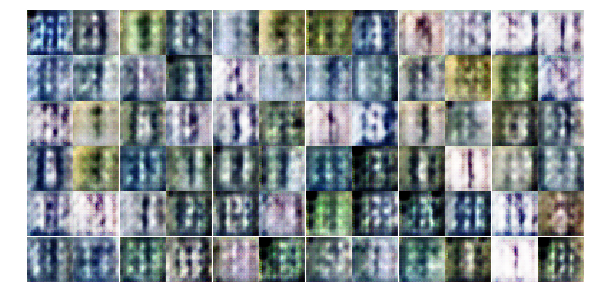

Epoch 3/25... Discriminator Loss: 1.5658... Generator Loss: 0.6724
Epoch 4/25... Discriminator Loss: 0.8111... Generator Loss: 1.1892
Epoch 4/25... Discriminator Loss: 0.0734... Generator Loss: 4.7326
Epoch 4/25... Discriminator Loss: 1.9339... Generator Loss: 0.2277
Epoch 4/25... Discriminator Loss: 0.9091... Generator Loss: 0.7767
Epoch 4/25... Discriminator Loss: 0.7753... Generator Loss: 0.9236
Epoch 4/25... Discriminator Loss: 0.1911... Generator Loss: 2.9234
Epoch 4/25... Discriminator Loss: 0.1952... Generator Loss: 3.2279
Epoch 4/25... Discriminator Loss: 0.5640... Generator Loss: 1.8603
Epoch 4/25... Discriminator Loss: 0.5398... Generator Loss: 1.6746


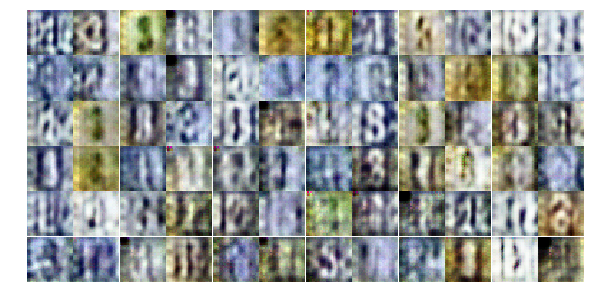

Epoch 4/25... Discriminator Loss: 0.5479... Generator Loss: 1.2262
Epoch 4/25... Discriminator Loss: 0.6304... Generator Loss: 1.0035
Epoch 4/25... Discriminator Loss: 1.1347... Generator Loss: 0.7819
Epoch 4/25... Discriminator Loss: 0.6359... Generator Loss: 1.7145
Epoch 4/25... Discriminator Loss: 0.3058... Generator Loss: 1.6581
Epoch 4/25... Discriminator Loss: 0.5115... Generator Loss: 2.0894
Epoch 4/25... Discriminator Loss: 0.6572... Generator Loss: 2.0893
Epoch 4/25... Discriminator Loss: 0.8225... Generator Loss: 2.4247
Epoch 4/25... Discriminator Loss: 0.3899... Generator Loss: 1.8225
Epoch 4/25... Discriminator Loss: 0.5460... Generator Loss: 1.4610


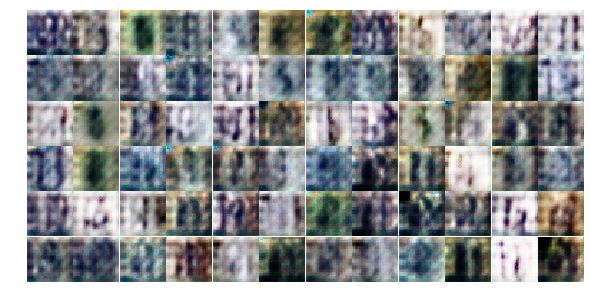

Epoch 4/25... Discriminator Loss: 1.0612... Generator Loss: 1.4289
Epoch 4/25... Discriminator Loss: 1.2697... Generator Loss: 0.4319
Epoch 4/25... Discriminator Loss: 1.5448... Generator Loss: 0.3308
Epoch 4/25... Discriminator Loss: 0.5672... Generator Loss: 1.9640
Epoch 4/25... Discriminator Loss: 0.8874... Generator Loss: 1.0466
Epoch 4/25... Discriminator Loss: 1.1453... Generator Loss: 3.9811
Epoch 4/25... Discriminator Loss: 2.3650... Generator Loss: 0.1320
Epoch 4/25... Discriminator Loss: 0.2404... Generator Loss: 2.6879
Epoch 4/25... Discriminator Loss: 0.9056... Generator Loss: 0.7051
Epoch 4/25... Discriminator Loss: 1.6557... Generator Loss: 0.3554


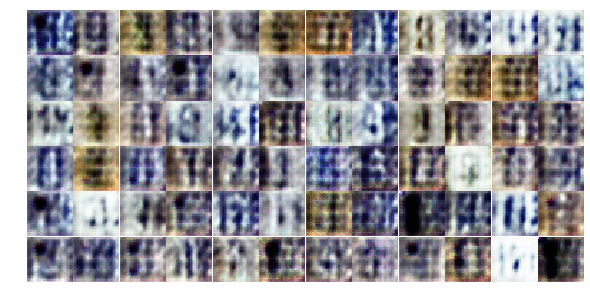

Epoch 4/25... Discriminator Loss: 0.0920... Generator Loss: 3.0545
Epoch 4/25... Discriminator Loss: 0.2495... Generator Loss: 2.6540
Epoch 4/25... Discriminator Loss: 1.1793... Generator Loss: 0.5249
Epoch 4/25... Discriminator Loss: 0.3790... Generator Loss: 3.3474
Epoch 4/25... Discriminator Loss: 0.6405... Generator Loss: 2.1385
Epoch 4/25... Discriminator Loss: 1.5513... Generator Loss: 0.7412
Epoch 4/25... Discriminator Loss: 0.9587... Generator Loss: 0.6622
Epoch 4/25... Discriminator Loss: 0.0472... Generator Loss: 5.0603
Epoch 4/25... Discriminator Loss: 0.0516... Generator Loss: 4.8553
Epoch 4/25... Discriminator Loss: 2.4382... Generator Loss: 0.1664


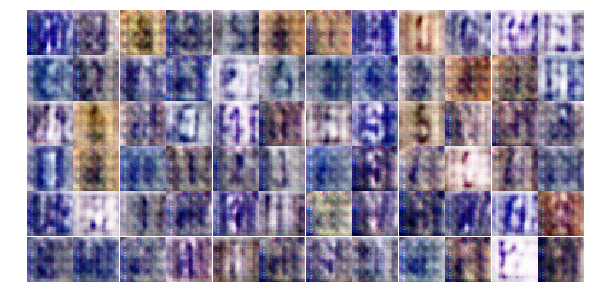

Epoch 4/25... Discriminator Loss: 0.1986... Generator Loss: 3.2093
Epoch 4/25... Discriminator Loss: 1.2025... Generator Loss: 0.6493
Epoch 4/25... Discriminator Loss: 0.3040... Generator Loss: 4.0302
Epoch 4/25... Discriminator Loss: 0.6400... Generator Loss: 3.5895
Epoch 4/25... Discriminator Loss: 0.0313... Generator Loss: 5.0819
Epoch 4/25... Discriminator Loss: 0.6602... Generator Loss: 0.9535
Epoch 4/25... Discriminator Loss: 0.2045... Generator Loss: 2.2678
Epoch 4/25... Discriminator Loss: 0.7367... Generator Loss: 1.2197
Epoch 4/25... Discriminator Loss: 0.6757... Generator Loss: 1.4643
Epoch 4/25... Discriminator Loss: 0.1204... Generator Loss: 5.0684


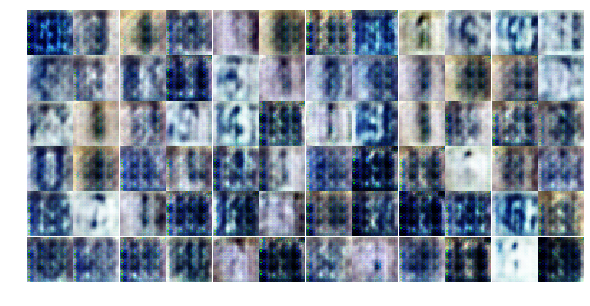

Epoch 4/25... Discriminator Loss: 0.3718... Generator Loss: 1.3955
Epoch 4/25... Discriminator Loss: 1.7063... Generator Loss: 4.4415
Epoch 4/25... Discriminator Loss: 0.2810... Generator Loss: 1.7093
Epoch 4/25... Discriminator Loss: 0.5001... Generator Loss: 1.7854
Epoch 4/25... Discriminator Loss: 0.7264... Generator Loss: 1.6430
Epoch 4/25... Discriminator Loss: 0.0083... Generator Loss: 8.5091
Epoch 4/25... Discriminator Loss: 0.2217... Generator Loss: 2.1152
Epoch 4/25... Discriminator Loss: 1.5658... Generator Loss: 0.2987
Epoch 4/25... Discriminator Loss: 2.9322... Generator Loss: 0.1078
Epoch 5/25... Discriminator Loss: 0.2774... Generator Loss: 3.1160


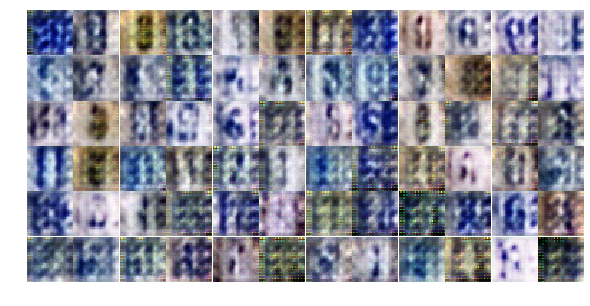

Epoch 5/25... Discriminator Loss: 0.3628... Generator Loss: 2.6818
Epoch 5/25... Discriminator Loss: 0.0351... Generator Loss: 9.0847
Epoch 5/25... Discriminator Loss: 0.2777... Generator Loss: 1.7669
Epoch 5/25... Discriminator Loss: 1.5786... Generator Loss: 3.4583
Epoch 5/25... Discriminator Loss: 1.4652... Generator Loss: 0.9687
Epoch 5/25... Discriminator Loss: 0.8059... Generator Loss: 1.5416
Epoch 5/25... Discriminator Loss: 1.6659... Generator Loss: 0.3028
Epoch 5/25... Discriminator Loss: 0.5461... Generator Loss: 1.5126
Epoch 5/25... Discriminator Loss: 0.7334... Generator Loss: 0.9317
Epoch 5/25... Discriminator Loss: 0.3188... Generator Loss: 1.6764


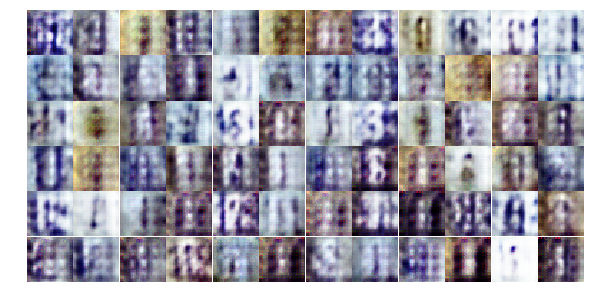

Epoch 5/25... Discriminator Loss: 1.3615... Generator Loss: 0.4326
Epoch 5/25... Discriminator Loss: 0.1163... Generator Loss: 3.2181
Epoch 5/25... Discriminator Loss: 0.3646... Generator Loss: 1.6092
Epoch 5/25... Discriminator Loss: 0.5592... Generator Loss: 1.1555
Epoch 5/25... Discriminator Loss: 0.5428... Generator Loss: 1.2332
Epoch 5/25... Discriminator Loss: 0.9685... Generator Loss: 0.8190
Epoch 5/25... Discriminator Loss: 0.1597... Generator Loss: 2.2255
Epoch 5/25... Discriminator Loss: 1.8040... Generator Loss: 2.2809
Epoch 5/25... Discriminator Loss: 0.1071... Generator Loss: 8.4061
Epoch 5/25... Discriminator Loss: 0.2023... Generator Loss: 2.3820


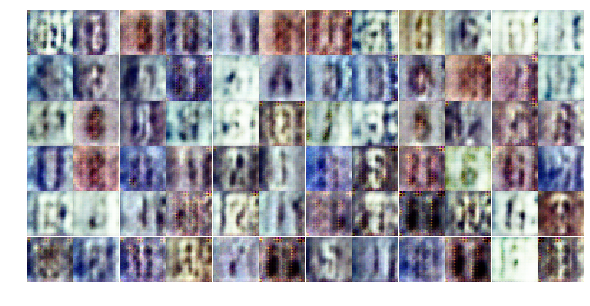

Epoch 5/25... Discriminator Loss: 0.4805... Generator Loss: 1.3094
Epoch 5/25... Discriminator Loss: 1.1359... Generator Loss: 0.7202
Epoch 5/25... Discriminator Loss: 0.1043... Generator Loss: 2.7610
Epoch 5/25... Discriminator Loss: 0.1415... Generator Loss: 2.9736
Epoch 5/25... Discriminator Loss: 1.4105... Generator Loss: 0.3719
Epoch 5/25... Discriminator Loss: 0.7491... Generator Loss: 0.8891
Epoch 5/25... Discriminator Loss: 1.1177... Generator Loss: 0.5419
Epoch 5/25... Discriminator Loss: 0.8685... Generator Loss: 1.8086
Epoch 5/25... Discriminator Loss: 0.7641... Generator Loss: 1.1372
Epoch 5/25... Discriminator Loss: 2.4379... Generator Loss: 3.3834


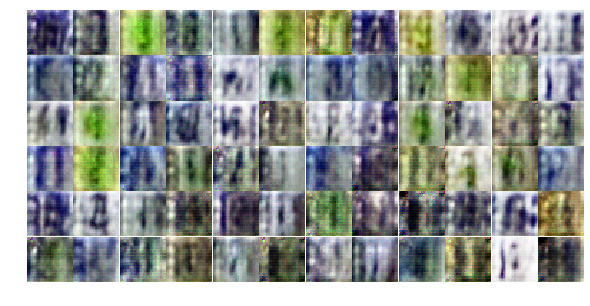

Epoch 5/25... Discriminator Loss: 0.4571... Generator Loss: 1.2699
Epoch 5/25... Discriminator Loss: 0.3251... Generator Loss: 1.6469
Epoch 5/25... Discriminator Loss: 0.4049... Generator Loss: 2.2328
Epoch 5/25... Discriminator Loss: 0.4484... Generator Loss: 1.7479
Epoch 5/25... Discriminator Loss: 1.9469... Generator Loss: 0.3685
Epoch 5/25... Discriminator Loss: 0.5006... Generator Loss: 1.3931
Epoch 5/25... Discriminator Loss: 0.7488... Generator Loss: 0.9073
Epoch 5/25... Discriminator Loss: 0.6384... Generator Loss: 1.1642
Epoch 5/25... Discriminator Loss: 0.2303... Generator Loss: 3.6165
Epoch 5/25... Discriminator Loss: 1.0972... Generator Loss: 0.4936


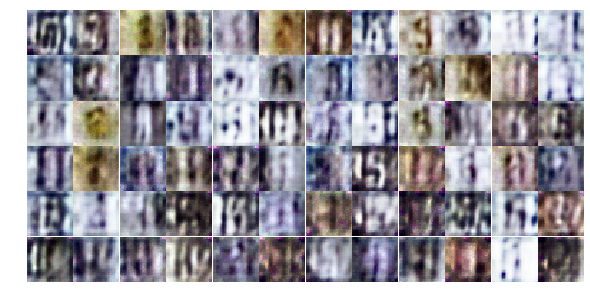

Epoch 5/25... Discriminator Loss: 0.7234... Generator Loss: 1.5308
Epoch 5/25... Discriminator Loss: 0.7787... Generator Loss: 0.7765
Epoch 5/25... Discriminator Loss: 0.4643... Generator Loss: 1.2836
Epoch 5/25... Discriminator Loss: 0.5974... Generator Loss: 1.6056
Epoch 5/25... Discriminator Loss: 1.8461... Generator Loss: 0.2555
Epoch 5/25... Discriminator Loss: 0.7349... Generator Loss: 1.5596
Epoch 5/25... Discriminator Loss: 0.4841... Generator Loss: 1.5432
Epoch 5/25... Discriminator Loss: 0.4886... Generator Loss: 1.7311
Epoch 5/25... Discriminator Loss: 0.2348... Generator Loss: 2.7777
Epoch 5/25... Discriminator Loss: 0.5924... Generator Loss: 1.1039


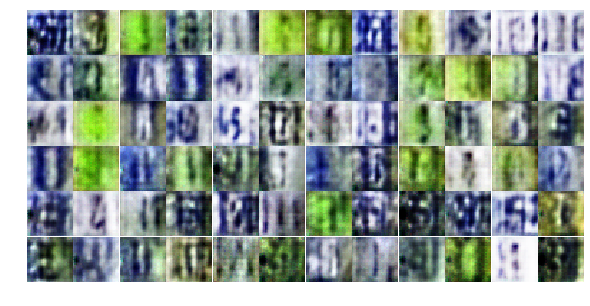

Epoch 5/25... Discriminator Loss: 0.1235... Generator Loss: 8.8929
Epoch 5/25... Discriminator Loss: 0.8112... Generator Loss: 1.3180
Epoch 5/25... Discriminator Loss: 1.0728... Generator Loss: 1.0668
Epoch 5/25... Discriminator Loss: 1.1726... Generator Loss: 0.6047
Epoch 5/25... Discriminator Loss: 0.7610... Generator Loss: 0.9352
Epoch 5/25... Discriminator Loss: 1.7489... Generator Loss: 0.2471
Epoch 6/25... Discriminator Loss: 0.6335... Generator Loss: 1.7574
Epoch 6/25... Discriminator Loss: 0.2933... Generator Loss: 2.4263
Epoch 6/25... Discriminator Loss: 0.2950... Generator Loss: 2.0848
Epoch 6/25... Discriminator Loss: 0.0812... Generator Loss: 5.2654


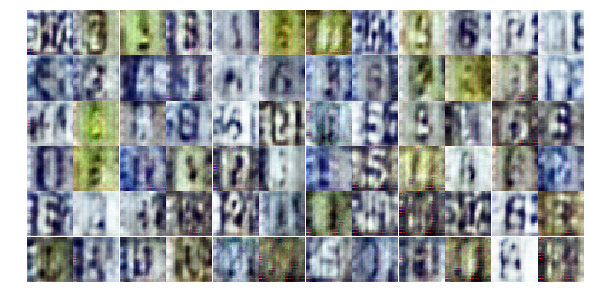

Epoch 6/25... Discriminator Loss: 0.1950... Generator Loss: 3.1470
Epoch 6/25... Discriminator Loss: 0.6499... Generator Loss: 1.0683
Epoch 6/25... Discriminator Loss: 1.6077... Generator Loss: 0.7100
Epoch 6/25... Discriminator Loss: 0.8907... Generator Loss: 1.3377
Epoch 6/25... Discriminator Loss: 0.7417... Generator Loss: 0.8251
Epoch 6/25... Discriminator Loss: 0.9195... Generator Loss: 2.4461
Epoch 6/25... Discriminator Loss: 1.6344... Generator Loss: 1.2696
Epoch 6/25... Discriminator Loss: 0.7093... Generator Loss: 1.1819
Epoch 6/25... Discriminator Loss: 0.9303... Generator Loss: 0.9499
Epoch 6/25... Discriminator Loss: 0.7072... Generator Loss: 1.1676


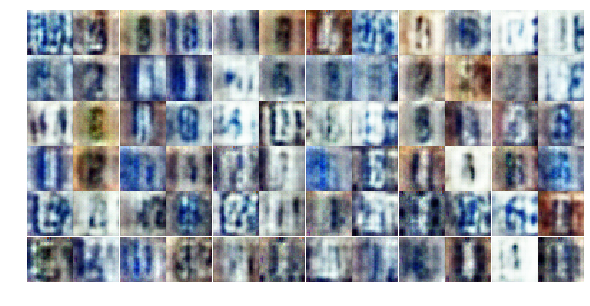

Epoch 6/25... Discriminator Loss: 1.2647... Generator Loss: 0.8482
Epoch 6/25... Discriminator Loss: 1.4402... Generator Loss: 0.4139
Epoch 6/25... Discriminator Loss: 1.5707... Generator Loss: 0.4997
Epoch 6/25... Discriminator Loss: 0.8418... Generator Loss: 1.4691
Epoch 6/25... Discriminator Loss: 0.9906... Generator Loss: 0.8219
Epoch 6/25... Discriminator Loss: 0.7056... Generator Loss: 1.2173
Epoch 6/25... Discriminator Loss: 0.6308... Generator Loss: 1.4783
Epoch 6/25... Discriminator Loss: 0.4309... Generator Loss: 3.3370
Epoch 6/25... Discriminator Loss: 0.3425... Generator Loss: 1.7337
Epoch 6/25... Discriminator Loss: 0.9071... Generator Loss: 0.8960


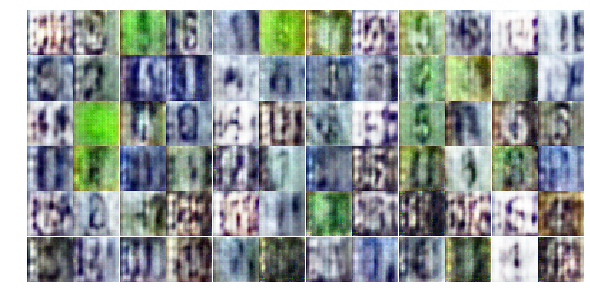

Epoch 6/25... Discriminator Loss: 0.5928... Generator Loss: 1.1302
Epoch 6/25... Discriminator Loss: 0.9719... Generator Loss: 0.7662
Epoch 6/25... Discriminator Loss: 0.6066... Generator Loss: 2.2357
Epoch 6/25... Discriminator Loss: 1.4405... Generator Loss: 1.8731
Epoch 6/25... Discriminator Loss: 1.3007... Generator Loss: 0.7963
Epoch 6/25... Discriminator Loss: 1.6014... Generator Loss: 0.3710
Epoch 6/25... Discriminator Loss: 0.9202... Generator Loss: 0.8646
Epoch 6/25... Discriminator Loss: 1.2135... Generator Loss: 0.8112
Epoch 6/25... Discriminator Loss: 1.0707... Generator Loss: 0.6739
Epoch 6/25... Discriminator Loss: 1.2848... Generator Loss: 1.0321


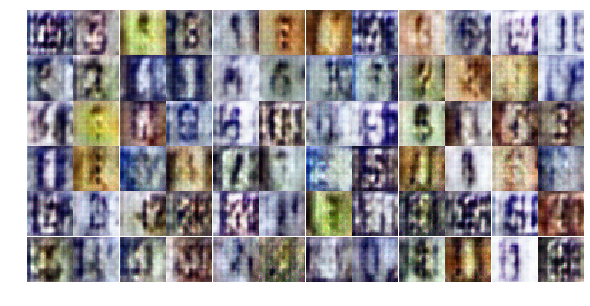

Epoch 6/25... Discriminator Loss: 1.4036... Generator Loss: 0.4533
Epoch 6/25... Discriminator Loss: 1.1736... Generator Loss: 0.8752
Epoch 6/25... Discriminator Loss: 0.9223... Generator Loss: 1.4372
Epoch 6/25... Discriminator Loss: 0.8875... Generator Loss: 1.1940
Epoch 6/25... Discriminator Loss: 1.3773... Generator Loss: 0.5068
Epoch 6/25... Discriminator Loss: 0.9568... Generator Loss: 1.9426
Epoch 6/25... Discriminator Loss: 0.6079... Generator Loss: 1.6948
Epoch 6/25... Discriminator Loss: 1.0313... Generator Loss: 1.5759
Epoch 6/25... Discriminator Loss: 1.4515... Generator Loss: 1.2318
Epoch 6/25... Discriminator Loss: 0.9258... Generator Loss: 1.0607


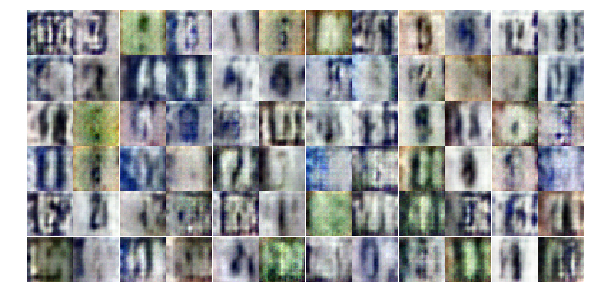

Epoch 6/25... Discriminator Loss: 0.3707... Generator Loss: 2.2934
Epoch 6/25... Discriminator Loss: 1.0752... Generator Loss: 1.4866
Epoch 6/25... Discriminator Loss: 1.2433... Generator Loss: 0.8520
Epoch 6/25... Discriminator Loss: 1.2908... Generator Loss: 0.6695
Epoch 6/25... Discriminator Loss: 0.8388... Generator Loss: 1.2133
Epoch 6/25... Discriminator Loss: 1.0470... Generator Loss: 1.2934
Epoch 6/25... Discriminator Loss: 1.2049... Generator Loss: 0.6873
Epoch 6/25... Discriminator Loss: 0.9002... Generator Loss: 1.0461
Epoch 6/25... Discriminator Loss: 0.9807... Generator Loss: 1.2533
Epoch 6/25... Discriminator Loss: 1.1773... Generator Loss: 0.5548


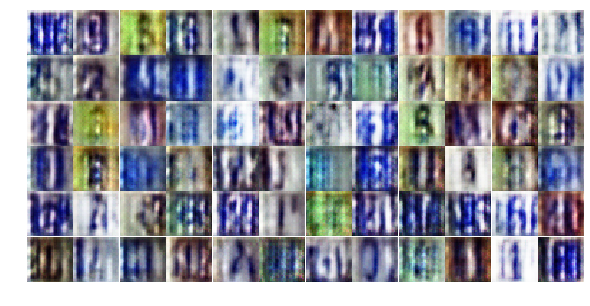

Epoch 6/25... Discriminator Loss: 1.0777... Generator Loss: 0.8588
Epoch 6/25... Discriminator Loss: 0.5239... Generator Loss: 1.8248
Epoch 6/25... Discriminator Loss: 1.3071... Generator Loss: 0.8232
Epoch 7/25... Discriminator Loss: 1.6076... Generator Loss: 0.4096
Epoch 7/25... Discriminator Loss: 1.3048... Generator Loss: 0.6403
Epoch 7/25... Discriminator Loss: 0.6570... Generator Loss: 1.0293
Epoch 7/25... Discriminator Loss: 1.0034... Generator Loss: 0.7899
Epoch 7/25... Discriminator Loss: 1.0206... Generator Loss: 1.6853
Epoch 7/25... Discriminator Loss: 1.2934... Generator Loss: 0.5402
Epoch 7/25... Discriminator Loss: 1.3360... Generator Loss: 1.3930


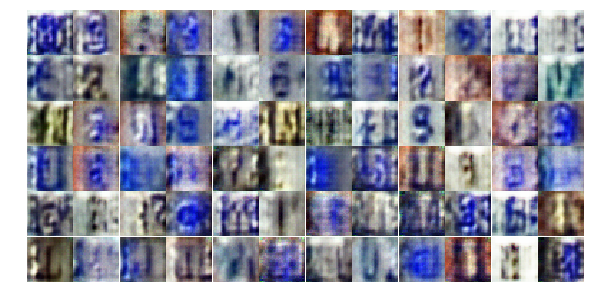

Epoch 7/25... Discriminator Loss: 2.3492... Generator Loss: 0.1381
Epoch 7/25... Discriminator Loss: 0.9880... Generator Loss: 0.7570
Epoch 7/25... Discriminator Loss: 0.9748... Generator Loss: 1.2591
Epoch 7/25... Discriminator Loss: 1.1626... Generator Loss: 0.8396
Epoch 7/25... Discriminator Loss: 0.9064... Generator Loss: 1.1201
Epoch 7/25... Discriminator Loss: 1.2777... Generator Loss: 0.4769
Epoch 7/25... Discriminator Loss: 2.8505... Generator Loss: 0.0903
Epoch 7/25... Discriminator Loss: 1.5619... Generator Loss: 0.6205
Epoch 7/25... Discriminator Loss: 0.7953... Generator Loss: 1.2061
Epoch 7/25... Discriminator Loss: 1.3829... Generator Loss: 1.0284


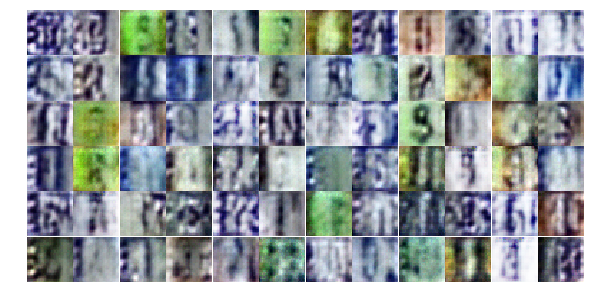

Epoch 7/25... Discriminator Loss: 0.4242... Generator Loss: 1.9195
Epoch 7/25... Discriminator Loss: 2.6931... Generator Loss: 2.5482
Epoch 7/25... Discriminator Loss: 0.7374... Generator Loss: 0.9595
Epoch 7/25... Discriminator Loss: 0.7841... Generator Loss: 2.1252
Epoch 7/25... Discriminator Loss: 0.7270... Generator Loss: 1.3493
Epoch 7/25... Discriminator Loss: 1.1949... Generator Loss: 0.4953
Epoch 7/25... Discriminator Loss: 0.6087... Generator Loss: 1.2418
Epoch 7/25... Discriminator Loss: 0.8744... Generator Loss: 0.7236
Epoch 7/25... Discriminator Loss: 1.0266... Generator Loss: 0.5611
Epoch 7/25... Discriminator Loss: 0.6642... Generator Loss: 1.3162


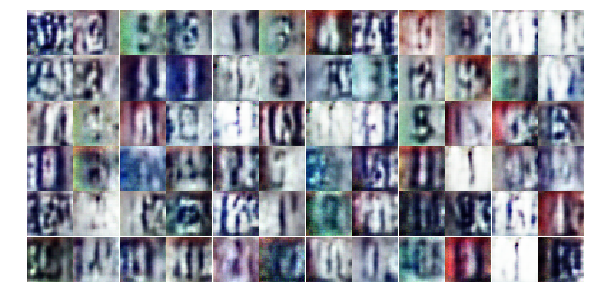

Epoch 7/25... Discriminator Loss: 1.0576... Generator Loss: 0.6700
Epoch 7/25... Discriminator Loss: 1.0583... Generator Loss: 0.6860
Epoch 7/25... Discriminator Loss: 0.2235... Generator Loss: 2.5863
Epoch 7/25... Discriminator Loss: 0.3246... Generator Loss: 2.0189
Epoch 7/25... Discriminator Loss: 1.2413... Generator Loss: 0.5692
Epoch 7/25... Discriminator Loss: 0.9934... Generator Loss: 0.6172
Epoch 7/25... Discriminator Loss: 0.8916... Generator Loss: 0.7719
Epoch 7/25... Discriminator Loss: 1.1044... Generator Loss: 1.0281
Epoch 7/25... Discriminator Loss: 1.0227... Generator Loss: 0.9313
Epoch 7/25... Discriminator Loss: 1.1772... Generator Loss: 0.5131


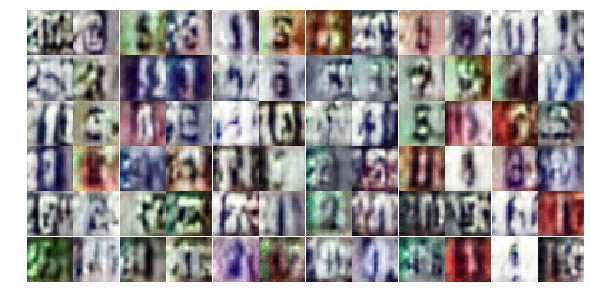

Epoch 7/25... Discriminator Loss: 1.7991... Generator Loss: 1.4092
Epoch 7/25... Discriminator Loss: 1.2380... Generator Loss: 0.5774
Epoch 7/25... Discriminator Loss: 0.9860... Generator Loss: 1.7534
Epoch 7/25... Discriminator Loss: 1.1252... Generator Loss: 1.3971
Epoch 7/25... Discriminator Loss: 1.1229... Generator Loss: 0.6591
Epoch 7/25... Discriminator Loss: 0.8202... Generator Loss: 0.9368
Epoch 7/25... Discriminator Loss: 0.9542... Generator Loss: 1.0475
Epoch 7/25... Discriminator Loss: 1.5115... Generator Loss: 0.8168
Epoch 7/25... Discriminator Loss: 1.1867... Generator Loss: 1.9049
Epoch 7/25... Discriminator Loss: 0.8853... Generator Loss: 1.6276


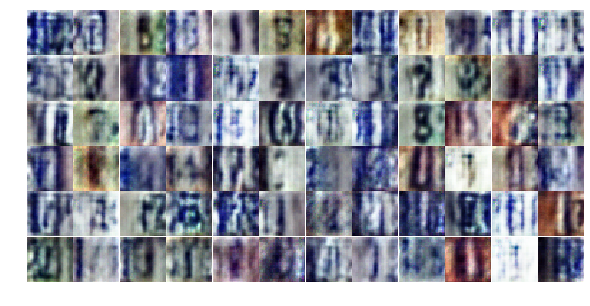

Epoch 7/25... Discriminator Loss: 1.2510... Generator Loss: 0.5212
Epoch 7/25... Discriminator Loss: 1.1562... Generator Loss: 0.5858
Epoch 7/25... Discriminator Loss: 1.1577... Generator Loss: 0.6028
Epoch 7/25... Discriminator Loss: 1.3029... Generator Loss: 0.5290
Epoch 7/25... Discriminator Loss: 0.9554... Generator Loss: 0.9516
Epoch 7/25... Discriminator Loss: 0.8087... Generator Loss: 1.1022
Epoch 7/25... Discriminator Loss: 1.1323... Generator Loss: 2.2319
Epoch 7/25... Discriminator Loss: 1.1880... Generator Loss: 0.5833
Epoch 7/25... Discriminator Loss: 0.8644... Generator Loss: 1.0824
Epoch 7/25... Discriminator Loss: 0.5809... Generator Loss: 1.1576


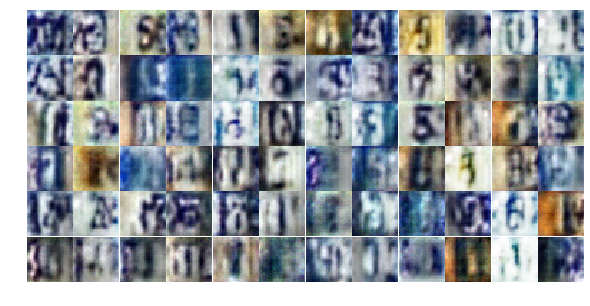

Epoch 7/25... Discriminator Loss: 1.2321... Generator Loss: 0.4559
Epoch 8/25... Discriminator Loss: 1.1364... Generator Loss: 0.6132
Epoch 8/25... Discriminator Loss: 0.6789... Generator Loss: 1.8792
Epoch 8/25... Discriminator Loss: 1.6899... Generator Loss: 0.2748
Epoch 8/25... Discriminator Loss: 0.3532... Generator Loss: 2.1296
Epoch 8/25... Discriminator Loss: 0.8434... Generator Loss: 0.8649
Epoch 8/25... Discriminator Loss: 0.9691... Generator Loss: 0.7946
Epoch 8/25... Discriminator Loss: 1.0673... Generator Loss: 0.7105
Epoch 8/25... Discriminator Loss: 1.2162... Generator Loss: 0.8485
Epoch 8/25... Discriminator Loss: 0.6363... Generator Loss: 1.0829


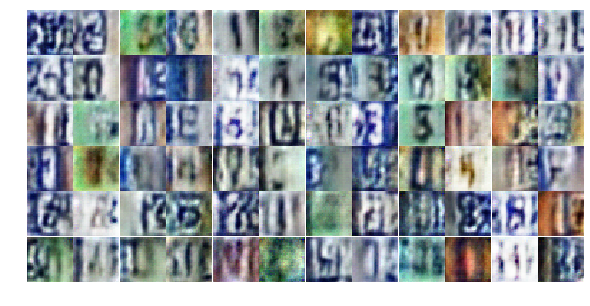

Epoch 8/25... Discriminator Loss: 0.8234... Generator Loss: 0.7984
Epoch 8/25... Discriminator Loss: 0.7806... Generator Loss: 1.2175
Epoch 8/25... Discriminator Loss: 0.8975... Generator Loss: 1.8496
Epoch 8/25... Discriminator Loss: 0.4067... Generator Loss: 1.5772
Epoch 8/25... Discriminator Loss: 0.1835... Generator Loss: 3.1654
Epoch 8/25... Discriminator Loss: 1.4215... Generator Loss: 3.1271
Epoch 8/25... Discriminator Loss: 1.3642... Generator Loss: 0.4006
Epoch 8/25... Discriminator Loss: 0.3532... Generator Loss: 2.5693
Epoch 8/25... Discriminator Loss: 0.6641... Generator Loss: 1.5771
Epoch 8/25... Discriminator Loss: 0.9664... Generator Loss: 3.8240


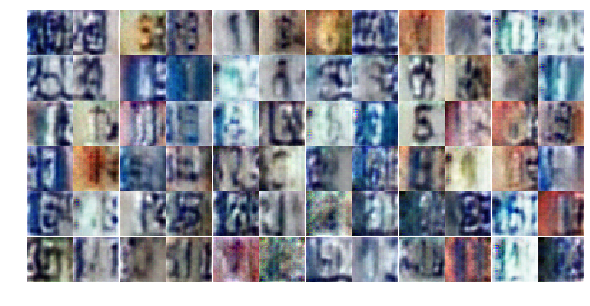

Epoch 8/25... Discriminator Loss: 0.9794... Generator Loss: 1.1857
Epoch 8/25... Discriminator Loss: 0.6488... Generator Loss: 1.4210
Epoch 8/25... Discriminator Loss: 0.3679... Generator Loss: 3.8910
Epoch 8/25... Discriminator Loss: 0.8169... Generator Loss: 1.0965
Epoch 8/25... Discriminator Loss: 0.5991... Generator Loss: 2.5566
Epoch 8/25... Discriminator Loss: 1.4364... Generator Loss: 2.0224
Epoch 8/25... Discriminator Loss: 0.9338... Generator Loss: 1.0509
Epoch 8/25... Discriminator Loss: 0.6862... Generator Loss: 3.7311
Epoch 8/25... Discriminator Loss: 3.3767... Generator Loss: 0.0477
Epoch 8/25... Discriminator Loss: 1.0672... Generator Loss: 0.5875


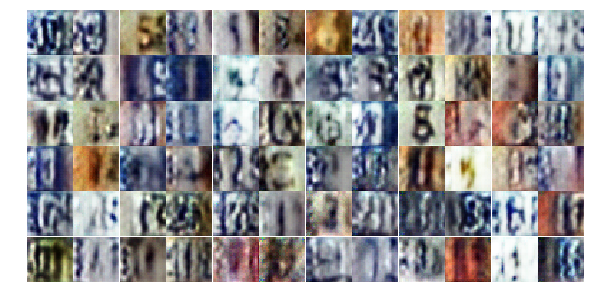

Epoch 8/25... Discriminator Loss: 0.9752... Generator Loss: 0.9296
Epoch 8/25... Discriminator Loss: 1.1740... Generator Loss: 0.9248
Epoch 8/25... Discriminator Loss: 1.1154... Generator Loss: 0.7019
Epoch 8/25... Discriminator Loss: 0.5197... Generator Loss: 1.4256
Epoch 8/25... Discriminator Loss: 0.6888... Generator Loss: 2.0194
Epoch 8/25... Discriminator Loss: 0.5190... Generator Loss: 2.1688
Epoch 8/25... Discriminator Loss: 0.6989... Generator Loss: 1.7823
Epoch 8/25... Discriminator Loss: 0.4961... Generator Loss: 1.3817
Epoch 8/25... Discriminator Loss: 0.6461... Generator Loss: 1.0174
Epoch 8/25... Discriminator Loss: 0.8127... Generator Loss: 1.2374


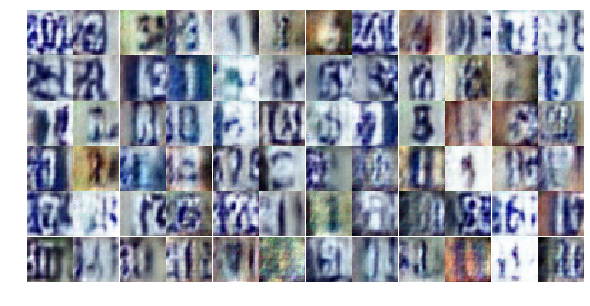

Epoch 8/25... Discriminator Loss: 0.6843... Generator Loss: 1.8835
Epoch 8/25... Discriminator Loss: 0.5326... Generator Loss: 2.0515
Epoch 8/25... Discriminator Loss: 0.8460... Generator Loss: 2.2306
Epoch 8/25... Discriminator Loss: 0.8236... Generator Loss: 1.3069
Epoch 8/25... Discriminator Loss: 1.7455... Generator Loss: 0.3472
Epoch 8/25... Discriminator Loss: 0.5184... Generator Loss: 1.8950
Epoch 8/25... Discriminator Loss: 0.3602... Generator Loss: 2.5557
Epoch 8/25... Discriminator Loss: 0.2924... Generator Loss: 2.7376
Epoch 8/25... Discriminator Loss: 0.5587... Generator Loss: 2.0590
Epoch 8/25... Discriminator Loss: 0.6266... Generator Loss: 1.7204


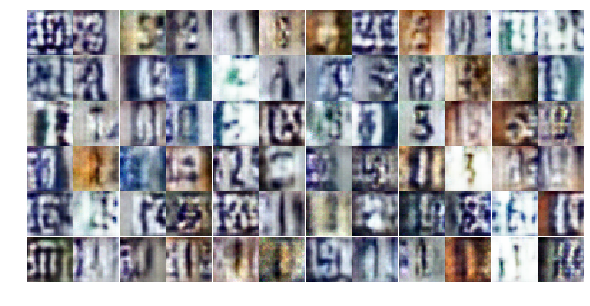

Epoch 8/25... Discriminator Loss: 0.7861... Generator Loss: 0.7403
Epoch 8/25... Discriminator Loss: 0.9112... Generator Loss: 0.7776
Epoch 8/25... Discriminator Loss: 0.3550... Generator Loss: 2.9197
Epoch 8/25... Discriminator Loss: 0.5970... Generator Loss: 1.2555
Epoch 8/25... Discriminator Loss: 0.1091... Generator Loss: 4.3155
Epoch 8/25... Discriminator Loss: 1.5624... Generator Loss: 2.5285
Epoch 8/25... Discriminator Loss: 0.9530... Generator Loss: 2.1886
Epoch 8/25... Discriminator Loss: 0.2040... Generator Loss: 2.8986
Epoch 9/25... Discriminator Loss: 0.8765... Generator Loss: 0.8685
Epoch 9/25... Discriminator Loss: 0.3800... Generator Loss: 1.9706


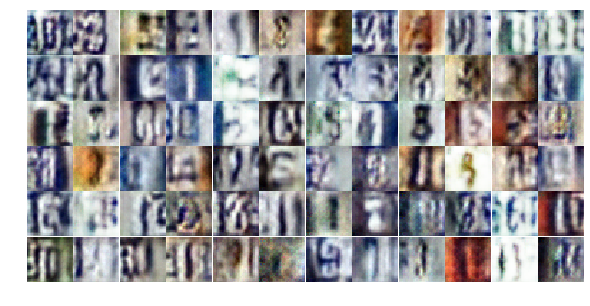

Epoch 9/25... Discriminator Loss: 0.2222... Generator Loss: 2.4430
Epoch 9/25... Discriminator Loss: 0.7022... Generator Loss: 1.2298
Epoch 9/25... Discriminator Loss: 0.1724... Generator Loss: 2.9324
Epoch 9/25... Discriminator Loss: 1.3265... Generator Loss: 0.4432
Epoch 9/25... Discriminator Loss: 0.4623... Generator Loss: 2.2287
Epoch 9/25... Discriminator Loss: 0.3032... Generator Loss: 2.1598
Epoch 9/25... Discriminator Loss: 1.1756... Generator Loss: 1.6993
Epoch 9/25... Discriminator Loss: 0.0959... Generator Loss: 2.9524
Epoch 9/25... Discriminator Loss: 0.9567... Generator Loss: 0.9033
Epoch 9/25... Discriminator Loss: 0.6084... Generator Loss: 1.8869


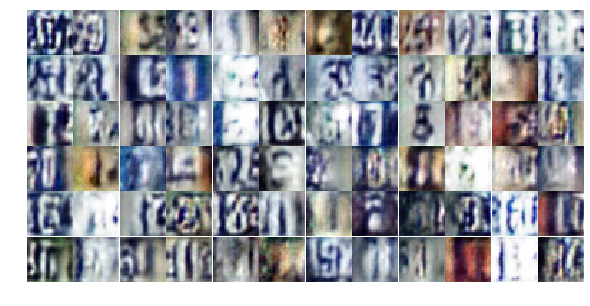

Epoch 9/25... Discriminator Loss: 0.9818... Generator Loss: 1.6057
Epoch 9/25... Discriminator Loss: 1.6625... Generator Loss: 0.3127
Epoch 9/25... Discriminator Loss: 1.5069... Generator Loss: 0.4243
Epoch 9/25... Discriminator Loss: 0.7827... Generator Loss: 1.4643
Epoch 9/25... Discriminator Loss: 1.4135... Generator Loss: 0.3729
Epoch 9/25... Discriminator Loss: 0.9879... Generator Loss: 0.6858
Epoch 9/25... Discriminator Loss: 1.9017... Generator Loss: 2.3160
Epoch 9/25... Discriminator Loss: 0.9154... Generator Loss: 1.2739
Epoch 9/25... Discriminator Loss: 0.3261... Generator Loss: 1.7777
Epoch 9/25... Discriminator Loss: 0.6161... Generator Loss: 1.4836


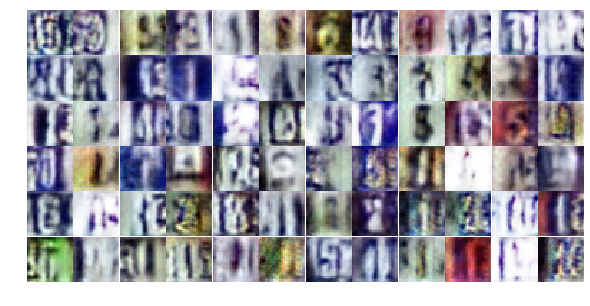

Epoch 9/25... Discriminator Loss: 1.2603... Generator Loss: 2.2729
Epoch 9/25... Discriminator Loss: 1.2813... Generator Loss: 1.8814
Epoch 9/25... Discriminator Loss: 1.0152... Generator Loss: 0.7784
Epoch 9/25... Discriminator Loss: 0.7267... Generator Loss: 1.3287
Epoch 9/25... Discriminator Loss: 0.6054... Generator Loss: 1.1393
Epoch 9/25... Discriminator Loss: 0.3137... Generator Loss: 2.2912
Epoch 9/25... Discriminator Loss: 1.4669... Generator Loss: 1.4851
Epoch 9/25... Discriminator Loss: 0.8060... Generator Loss: 2.0685
Epoch 9/25... Discriminator Loss: 0.6190... Generator Loss: 1.3002
Epoch 9/25... Discriminator Loss: 0.3423... Generator Loss: 1.8492


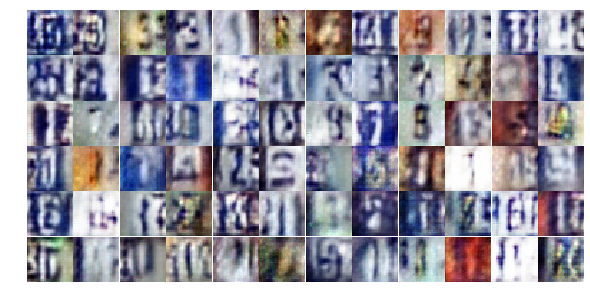

Epoch 9/25... Discriminator Loss: 0.9825... Generator Loss: 1.1897
Epoch 9/25... Discriminator Loss: 0.7033... Generator Loss: 1.1392
Epoch 9/25... Discriminator Loss: 1.2257... Generator Loss: 0.4452
Epoch 9/25... Discriminator Loss: 0.8247... Generator Loss: 0.7320
Epoch 9/25... Discriminator Loss: 0.9536... Generator Loss: 1.3467
Epoch 9/25... Discriminator Loss: 0.8941... Generator Loss: 0.7976
Epoch 9/25... Discriminator Loss: 0.9145... Generator Loss: 1.0349
Epoch 9/25... Discriminator Loss: 0.6941... Generator Loss: 0.9973
Epoch 9/25... Discriminator Loss: 0.4378... Generator Loss: 1.3080
Epoch 9/25... Discriminator Loss: 1.3939... Generator Loss: 0.4382


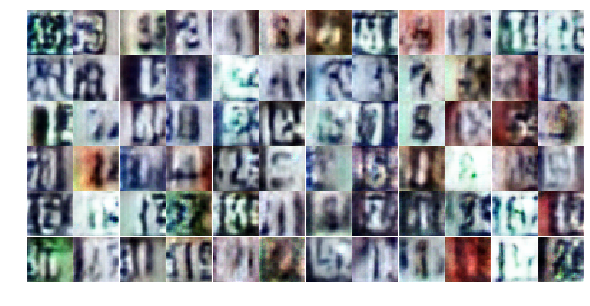

Epoch 9/25... Discriminator Loss: 2.8259... Generator Loss: 3.9973
Epoch 9/25... Discriminator Loss: 1.0294... Generator Loss: 1.4046
Epoch 9/25... Discriminator Loss: 1.5861... Generator Loss: 0.3403
Epoch 9/25... Discriminator Loss: 0.9181... Generator Loss: 0.9347
Epoch 9/25... Discriminator Loss: 0.8283... Generator Loss: 1.0321
Epoch 9/25... Discriminator Loss: 0.3305... Generator Loss: 4.4598
Epoch 9/25... Discriminator Loss: 0.7730... Generator Loss: 1.1513
Epoch 9/25... Discriminator Loss: 1.5452... Generator Loss: 0.3087
Epoch 9/25... Discriminator Loss: 0.6017... Generator Loss: 1.3156
Epoch 9/25... Discriminator Loss: 0.3043... Generator Loss: 4.0765


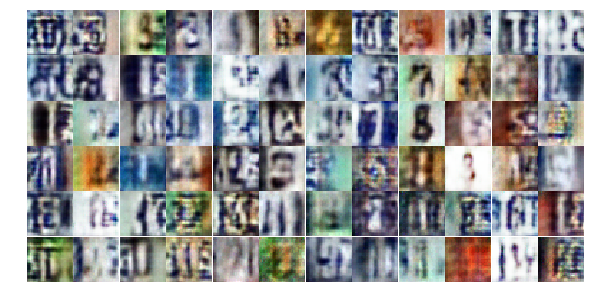

Epoch 9/25... Discriminator Loss: 0.0780... Generator Loss: 3.6017
Epoch 9/25... Discriminator Loss: 0.8128... Generator Loss: 0.8311
Epoch 9/25... Discriminator Loss: 0.6699... Generator Loss: 1.0767
Epoch 9/25... Discriminator Loss: 1.6585... Generator Loss: 0.2768
Epoch 9/25... Discriminator Loss: 1.1198... Generator Loss: 0.8720
Epoch 10/25... Discriminator Loss: 0.7700... Generator Loss: 0.7968
Epoch 10/25... Discriminator Loss: 1.2672... Generator Loss: 0.9851
Epoch 10/25... Discriminator Loss: 1.2725... Generator Loss: 0.4755
Epoch 10/25... Discriminator Loss: 1.0569... Generator Loss: 0.6702
Epoch 10/25... Discriminator Loss: 1.1421... Generator Loss: 1.4481


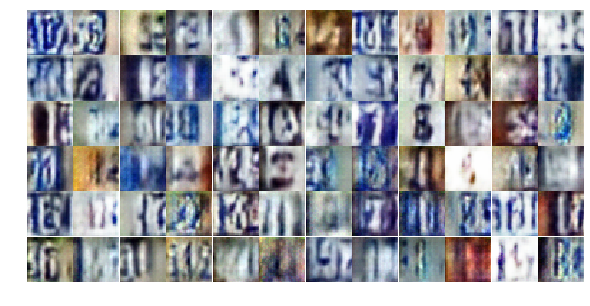

Epoch 10/25... Discriminator Loss: 0.4117... Generator Loss: 2.6512
Epoch 10/25... Discriminator Loss: 0.7432... Generator Loss: 1.5061
Epoch 10/25... Discriminator Loss: 0.7034... Generator Loss: 1.1495
Epoch 10/25... Discriminator Loss: 1.3188... Generator Loss: 0.4338
Epoch 10/25... Discriminator Loss: 0.1172... Generator Loss: 3.9988
Epoch 10/25... Discriminator Loss: 0.6976... Generator Loss: 2.6933
Epoch 10/25... Discriminator Loss: 0.8974... Generator Loss: 2.1176
Epoch 10/25... Discriminator Loss: 0.6943... Generator Loss: 1.3586
Epoch 10/25... Discriminator Loss: 0.7903... Generator Loss: 0.9977
Epoch 10/25... Discriminator Loss: 0.2534... Generator Loss: 4.5668


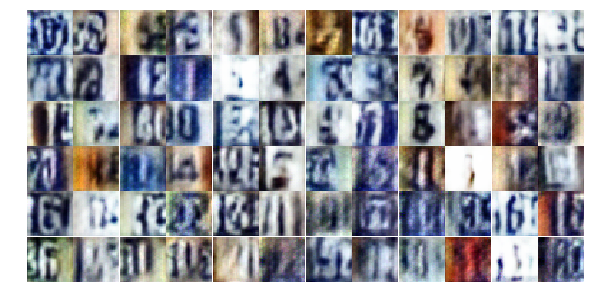

Epoch 10/25... Discriminator Loss: 0.5901... Generator Loss: 1.0550
Epoch 10/25... Discriminator Loss: 1.0169... Generator Loss: 3.1470
Epoch 10/25... Discriminator Loss: 0.9216... Generator Loss: 1.9086
Epoch 10/25... Discriminator Loss: 0.8165... Generator Loss: 1.1917
Epoch 10/25... Discriminator Loss: 0.7032... Generator Loss: 0.8541
Epoch 10/25... Discriminator Loss: 0.0472... Generator Loss: 6.0964
Epoch 10/25... Discriminator Loss: 1.1403... Generator Loss: 2.3163
Epoch 10/25... Discriminator Loss: 0.5330... Generator Loss: 1.5699
Epoch 10/25... Discriminator Loss: 0.5702... Generator Loss: 1.3958
Epoch 10/25... Discriminator Loss: 0.8059... Generator Loss: 2.6973


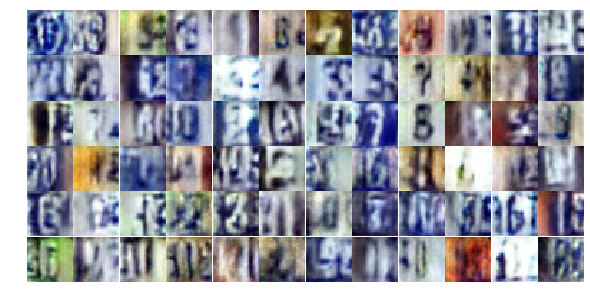

Epoch 10/25... Discriminator Loss: 0.6640... Generator Loss: 1.6799
Epoch 10/25... Discriminator Loss: 1.4071... Generator Loss: 0.3876
Epoch 10/25... Discriminator Loss: 0.4078... Generator Loss: 2.2023
Epoch 10/25... Discriminator Loss: 1.3785... Generator Loss: 0.9528
Epoch 10/25... Discriminator Loss: 1.0136... Generator Loss: 0.6392
Epoch 10/25... Discriminator Loss: 1.2418... Generator Loss: 0.5024
Epoch 10/25... Discriminator Loss: 0.7499... Generator Loss: 1.0820
Epoch 10/25... Discriminator Loss: 0.7164... Generator Loss: 2.3175
Epoch 10/25... Discriminator Loss: 0.9260... Generator Loss: 0.7664
Epoch 10/25... Discriminator Loss: 1.1012... Generator Loss: 1.7286


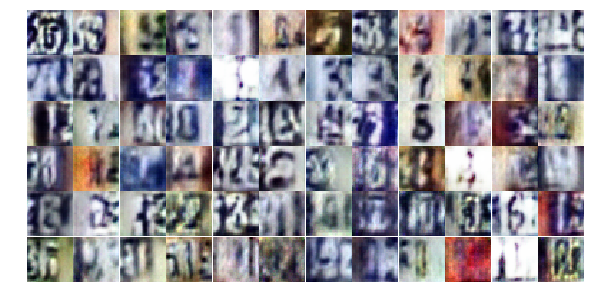

Epoch 10/25... Discriminator Loss: 0.7471... Generator Loss: 0.9613
Epoch 10/25... Discriminator Loss: 1.1217... Generator Loss: 1.2099
Epoch 10/25... Discriminator Loss: 1.5921... Generator Loss: 2.0489
Epoch 10/25... Discriminator Loss: 0.4085... Generator Loss: 2.4113
Epoch 10/25... Discriminator Loss: 0.8305... Generator Loss: 0.8447
Epoch 10/25... Discriminator Loss: 0.8891... Generator Loss: 1.1653
Epoch 10/25... Discriminator Loss: 0.4082... Generator Loss: 1.3924
Epoch 10/25... Discriminator Loss: 0.4597... Generator Loss: 1.5631
Epoch 10/25... Discriminator Loss: 0.7565... Generator Loss: 1.0369
Epoch 10/25... Discriminator Loss: 1.0262... Generator Loss: 1.6355


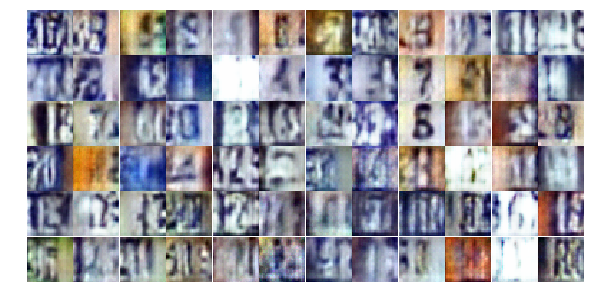

Epoch 10/25... Discriminator Loss: 0.9702... Generator Loss: 0.7648
Epoch 10/25... Discriminator Loss: 1.4607... Generator Loss: 1.1274
Epoch 10/25... Discriminator Loss: 1.6036... Generator Loss: 0.3222
Epoch 10/25... Discriminator Loss: 0.6309... Generator Loss: 1.0649
Epoch 10/25... Discriminator Loss: 1.5333... Generator Loss: 0.3334
Epoch 10/25... Discriminator Loss: 0.8786... Generator Loss: 0.9413
Epoch 10/25... Discriminator Loss: 0.8517... Generator Loss: 1.0378
Epoch 10/25... Discriminator Loss: 0.8734... Generator Loss: 0.7535
Epoch 10/25... Discriminator Loss: 0.8767... Generator Loss: 0.7377
Epoch 10/25... Discriminator Loss: 0.4377... Generator Loss: 2.0920


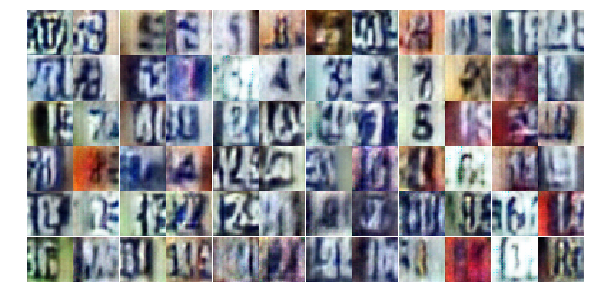

Epoch 10/25... Discriminator Loss: 0.0398... Generator Loss: 7.2563
Epoch 10/25... Discriminator Loss: 0.1314... Generator Loss: 4.6914
Epoch 10/25... Discriminator Loss: 0.9897... Generator Loss: 1.4322
Epoch 11/25... Discriminator Loss: 0.6630... Generator Loss: 1.0795
Epoch 11/25... Discriminator Loss: 0.7726... Generator Loss: 0.8309
Epoch 11/25... Discriminator Loss: 0.2499... Generator Loss: 1.7633
Epoch 11/25... Discriminator Loss: 0.6065... Generator Loss: 1.6126
Epoch 11/25... Discriminator Loss: 1.0772... Generator Loss: 0.6438
Epoch 11/25... Discriminator Loss: 0.5993... Generator Loss: 1.6165
Epoch 11/25... Discriminator Loss: 1.0244... Generator Loss: 3.9250


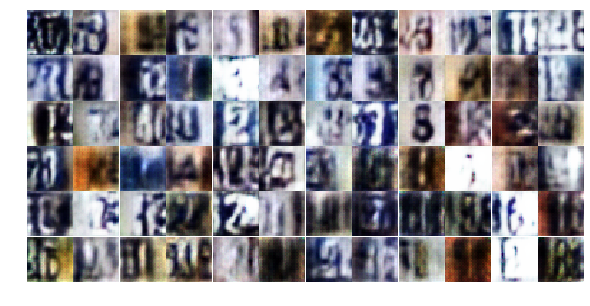

Epoch 11/25... Discriminator Loss: 1.0567... Generator Loss: 0.6209
Epoch 11/25... Discriminator Loss: 0.0461... Generator Loss: 4.3418
Epoch 11/25... Discriminator Loss: 0.9461... Generator Loss: 0.6300
Epoch 11/25... Discriminator Loss: 0.8435... Generator Loss: 1.7238
Epoch 11/25... Discriminator Loss: 0.6106... Generator Loss: 2.1639
Epoch 11/25... Discriminator Loss: 0.7699... Generator Loss: 1.6491
Epoch 11/25... Discriminator Loss: 0.4193... Generator Loss: 1.7145
Epoch 11/25... Discriminator Loss: 0.9721... Generator Loss: 0.8664
Epoch 11/25... Discriminator Loss: 0.3793... Generator Loss: 1.6248
Epoch 11/25... Discriminator Loss: 0.8969... Generator Loss: 1.0590


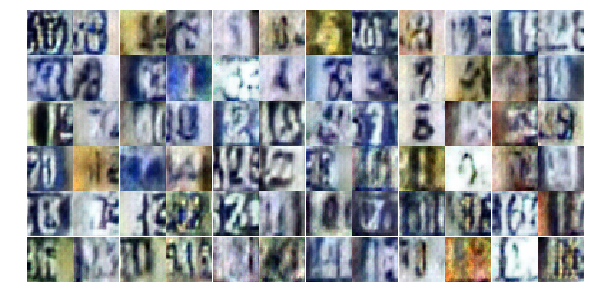

Epoch 11/25... Discriminator Loss: 0.0433... Generator Loss: 5.8023
Epoch 11/25... Discriminator Loss: 0.7139... Generator Loss: 1.0441
Epoch 11/25... Discriminator Loss: 0.7231... Generator Loss: 1.1363
Epoch 11/25... Discriminator Loss: 0.7350... Generator Loss: 0.8568
Epoch 11/25... Discriminator Loss: 0.6888... Generator Loss: 0.8856
Epoch 11/25... Discriminator Loss: 0.1080... Generator Loss: 5.1853
Epoch 11/25... Discriminator Loss: 0.4401... Generator Loss: 1.4137
Epoch 11/25... Discriminator Loss: 1.0507... Generator Loss: 1.6608
Epoch 11/25... Discriminator Loss: 1.0503... Generator Loss: 2.6070
Epoch 11/25... Discriminator Loss: 0.7371... Generator Loss: 1.3245


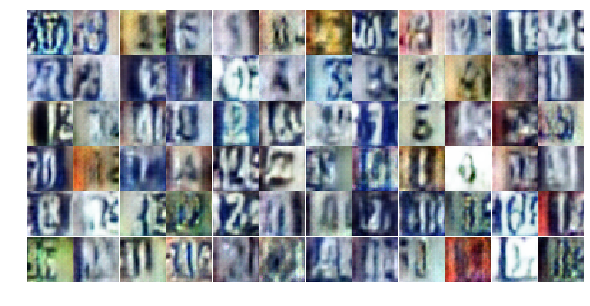

Epoch 11/25... Discriminator Loss: 2.0354... Generator Loss: 0.1848
Epoch 11/25... Discriminator Loss: 0.6116... Generator Loss: 1.4208
Epoch 11/25... Discriminator Loss: 1.0656... Generator Loss: 0.9552
Epoch 11/25... Discriminator Loss: 1.0142... Generator Loss: 1.2004
Epoch 11/25... Discriminator Loss: 0.4482... Generator Loss: 1.9480
Epoch 11/25... Discriminator Loss: 1.2482... Generator Loss: 1.5154
Epoch 11/25... Discriminator Loss: 1.8187... Generator Loss: 0.2468
Epoch 11/25... Discriminator Loss: 0.7972... Generator Loss: 0.7861
Epoch 11/25... Discriminator Loss: 1.2041... Generator Loss: 0.5390
Epoch 11/25... Discriminator Loss: 0.4929... Generator Loss: 1.4895


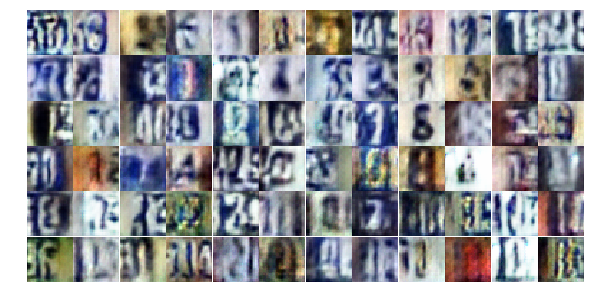

Epoch 11/25... Discriminator Loss: 0.2472... Generator Loss: 3.0935
Epoch 11/25... Discriminator Loss: 1.0737... Generator Loss: 0.5675
Epoch 11/25... Discriminator Loss: 0.0750... Generator Loss: 5.3295
Epoch 11/25... Discriminator Loss: 0.4489... Generator Loss: 2.7838
Epoch 11/25... Discriminator Loss: 0.8939... Generator Loss: 0.7224
Epoch 11/25... Discriminator Loss: 0.9271... Generator Loss: 1.0826
Epoch 11/25... Discriminator Loss: 0.2795... Generator Loss: 2.4615
Epoch 11/25... Discriminator Loss: 0.7720... Generator Loss: 0.8525
Epoch 11/25... Discriminator Loss: 1.2684... Generator Loss: 0.5133
Epoch 11/25... Discriminator Loss: 0.3398... Generator Loss: 4.7319


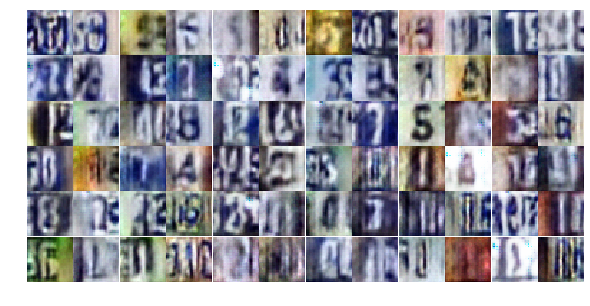

Epoch 11/25... Discriminator Loss: 1.3452... Generator Loss: 0.4073
Epoch 11/25... Discriminator Loss: 0.3958... Generator Loss: 1.8946
Epoch 11/25... Discriminator Loss: 0.5902... Generator Loss: 1.3869
Epoch 11/25... Discriminator Loss: 0.6714... Generator Loss: 1.1244
Epoch 11/25... Discriminator Loss: 0.8773... Generator Loss: 0.7154
Epoch 11/25... Discriminator Loss: 1.0191... Generator Loss: 0.8474
Epoch 11/25... Discriminator Loss: 0.7184... Generator Loss: 1.8361
Epoch 11/25... Discriminator Loss: 0.6696... Generator Loss: 2.0738
Epoch 11/25... Discriminator Loss: 1.9151... Generator Loss: 0.2539
Epoch 11/25... Discriminator Loss: 0.9693... Generator Loss: 0.7700


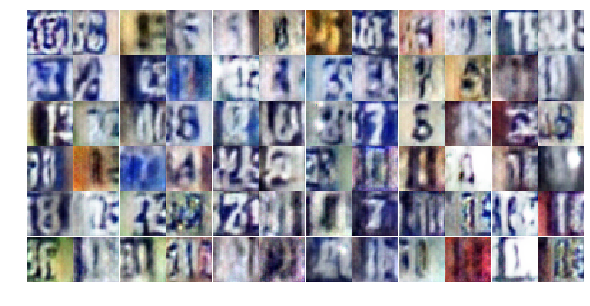

Epoch 12/25... Discriminator Loss: 0.9834... Generator Loss: 1.4458
Epoch 12/25... Discriminator Loss: 0.6516... Generator Loss: 1.7643
Epoch 12/25... Discriminator Loss: 1.3376... Generator Loss: 0.4171
Epoch 12/25... Discriminator Loss: 0.9871... Generator Loss: 0.9161
Epoch 12/25... Discriminator Loss: 0.6414... Generator Loss: 1.4160
Epoch 12/25... Discriminator Loss: 1.1539... Generator Loss: 0.5136
Epoch 12/25... Discriminator Loss: 0.5298... Generator Loss: 1.3901
Epoch 12/25... Discriminator Loss: 1.3389... Generator Loss: 0.4861
Epoch 12/25... Discriminator Loss: 0.3637... Generator Loss: 1.6102
Epoch 12/25... Discriminator Loss: 0.3560... Generator Loss: 1.8494


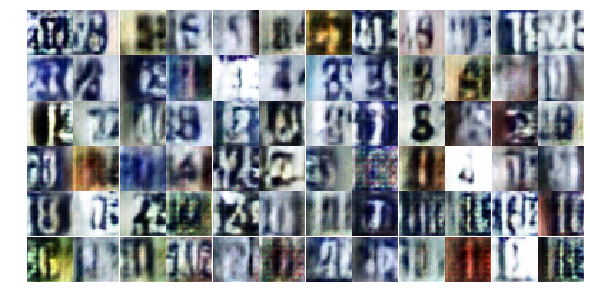

Epoch 12/25... Discriminator Loss: 1.5291... Generator Loss: 0.3314
Epoch 12/25... Discriminator Loss: 0.4198... Generator Loss: 1.4008
Epoch 12/25... Discriminator Loss: 0.1568... Generator Loss: 2.7613
Epoch 12/25... Discriminator Loss: 0.9038... Generator Loss: 1.2465
Epoch 12/25... Discriminator Loss: 0.8327... Generator Loss: 0.9919
Epoch 12/25... Discriminator Loss: 1.5984... Generator Loss: 0.3079
Epoch 12/25... Discriminator Loss: 0.9123... Generator Loss: 0.7769
Epoch 12/25... Discriminator Loss: 1.1168... Generator Loss: 0.6378
Epoch 12/25... Discriminator Loss: 0.5573... Generator Loss: 1.1729
Epoch 12/25... Discriminator Loss: 1.3623... Generator Loss: 1.6941


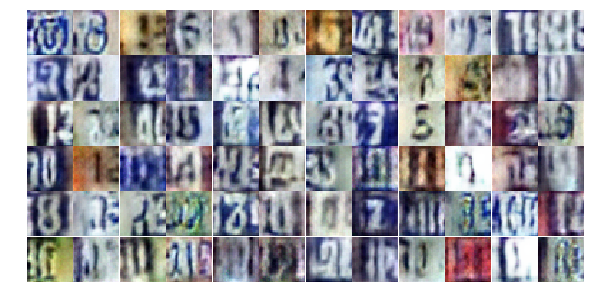

Epoch 12/25... Discriminator Loss: 0.1889... Generator Loss: 2.9228
Epoch 12/25... Discriminator Loss: 0.0640... Generator Loss: 3.5719
Epoch 12/25... Discriminator Loss: 0.7200... Generator Loss: 0.9231
Epoch 12/25... Discriminator Loss: 1.4527... Generator Loss: 0.3369
Epoch 12/25... Discriminator Loss: 1.6225... Generator Loss: 0.4964
Epoch 12/25... Discriminator Loss: 1.4733... Generator Loss: 1.2367
Epoch 12/25... Discriminator Loss: 0.5564... Generator Loss: 1.1975
Epoch 12/25... Discriminator Loss: 0.7819... Generator Loss: 1.0278
Epoch 12/25... Discriminator Loss: 0.2887... Generator Loss: 2.1572
Epoch 12/25... Discriminator Loss: 0.6180... Generator Loss: 1.0305


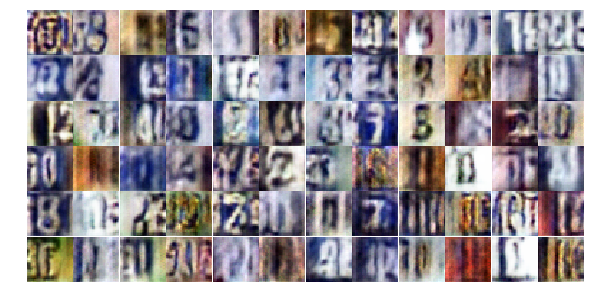

Epoch 12/25... Discriminator Loss: 1.0026... Generator Loss: 0.7147
Epoch 12/25... Discriminator Loss: 1.2474... Generator Loss: 0.4928
Epoch 12/25... Discriminator Loss: 0.4818... Generator Loss: 1.4878
Epoch 12/25... Discriminator Loss: 2.4109... Generator Loss: 0.1705
Epoch 12/25... Discriminator Loss: 0.5693... Generator Loss: 1.7422
Epoch 12/25... Discriminator Loss: 0.3577... Generator Loss: 1.8495
Epoch 12/25... Discriminator Loss: 0.4742... Generator Loss: 1.3356
Epoch 12/25... Discriminator Loss: 0.5893... Generator Loss: 1.4000
Epoch 12/25... Discriminator Loss: 0.7597... Generator Loss: 0.9627
Epoch 12/25... Discriminator Loss: 0.8341... Generator Loss: 1.0384


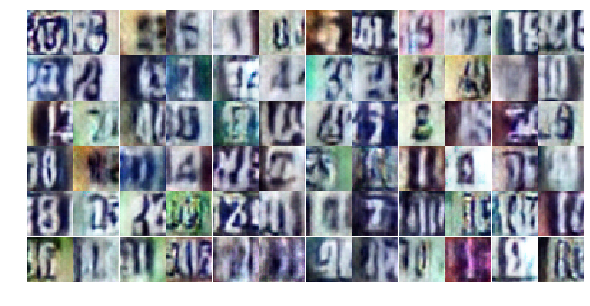

Epoch 12/25... Discriminator Loss: 0.5965... Generator Loss: 1.5943
Epoch 12/25... Discriminator Loss: 1.2503... Generator Loss: 1.2672
Epoch 12/25... Discriminator Loss: 1.1061... Generator Loss: 0.6304
Epoch 12/25... Discriminator Loss: 0.1681... Generator Loss: 2.3845
Epoch 12/25... Discriminator Loss: 0.7429... Generator Loss: 0.9431
Epoch 12/25... Discriminator Loss: 0.9109... Generator Loss: 0.7069
Epoch 12/25... Discriminator Loss: 0.4808... Generator Loss: 1.7426
Epoch 12/25... Discriminator Loss: 0.5925... Generator Loss: 1.5681
Epoch 12/25... Discriminator Loss: 1.4481... Generator Loss: 0.4537
Epoch 12/25... Discriminator Loss: 0.6107... Generator Loss: 1.1196


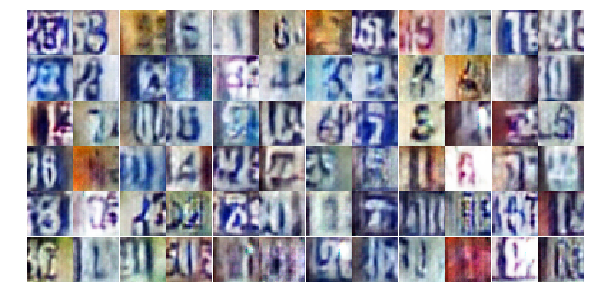

Epoch 12/25... Discriminator Loss: 1.0950... Generator Loss: 0.5871
Epoch 12/25... Discriminator Loss: 1.0333... Generator Loss: 0.6584
Epoch 12/25... Discriminator Loss: 2.6554... Generator Loss: 0.1290
Epoch 12/25... Discriminator Loss: 0.8733... Generator Loss: 0.7546
Epoch 12/25... Discriminator Loss: 0.1172... Generator Loss: 3.7933
Epoch 12/25... Discriminator Loss: 1.1439... Generator Loss: 0.5265
Epoch 12/25... Discriminator Loss: 0.6010... Generator Loss: 1.1273
Epoch 13/25... Discriminator Loss: 1.2451... Generator Loss: 0.5256
Epoch 13/25... Discriminator Loss: 0.8100... Generator Loss: 0.9458
Epoch 13/25... Discriminator Loss: 0.7544... Generator Loss: 0.9468


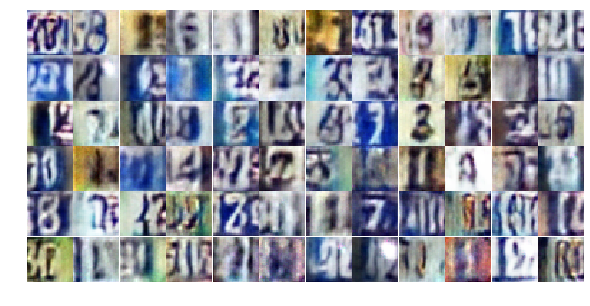

Epoch 13/25... Discriminator Loss: 0.9433... Generator Loss: 0.6780
Epoch 13/25... Discriminator Loss: 0.1454... Generator Loss: 4.5922
Epoch 13/25... Discriminator Loss: 0.4152... Generator Loss: 1.5814
Epoch 13/25... Discriminator Loss: 1.2989... Generator Loss: 0.5326
Epoch 13/25... Discriminator Loss: 0.3441... Generator Loss: 1.9261
Epoch 13/25... Discriminator Loss: 1.0258... Generator Loss: 1.2223
Epoch 13/25... Discriminator Loss: 0.6482... Generator Loss: 2.2821
Epoch 13/25... Discriminator Loss: 0.6511... Generator Loss: 0.9987
Epoch 13/25... Discriminator Loss: 0.0439... Generator Loss: 6.0813
Epoch 13/25... Discriminator Loss: 1.7023... Generator Loss: 0.3030


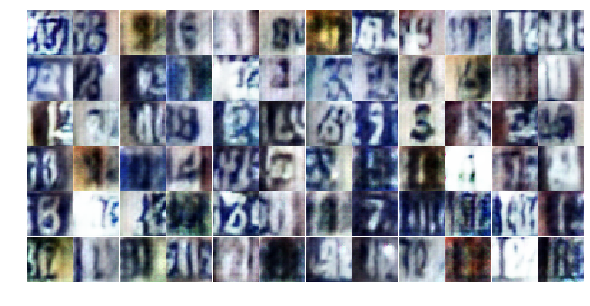

Epoch 13/25... Discriminator Loss: 0.8785... Generator Loss: 0.9006
Epoch 13/25... Discriminator Loss: 0.7044... Generator Loss: 1.0996
Epoch 13/25... Discriminator Loss: 0.4233... Generator Loss: 1.6498
Epoch 13/25... Discriminator Loss: 0.6687... Generator Loss: 1.4537
Epoch 13/25... Discriminator Loss: 0.0465... Generator Loss: 11.1257
Epoch 13/25... Discriminator Loss: 0.0123... Generator Loss: 6.0199
Epoch 13/25... Discriminator Loss: 0.0252... Generator Loss: 4.2540
Epoch 13/25... Discriminator Loss: 0.0232... Generator Loss: 4.0993
Epoch 13/25... Discriminator Loss: 0.0159... Generator Loss: 5.1082
Epoch 13/25... Discriminator Loss: 0.0553... Generator Loss: 3.1721


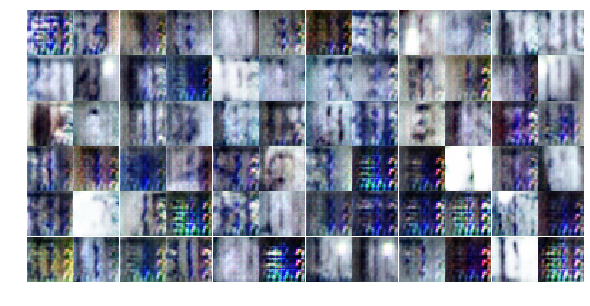

Epoch 13/25... Discriminator Loss: 0.1125... Generator Loss: 3.1156
Epoch 13/25... Discriminator Loss: 0.1669... Generator Loss: 2.2198
Epoch 13/25... Discriminator Loss: 0.3716... Generator Loss: 2.1741
Epoch 13/25... Discriminator Loss: 0.4281... Generator Loss: 2.1865
Epoch 13/25... Discriminator Loss: 0.6421... Generator Loss: 1.1164
Epoch 13/25... Discriminator Loss: 0.6485... Generator Loss: 2.2026
Epoch 13/25... Discriminator Loss: 1.5546... Generator Loss: 0.3632
Epoch 13/25... Discriminator Loss: 0.3050... Generator Loss: 3.4239
Epoch 13/25... Discriminator Loss: 0.8612... Generator Loss: 1.0723
Epoch 13/25... Discriminator Loss: 0.6682... Generator Loss: 1.1819


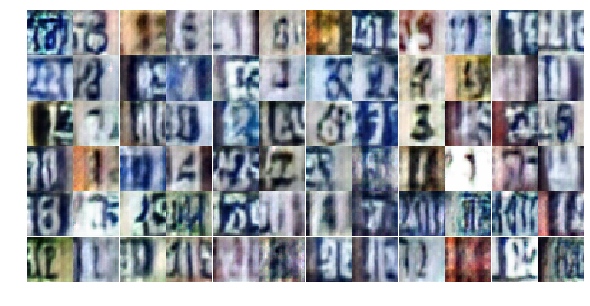

Epoch 13/25... Discriminator Loss: 0.9859... Generator Loss: 0.7752
Epoch 13/25... Discriminator Loss: 0.6418... Generator Loss: 1.2736
Epoch 13/25... Discriminator Loss: 0.7989... Generator Loss: 1.0625
Epoch 13/25... Discriminator Loss: 1.0169... Generator Loss: 1.3071
Epoch 13/25... Discriminator Loss: 1.2246... Generator Loss: 1.4023
Epoch 13/25... Discriminator Loss: 0.6598... Generator Loss: 2.2897
Epoch 13/25... Discriminator Loss: 0.7353... Generator Loss: 0.7956
Epoch 13/25... Discriminator Loss: 0.4584... Generator Loss: 1.5515
Epoch 13/25... Discriminator Loss: 0.1832... Generator Loss: 3.4520
Epoch 13/25... Discriminator Loss: 1.6174... Generator Loss: 0.4013


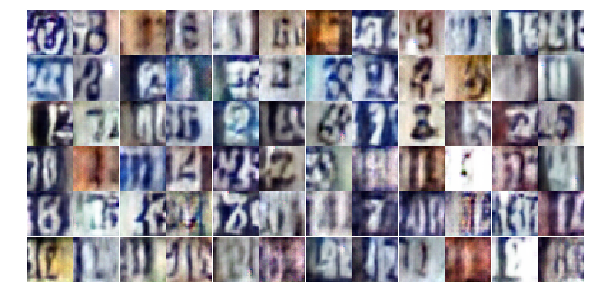

Epoch 13/25... Discriminator Loss: 0.4174... Generator Loss: 1.5875
Epoch 13/25... Discriminator Loss: 2.7028... Generator Loss: 0.0998
Epoch 13/25... Discriminator Loss: 1.0389... Generator Loss: 1.1180
Epoch 13/25... Discriminator Loss: 0.6640... Generator Loss: 1.5311
Epoch 13/25... Discriminator Loss: 1.1545... Generator Loss: 1.3170
Epoch 13/25... Discriminator Loss: 0.7881... Generator Loss: 0.8896
Epoch 13/25... Discriminator Loss: 0.6019... Generator Loss: 1.7246
Epoch 13/25... Discriminator Loss: 0.0491... Generator Loss: 7.4247
Epoch 13/25... Discriminator Loss: 0.0592... Generator Loss: 3.2570
Epoch 13/25... Discriminator Loss: 0.3410... Generator Loss: 1.5131


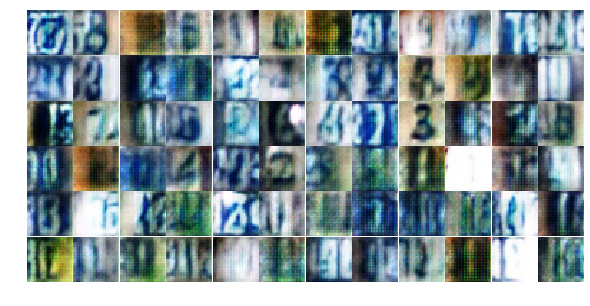

Epoch 13/25... Discriminator Loss: 0.1855... Generator Loss: 2.0407
Epoch 13/25... Discriminator Loss: 0.3320... Generator Loss: 1.6648
Epoch 13/25... Discriminator Loss: 0.4327... Generator Loss: 1.4793
Epoch 13/25... Discriminator Loss: 0.3100... Generator Loss: 1.7159
Epoch 14/25... Discriminator Loss: 1.0075... Generator Loss: 0.8945
Epoch 14/25... Discriminator Loss: 0.6443... Generator Loss: 1.1626
Epoch 14/25... Discriminator Loss: 0.4510... Generator Loss: 1.8042
Epoch 14/25... Discriminator Loss: 2.0997... Generator Loss: 2.4332
Epoch 14/25... Discriminator Loss: 0.9223... Generator Loss: 0.8264
Epoch 14/25... Discriminator Loss: 0.4342... Generator Loss: 2.6297


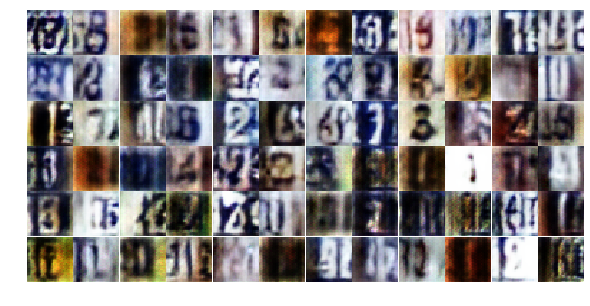

Epoch 14/25... Discriminator Loss: 0.4057... Generator Loss: 2.1898
Epoch 14/25... Discriminator Loss: 0.6666... Generator Loss: 1.5626
Epoch 14/25... Discriminator Loss: 0.4424... Generator Loss: 1.5176
Epoch 14/25... Discriminator Loss: 1.5812... Generator Loss: 0.2828
Epoch 14/25... Discriminator Loss: 0.9160... Generator Loss: 1.8206
Epoch 14/25... Discriminator Loss: 1.1693... Generator Loss: 0.5966
Epoch 14/25... Discriminator Loss: 0.9413... Generator Loss: 0.7767
Epoch 14/25... Discriminator Loss: 0.5436... Generator Loss: 1.3058
Epoch 14/25... Discriminator Loss: 1.8098... Generator Loss: 0.2202
Epoch 14/25... Discriminator Loss: 0.9692... Generator Loss: 0.7056


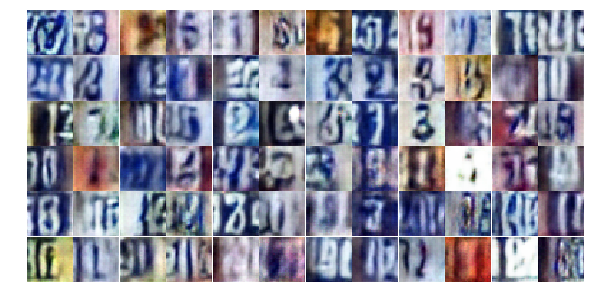

Epoch 14/25... Discriminator Loss: 0.6164... Generator Loss: 1.3887
Epoch 14/25... Discriminator Loss: 0.9473... Generator Loss: 0.9995
Epoch 14/25... Discriminator Loss: 0.8623... Generator Loss: 0.9332
Epoch 14/25... Discriminator Loss: 0.2510... Generator Loss: 2.1224
Epoch 14/25... Discriminator Loss: 0.4021... Generator Loss: 1.4549
Epoch 14/25... Discriminator Loss: 0.4933... Generator Loss: 1.5150
Epoch 14/25... Discriminator Loss: 1.3922... Generator Loss: 0.3893
Epoch 14/25... Discriminator Loss: 0.9684... Generator Loss: 0.6735
Epoch 14/25... Discriminator Loss: 0.5893... Generator Loss: 3.1455
Epoch 14/25... Discriminator Loss: 1.1023... Generator Loss: 0.5981


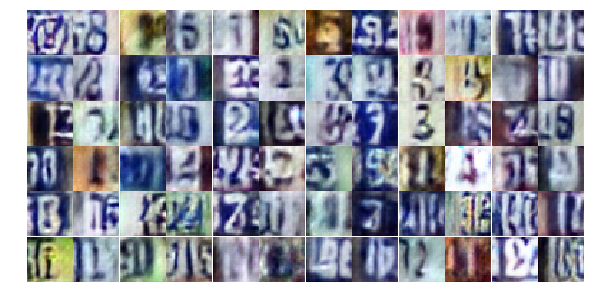

Epoch 14/25... Discriminator Loss: 0.2070... Generator Loss: 2.5395
Epoch 14/25... Discriminator Loss: 0.3840... Generator Loss: 1.6429
Epoch 14/25... Discriminator Loss: 0.5231... Generator Loss: 1.8141
Epoch 14/25... Discriminator Loss: 1.0165... Generator Loss: 0.6543
Epoch 14/25... Discriminator Loss: 0.7787... Generator Loss: 1.0845
Epoch 14/25... Discriminator Loss: 0.6174... Generator Loss: 1.7621
Epoch 14/25... Discriminator Loss: 0.5001... Generator Loss: 1.7987
Epoch 14/25... Discriminator Loss: 0.7563... Generator Loss: 0.8577
Epoch 14/25... Discriminator Loss: 0.7198... Generator Loss: 1.2843
Epoch 14/25... Discriminator Loss: 0.5977... Generator Loss: 1.1809


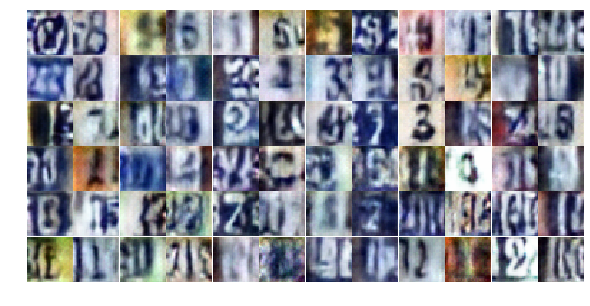

Epoch 14/25... Discriminator Loss: 0.8167... Generator Loss: 0.7930
Epoch 14/25... Discriminator Loss: 0.5618... Generator Loss: 1.1392
Epoch 14/25... Discriminator Loss: 0.4236... Generator Loss: 1.8925
Epoch 14/25... Discriminator Loss: 0.6452... Generator Loss: 1.0630
Epoch 14/25... Discriminator Loss: 1.2645... Generator Loss: 0.4490
Epoch 14/25... Discriminator Loss: 0.5426... Generator Loss: 1.4120
Epoch 14/25... Discriminator Loss: 0.8200... Generator Loss: 1.3388
Epoch 14/25... Discriminator Loss: 0.5094... Generator Loss: 1.3653
Epoch 14/25... Discriminator Loss: 0.6880... Generator Loss: 0.9216
Epoch 14/25... Discriminator Loss: 1.0929... Generator Loss: 1.0271


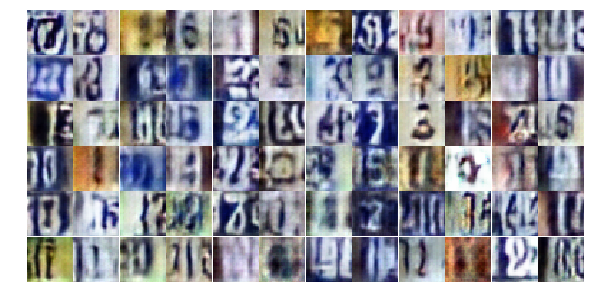

Epoch 14/25... Discriminator Loss: 0.9598... Generator Loss: 1.4764
Epoch 14/25... Discriminator Loss: 0.4004... Generator Loss: 2.2194
Epoch 14/25... Discriminator Loss: 0.9938... Generator Loss: 0.9810
Epoch 14/25... Discriminator Loss: 1.0664... Generator Loss: 0.6441
Epoch 14/25... Discriminator Loss: 0.6938... Generator Loss: 1.1260
Epoch 14/25... Discriminator Loss: 0.9197... Generator Loss: 0.8939
Epoch 14/25... Discriminator Loss: 0.5702... Generator Loss: 1.2901
Epoch 14/25... Discriminator Loss: 0.4135... Generator Loss: 1.7365
Epoch 14/25... Discriminator Loss: 0.7460... Generator Loss: 0.8970
Epoch 14/25... Discriminator Loss: 0.9139... Generator Loss: 0.8255


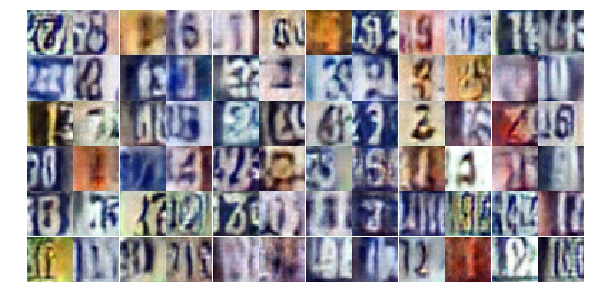

Epoch 14/25... Discriminator Loss: 0.4282... Generator Loss: 1.5393
Epoch 14/25... Discriminator Loss: 0.7611... Generator Loss: 1.1080
Epoch 15/25... Discriminator Loss: 5.4239... Generator Loss: 7.9836
Epoch 15/25... Discriminator Loss: 1.4767... Generator Loss: 0.4790
Epoch 15/25... Discriminator Loss: 0.7496... Generator Loss: 0.8950
Epoch 15/25... Discriminator Loss: 1.0849... Generator Loss: 0.6466
Epoch 15/25... Discriminator Loss: 0.4501... Generator Loss: 1.3824
Epoch 15/25... Discriminator Loss: 0.6791... Generator Loss: 1.0937
Epoch 15/25... Discriminator Loss: 1.2447... Generator Loss: 0.5455
Epoch 15/25... Discriminator Loss: 0.0086... Generator Loss: 9.6545


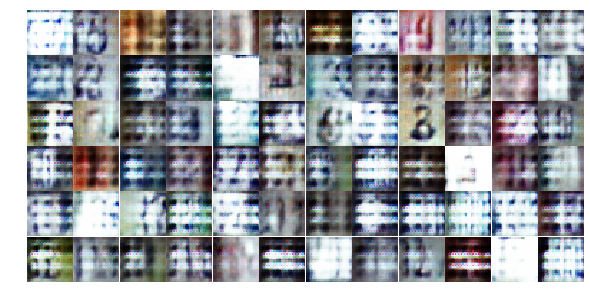

Epoch 15/25... Discriminator Loss: 0.1302... Generator Loss: 3.1229
Epoch 15/25... Discriminator Loss: 0.4276... Generator Loss: 1.4254
Epoch 15/25... Discriminator Loss: 0.3186... Generator Loss: 1.8653
Epoch 15/25... Discriminator Loss: 1.5007... Generator Loss: 0.3691
Epoch 15/25... Discriminator Loss: 1.3976... Generator Loss: 0.4606
Epoch 15/25... Discriminator Loss: 0.4526... Generator Loss: 1.6574
Epoch 15/25... Discriminator Loss: 1.2759... Generator Loss: 0.4150
Epoch 15/25... Discriminator Loss: 0.1750... Generator Loss: 4.3367
Epoch 15/25... Discriminator Loss: 0.5111... Generator Loss: 1.2624
Epoch 15/25... Discriminator Loss: 0.4694... Generator Loss: 1.4406


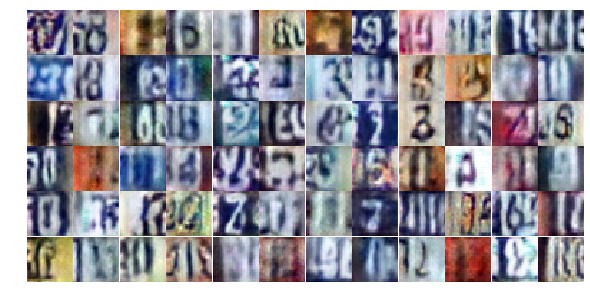

Epoch 15/25... Discriminator Loss: 0.7988... Generator Loss: 0.8115
Epoch 15/25... Discriminator Loss: 0.4040... Generator Loss: 1.7113
Epoch 15/25... Discriminator Loss: 0.6097... Generator Loss: 1.6779
Epoch 15/25... Discriminator Loss: 0.7914... Generator Loss: 0.8793
Epoch 15/25... Discriminator Loss: 0.4380... Generator Loss: 1.7294
Epoch 15/25... Discriminator Loss: 0.2791... Generator Loss: 1.6711
Epoch 15/25... Discriminator Loss: 0.2358... Generator Loss: 1.9411
Epoch 15/25... Discriminator Loss: 0.7724... Generator Loss: 0.9594
Epoch 15/25... Discriminator Loss: 1.9903... Generator Loss: 0.1959
Epoch 15/25... Discriminator Loss: 1.1258... Generator Loss: 0.5400


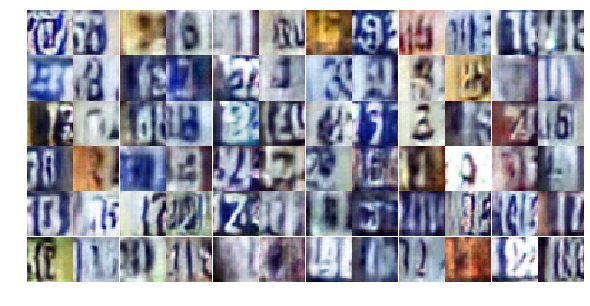

Epoch 15/25... Discriminator Loss: 0.8400... Generator Loss: 0.7948
Epoch 15/25... Discriminator Loss: 0.7238... Generator Loss: 2.3294
Epoch 15/25... Discriminator Loss: 0.6808... Generator Loss: 1.0416
Epoch 15/25... Discriminator Loss: 0.9025... Generator Loss: 1.3718
Epoch 15/25... Discriminator Loss: 0.9540... Generator Loss: 0.7671
Epoch 15/25... Discriminator Loss: 0.5334... Generator Loss: 1.4343
Epoch 15/25... Discriminator Loss: 0.9714... Generator Loss: 0.9786
Epoch 15/25... Discriminator Loss: 1.3136... Generator Loss: 0.4200
Epoch 15/25... Discriminator Loss: 0.8306... Generator Loss: 1.0831
Epoch 15/25... Discriminator Loss: 0.0099... Generator Loss: 6.8200


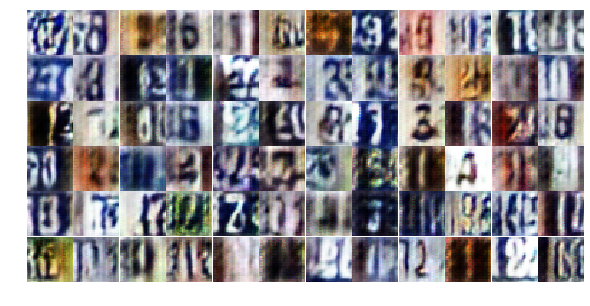

Epoch 15/25... Discriminator Loss: 0.4538... Generator Loss: 1.3743
Epoch 15/25... Discriminator Loss: 1.4255... Generator Loss: 0.3970
Epoch 15/25... Discriminator Loss: 1.1420... Generator Loss: 0.6287
Epoch 15/25... Discriminator Loss: 0.3723... Generator Loss: 1.6452
Epoch 15/25... Discriminator Loss: 0.3602... Generator Loss: 1.6145
Epoch 15/25... Discriminator Loss: 1.2994... Generator Loss: 0.4295
Epoch 15/25... Discriminator Loss: 0.9626... Generator Loss: 0.6463
Epoch 15/25... Discriminator Loss: 0.8495... Generator Loss: 1.4569
Epoch 15/25... Discriminator Loss: 0.9218... Generator Loss: 0.7783
Epoch 15/25... Discriminator Loss: 0.8306... Generator Loss: 0.9095


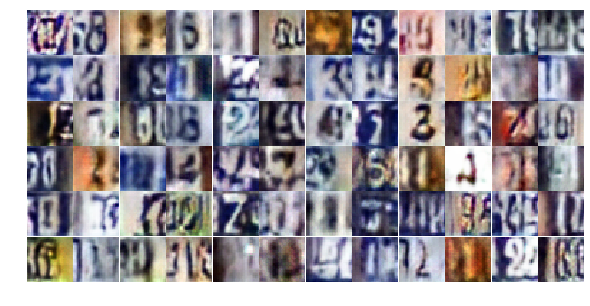

Epoch 15/25... Discriminator Loss: 0.8824... Generator Loss: 1.0350
Epoch 15/25... Discriminator Loss: 0.9574... Generator Loss: 0.6820
Epoch 15/25... Discriminator Loss: 0.5373... Generator Loss: 1.6078
Epoch 15/25... Discriminator Loss: 0.9327... Generator Loss: 0.8792
Epoch 15/25... Discriminator Loss: 0.6612... Generator Loss: 1.4032
Epoch 15/25... Discriminator Loss: 0.4385... Generator Loss: 1.5082
Epoch 15/25... Discriminator Loss: 0.1382... Generator Loss: 2.4773
Epoch 15/25... Discriminator Loss: 0.7297... Generator Loss: 1.4797
Epoch 15/25... Discriminator Loss: 1.0650... Generator Loss: 0.6300
Epoch 16/25... Discriminator Loss: 0.4966... Generator Loss: 1.3553


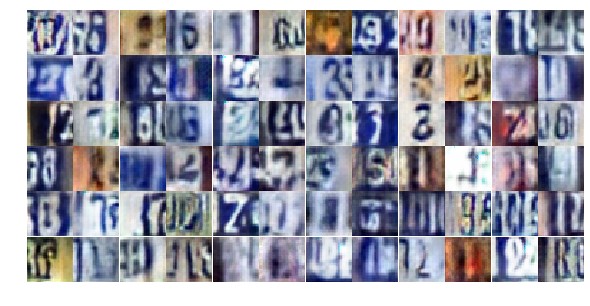

Epoch 16/25... Discriminator Loss: 0.6288... Generator Loss: 1.2384
Epoch 16/25... Discriminator Loss: 0.4335... Generator Loss: 2.1445
Epoch 16/25... Discriminator Loss: 0.7491... Generator Loss: 1.3672
Epoch 16/25... Discriminator Loss: 0.7352... Generator Loss: 1.6203
Epoch 16/25... Discriminator Loss: 1.0780... Generator Loss: 0.6774
Epoch 16/25... Discriminator Loss: 0.5393... Generator Loss: 2.0036
Epoch 16/25... Discriminator Loss: 0.4088... Generator Loss: 2.1793
Epoch 16/25... Discriminator Loss: 0.4992... Generator Loss: 1.7692
Epoch 16/25... Discriminator Loss: 1.0464... Generator Loss: 0.5837
Epoch 16/25... Discriminator Loss: 0.8698... Generator Loss: 0.6948


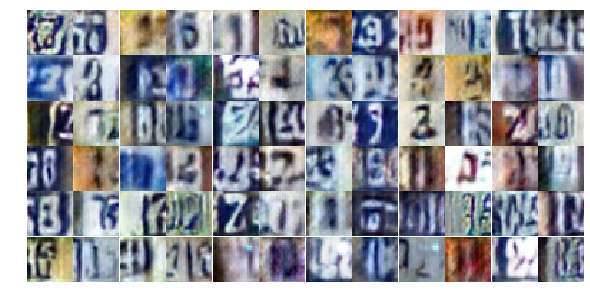

Epoch 16/25... Discriminator Loss: 1.3371... Generator Loss: 0.4724
Epoch 16/25... Discriminator Loss: 0.7286... Generator Loss: 1.1728
Epoch 16/25... Discriminator Loss: 0.8199... Generator Loss: 1.2610
Epoch 16/25... Discriminator Loss: 0.1049... Generator Loss: 3.6745
Epoch 16/25... Discriminator Loss: 0.8592... Generator Loss: 1.0022
Epoch 16/25... Discriminator Loss: 0.7511... Generator Loss: 1.0432
Epoch 16/25... Discriminator Loss: 0.4729... Generator Loss: 1.5189
Epoch 16/25... Discriminator Loss: 0.6196... Generator Loss: 1.4041
Epoch 16/25... Discriminator Loss: 1.0852... Generator Loss: 0.6003
Epoch 16/25... Discriminator Loss: 0.8726... Generator Loss: 0.9643


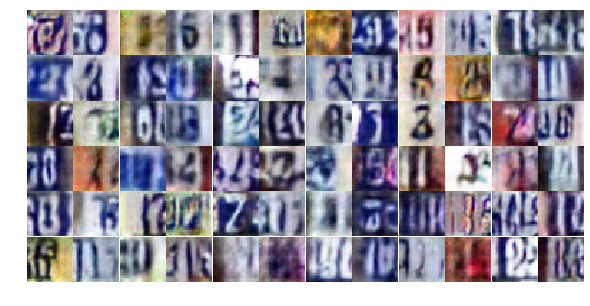

Epoch 16/25... Discriminator Loss: 0.6821... Generator Loss: 1.3355
Epoch 16/25... Discriminator Loss: 0.6221... Generator Loss: 1.1206
Epoch 16/25... Discriminator Loss: 0.6264... Generator Loss: 1.4093
Epoch 16/25... Discriminator Loss: 0.5088... Generator Loss: 1.2141
Epoch 16/25... Discriminator Loss: 0.3795... Generator Loss: 1.5651
Epoch 16/25... Discriminator Loss: 0.7164... Generator Loss: 1.2748
Epoch 16/25... Discriminator Loss: 1.1670... Generator Loss: 0.5404
Epoch 16/25... Discriminator Loss: 0.6644... Generator Loss: 1.3494
Epoch 16/25... Discriminator Loss: 0.9365... Generator Loss: 1.2889
Epoch 16/25... Discriminator Loss: 1.3369... Generator Loss: 0.4513


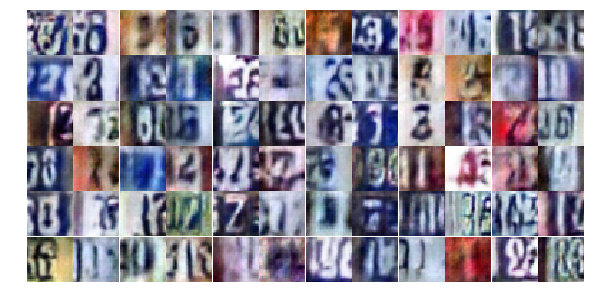

Epoch 16/25... Discriminator Loss: 1.0521... Generator Loss: 0.5864
Epoch 16/25... Discriminator Loss: 1.0843... Generator Loss: 0.6057
Epoch 16/25... Discriminator Loss: 0.4401... Generator Loss: 1.7278
Epoch 16/25... Discriminator Loss: 0.8159... Generator Loss: 1.1458
Epoch 16/25... Discriminator Loss: 0.0383... Generator Loss: 6.6792
Epoch 16/25... Discriminator Loss: 0.4022... Generator Loss: 1.7097
Epoch 16/25... Discriminator Loss: 0.6581... Generator Loss: 1.0195
Epoch 16/25... Discriminator Loss: 1.0609... Generator Loss: 0.5922
Epoch 16/25... Discriminator Loss: 0.5848... Generator Loss: 1.2249
Epoch 16/25... Discriminator Loss: 0.7408... Generator Loss: 1.0381


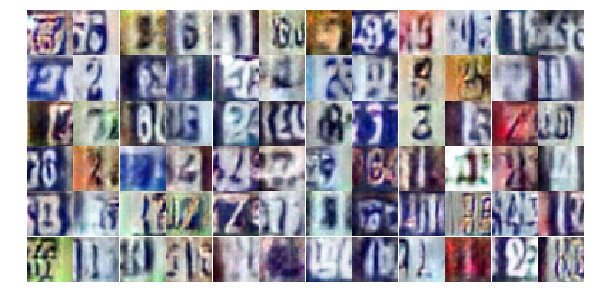

Epoch 16/25... Discriminator Loss: 0.4304... Generator Loss: 1.6864
Epoch 16/25... Discriminator Loss: 0.8210... Generator Loss: 0.8838
Epoch 16/25... Discriminator Loss: 0.6983... Generator Loss: 0.9944
Epoch 16/25... Discriminator Loss: 0.6264... Generator Loss: 1.2560
Epoch 16/25... Discriminator Loss: 0.9945... Generator Loss: 1.4617
Epoch 16/25... Discriminator Loss: 0.9734... Generator Loss: 0.8367
Epoch 16/25... Discriminator Loss: 0.9914... Generator Loss: 1.7347
Epoch 16/25... Discriminator Loss: 0.7416... Generator Loss: 1.3353
Epoch 16/25... Discriminator Loss: 0.6336... Generator Loss: 0.9976
Epoch 16/25... Discriminator Loss: 0.7868... Generator Loss: 1.0899


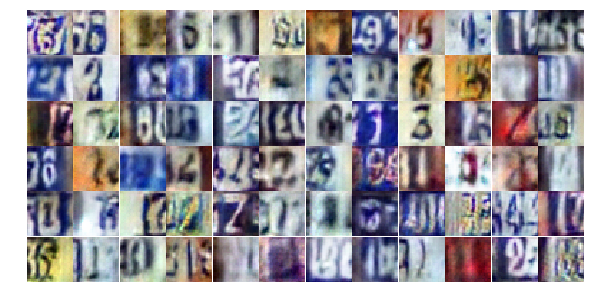

Epoch 16/25... Discriminator Loss: 0.9422... Generator Loss: 0.7233
Epoch 16/25... Discriminator Loss: 0.7282... Generator Loss: 1.1303
Epoch 16/25... Discriminator Loss: 0.4707... Generator Loss: 1.4243
Epoch 16/25... Discriminator Loss: 0.3636... Generator Loss: 1.6245
Epoch 16/25... Discriminator Loss: 1.5007... Generator Loss: 0.3425
Epoch 16/25... Discriminator Loss: 0.3413... Generator Loss: 1.7189
Epoch 17/25... Discriminator Loss: 0.9114... Generator Loss: 0.7706
Epoch 17/25... Discriminator Loss: 0.8362... Generator Loss: 0.8475
Epoch 17/25... Discriminator Loss: 0.4823... Generator Loss: 1.1925
Epoch 17/25... Discriminator Loss: 1.1960... Generator Loss: 0.5194


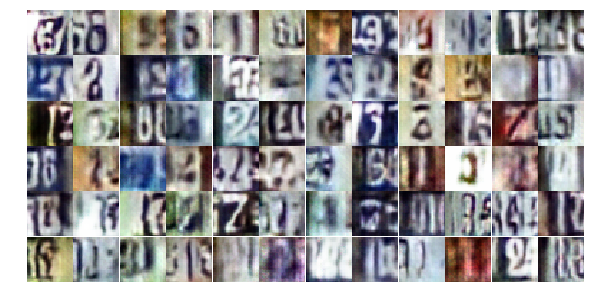

Epoch 17/25... Discriminator Loss: 0.6739... Generator Loss: 1.1744
Epoch 17/25... Discriminator Loss: 0.9687... Generator Loss: 0.7304
Epoch 17/25... Discriminator Loss: 0.6686... Generator Loss: 1.2368
Epoch 17/25... Discriminator Loss: 0.8661... Generator Loss: 0.7813
Epoch 17/25... Discriminator Loss: 1.1309... Generator Loss: 0.5419
Epoch 17/25... Discriminator Loss: 0.7297... Generator Loss: 0.9358
Epoch 17/25... Discriminator Loss: 2.7970... Generator Loss: 0.0859
Epoch 17/25... Discriminator Loss: 0.9082... Generator Loss: 0.8190
Epoch 17/25... Discriminator Loss: 1.1773... Generator Loss: 0.6295
Epoch 17/25... Discriminator Loss: 1.0200... Generator Loss: 0.7007


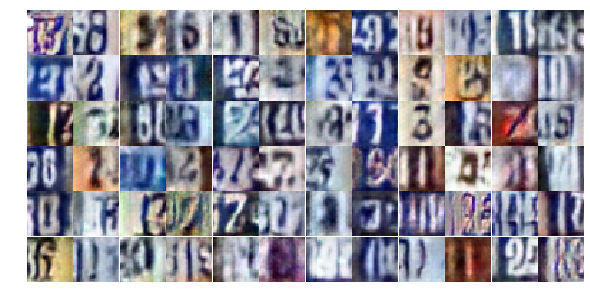

Epoch 17/25... Discriminator Loss: 1.1728... Generator Loss: 1.1656
Epoch 17/25... Discriminator Loss: 0.7645... Generator Loss: 0.9669
Epoch 17/25... Discriminator Loss: 1.3954... Generator Loss: 0.3746
Epoch 17/25... Discriminator Loss: 1.0126... Generator Loss: 0.6179
Epoch 17/25... Discriminator Loss: 0.7148... Generator Loss: 0.9028
Epoch 17/25... Discriminator Loss: 0.9499... Generator Loss: 0.5717
Epoch 17/25... Discriminator Loss: 0.7481... Generator Loss: 0.9590
Epoch 17/25... Discriminator Loss: 0.9920... Generator Loss: 0.6713
Epoch 17/25... Discriminator Loss: 0.5203... Generator Loss: 1.4469
Epoch 17/25... Discriminator Loss: 0.9413... Generator Loss: 0.6760


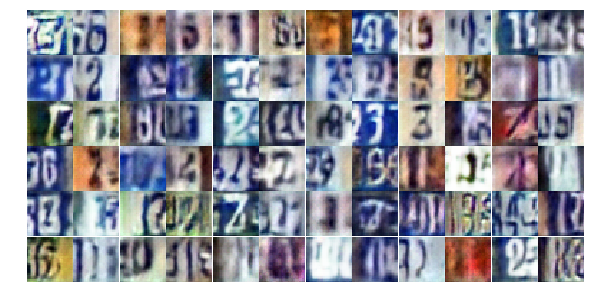

Epoch 17/25... Discriminator Loss: 1.2031... Generator Loss: 0.5338
Epoch 17/25... Discriminator Loss: 1.3878... Generator Loss: 0.3963
Epoch 17/25... Discriminator Loss: 0.6679... Generator Loss: 1.3615
Epoch 17/25... Discriminator Loss: 0.8709... Generator Loss: 0.9255
Epoch 17/25... Discriminator Loss: 0.5526... Generator Loss: 1.3071
Epoch 17/25... Discriminator Loss: 0.1999... Generator Loss: 2.1511
Epoch 17/25... Discriminator Loss: 0.6697... Generator Loss: 0.9731
Epoch 17/25... Discriminator Loss: 1.7399... Generator Loss: 0.2436
Epoch 17/25... Discriminator Loss: 1.1464... Generator Loss: 0.4935
Epoch 17/25... Discriminator Loss: 0.5546... Generator Loss: 1.5219


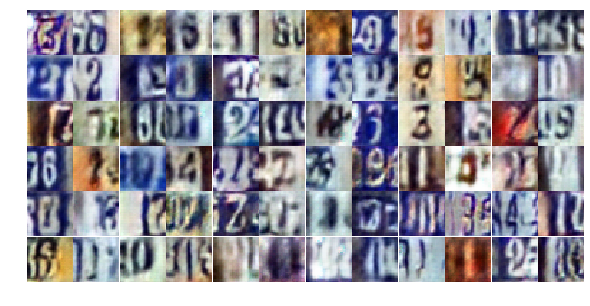

Epoch 17/25... Discriminator Loss: 0.9302... Generator Loss: 0.7880
Epoch 17/25... Discriminator Loss: 0.2031... Generator Loss: 3.4438
Epoch 17/25... Discriminator Loss: 0.0445... Generator Loss: 4.8903
Epoch 17/25... Discriminator Loss: 0.6686... Generator Loss: 1.1041
Epoch 17/25... Discriminator Loss: 0.8315... Generator Loss: 0.7819
Epoch 17/25... Discriminator Loss: 0.4278... Generator Loss: 1.5766
Epoch 17/25... Discriminator Loss: 0.4283... Generator Loss: 1.6019
Epoch 17/25... Discriminator Loss: 0.7376... Generator Loss: 0.9391
Epoch 17/25... Discriminator Loss: 0.5538... Generator Loss: 1.3628
Epoch 17/25... Discriminator Loss: 1.1542... Generator Loss: 0.6160


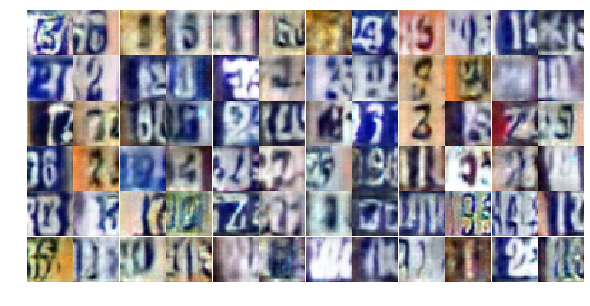

Epoch 17/25... Discriminator Loss: 0.9638... Generator Loss: 0.6326
Epoch 17/25... Discriminator Loss: 0.6070... Generator Loss: 1.5536
Epoch 17/25... Discriminator Loss: 0.4718... Generator Loss: 2.1302
Epoch 17/25... Discriminator Loss: 0.1277... Generator Loss: 3.1742
Epoch 17/25... Discriminator Loss: 0.6859... Generator Loss: 1.3961
Epoch 17/25... Discriminator Loss: 0.9782... Generator Loss: 1.1064
Epoch 17/25... Discriminator Loss: 0.8556... Generator Loss: 0.7673
Epoch 17/25... Discriminator Loss: 0.5267... Generator Loss: 1.3675
Epoch 17/25... Discriminator Loss: 1.1544... Generator Loss: 0.5472
Epoch 17/25... Discriminator Loss: 0.6985... Generator Loss: 1.3703


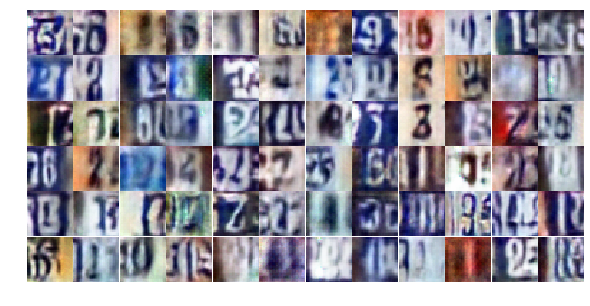

Epoch 17/25... Discriminator Loss: 1.2400... Generator Loss: 0.4900
Epoch 17/25... Discriminator Loss: 1.8021... Generator Loss: 0.2646
Epoch 17/25... Discriminator Loss: 0.6866... Generator Loss: 1.4731
Epoch 17/25... Discriminator Loss: 1.3295... Generator Loss: 0.4585
Epoch 18/25... Discriminator Loss: 0.7382... Generator Loss: 1.1306
Epoch 18/25... Discriminator Loss: 0.6072... Generator Loss: 1.0622
Epoch 18/25... Discriminator Loss: 0.5658... Generator Loss: 1.5078
Epoch 18/25... Discriminator Loss: 0.6538... Generator Loss: 1.1008
Epoch 18/25... Discriminator Loss: 1.4086... Generator Loss: 0.3796
Epoch 18/25... Discriminator Loss: 0.7162... Generator Loss: 1.3349


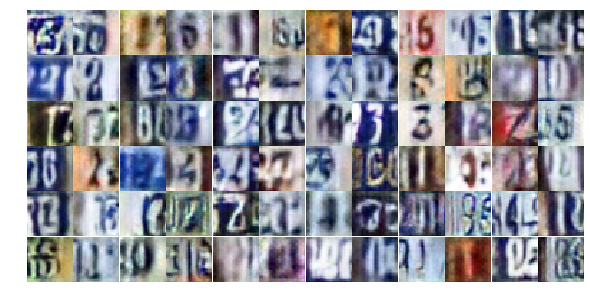

Epoch 18/25... Discriminator Loss: 0.6868... Generator Loss: 1.4395
Epoch 18/25... Discriminator Loss: 1.3313... Generator Loss: 0.5140
Epoch 18/25... Discriminator Loss: 0.2436... Generator Loss: 2.1355
Epoch 18/25... Discriminator Loss: 0.1047... Generator Loss: 9.9539
Epoch 18/25... Discriminator Loss: 0.5888... Generator Loss: 1.9398
Epoch 18/25... Discriminator Loss: 0.5635... Generator Loss: 1.2260
Epoch 18/25... Discriminator Loss: 0.3718... Generator Loss: 1.9021
Epoch 18/25... Discriminator Loss: 1.1292... Generator Loss: 0.6362
Epoch 18/25... Discriminator Loss: 0.5921... Generator Loss: 1.0508
Epoch 18/25... Discriminator Loss: 0.5844... Generator Loss: 1.9148


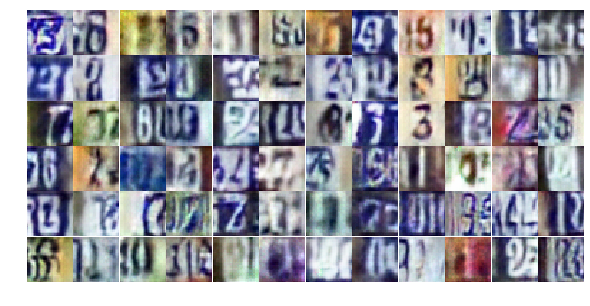

Epoch 18/25... Discriminator Loss: 1.0821... Generator Loss: 0.5480
Epoch 18/25... Discriminator Loss: 1.2459... Generator Loss: 0.5001
Epoch 18/25... Discriminator Loss: 1.4083... Generator Loss: 1.1763
Epoch 18/25... Discriminator Loss: 0.9565... Generator Loss: 0.7495
Epoch 18/25... Discriminator Loss: 0.4929... Generator Loss: 1.5675
Epoch 18/25... Discriminator Loss: 0.6768... Generator Loss: 0.9839
Epoch 18/25... Discriminator Loss: 0.4962... Generator Loss: 1.2541
Epoch 18/25... Discriminator Loss: 0.4541... Generator Loss: 1.4483
Epoch 18/25... Discriminator Loss: 0.8226... Generator Loss: 0.8799
Epoch 18/25... Discriminator Loss: 0.9316... Generator Loss: 0.8052


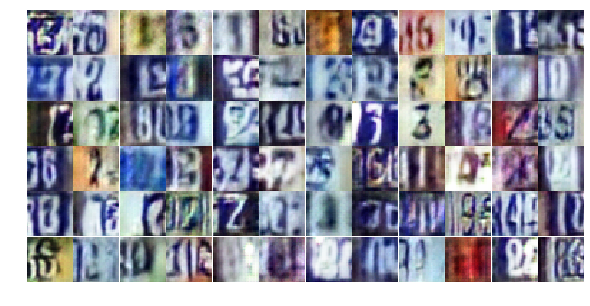

Epoch 18/25... Discriminator Loss: 0.3886... Generator Loss: 1.7092
Epoch 18/25... Discriminator Loss: 0.9222... Generator Loss: 0.7093
Epoch 18/25... Discriminator Loss: 1.0850... Generator Loss: 0.7398
Epoch 18/25... Discriminator Loss: 0.8733... Generator Loss: 1.0990
Epoch 18/25... Discriminator Loss: 1.3166... Generator Loss: 0.5082
Epoch 18/25... Discriminator Loss: 0.6390... Generator Loss: 1.2668
Epoch 18/25... Discriminator Loss: 0.8757... Generator Loss: 0.7516
Epoch 18/25... Discriminator Loss: 1.0892... Generator Loss: 0.6065
Epoch 18/25... Discriminator Loss: 0.6664... Generator Loss: 1.0796
Epoch 18/25... Discriminator Loss: 0.6291... Generator Loss: 1.4407


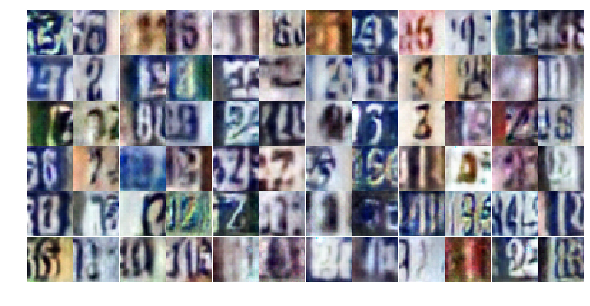

Epoch 18/25... Discriminator Loss: 1.2541... Generator Loss: 0.5121
Epoch 18/25... Discriminator Loss: 1.4138... Generator Loss: 0.4088
Epoch 18/25... Discriminator Loss: 0.2086... Generator Loss: 2.5683
Epoch 18/25... Discriminator Loss: 1.3397... Generator Loss: 0.4950
Epoch 18/25... Discriminator Loss: 0.7419... Generator Loss: 1.0129
Epoch 18/25... Discriminator Loss: 0.2966... Generator Loss: 2.0795
Epoch 18/25... Discriminator Loss: 1.2461... Generator Loss: 0.4625
Epoch 18/25... Discriminator Loss: 0.8667... Generator Loss: 1.5104
Epoch 18/25... Discriminator Loss: 0.8605... Generator Loss: 0.7660
Epoch 18/25... Discriminator Loss: 0.4127... Generator Loss: 1.4990


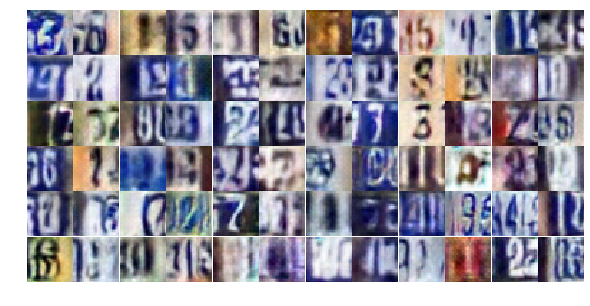

Epoch 18/25... Discriminator Loss: 1.0740... Generator Loss: 0.6732
Epoch 18/25... Discriminator Loss: 2.4151... Generator Loss: 0.1261
Epoch 18/25... Discriminator Loss: 0.4945... Generator Loss: 1.6785
Epoch 18/25... Discriminator Loss: 0.5447... Generator Loss: 1.2270
Epoch 18/25... Discriminator Loss: 0.7328... Generator Loss: 1.2290
Epoch 18/25... Discriminator Loss: 0.6554... Generator Loss: 1.3040
Epoch 18/25... Discriminator Loss: 0.4470... Generator Loss: 2.0752
Epoch 18/25... Discriminator Loss: 0.4473... Generator Loss: 1.4620
Epoch 18/25... Discriminator Loss: 0.9183... Generator Loss: 0.7151
Epoch 18/25... Discriminator Loss: 0.8321... Generator Loss: 1.4156


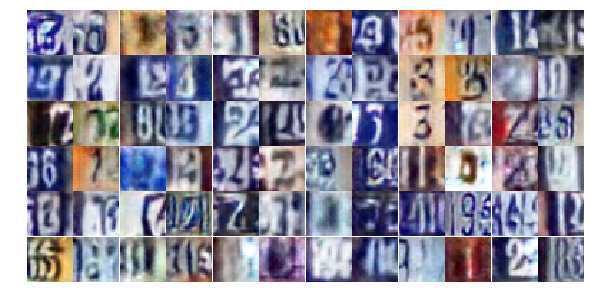

Epoch 18/25... Discriminator Loss: 0.3899... Generator Loss: 1.5719
Epoch 19/25... Discriminator Loss: 0.7040... Generator Loss: 0.8568
Epoch 19/25... Discriminator Loss: 0.9757... Generator Loss: 0.6383
Epoch 19/25... Discriminator Loss: 0.4389... Generator Loss: 1.3627
Epoch 19/25... Discriminator Loss: 0.3514... Generator Loss: 1.5977
Epoch 19/25... Discriminator Loss: 0.6090... Generator Loss: 1.1514
Epoch 19/25... Discriminator Loss: 0.4537... Generator Loss: 1.3268
Epoch 19/25... Discriminator Loss: 0.7726... Generator Loss: 1.9484
Epoch 19/25... Discriminator Loss: 0.4082... Generator Loss: 1.7284
Epoch 19/25... Discriminator Loss: 0.5148... Generator Loss: 1.4246


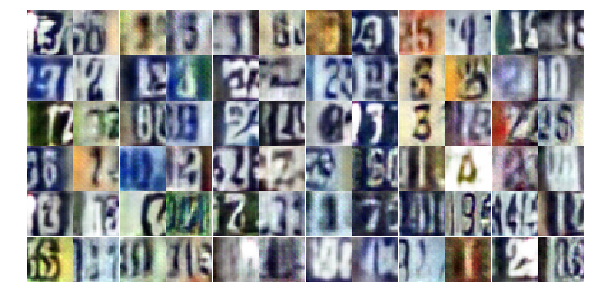

Epoch 19/25... Discriminator Loss: 0.9304... Generator Loss: 1.1217
Epoch 19/25... Discriminator Loss: 0.6246... Generator Loss: 1.8972
Epoch 19/25... Discriminator Loss: 0.8675... Generator Loss: 0.8159
Epoch 19/25... Discriminator Loss: 1.0738... Generator Loss: 0.6275
Epoch 19/25... Discriminator Loss: 1.0234... Generator Loss: 0.6402
Epoch 19/25... Discriminator Loss: 1.7068... Generator Loss: 0.2927
Epoch 19/25... Discriminator Loss: 0.0752... Generator Loss: 4.5519
Epoch 19/25... Discriminator Loss: 0.4083... Generator Loss: 1.5158
Epoch 19/25... Discriminator Loss: 0.6040... Generator Loss: 1.0848
Epoch 19/25... Discriminator Loss: 0.6521... Generator Loss: 0.9891


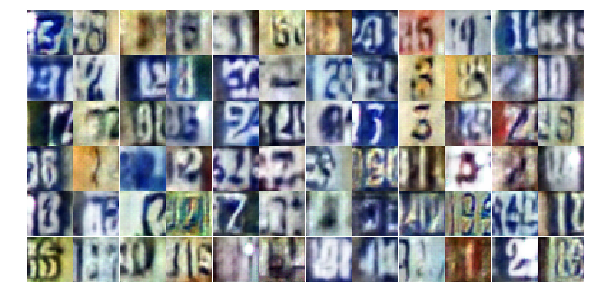

Epoch 19/25... Discriminator Loss: 0.7511... Generator Loss: 0.8134
Epoch 19/25... Discriminator Loss: 1.1939... Generator Loss: 0.5068
Epoch 19/25... Discriminator Loss: 0.7780... Generator Loss: 0.8694
Epoch 19/25... Discriminator Loss: 0.7927... Generator Loss: 1.0516
Epoch 19/25... Discriminator Loss: 0.4352... Generator Loss: 1.3226
Epoch 19/25... Discriminator Loss: 1.1907... Generator Loss: 0.6471
Epoch 19/25... Discriminator Loss: 0.0959... Generator Loss: 3.8137
Epoch 19/25... Discriminator Loss: 0.7649... Generator Loss: 0.8364
Epoch 19/25... Discriminator Loss: 1.3437... Generator Loss: 0.3908
Epoch 19/25... Discriminator Loss: 1.0096... Generator Loss: 0.8654


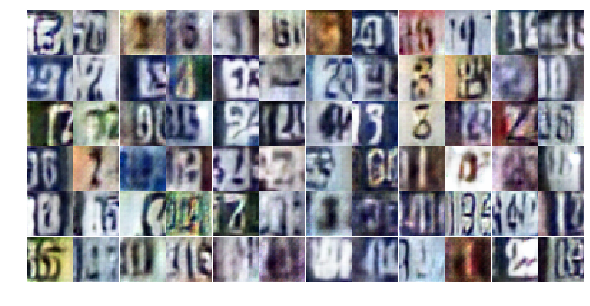

Epoch 19/25... Discriminator Loss: 0.7887... Generator Loss: 1.5457
Epoch 19/25... Discriminator Loss: 1.2224... Generator Loss: 0.4660
Epoch 19/25... Discriminator Loss: 0.8270... Generator Loss: 0.9193
Epoch 19/25... Discriminator Loss: 0.5842... Generator Loss: 1.1315
Epoch 19/25... Discriminator Loss: 0.3593... Generator Loss: 1.8823
Epoch 19/25... Discriminator Loss: 1.5213... Generator Loss: 0.3741
Epoch 19/25... Discriminator Loss: 0.4845... Generator Loss: 1.3053
Epoch 19/25... Discriminator Loss: 0.7948... Generator Loss: 0.8595
Epoch 19/25... Discriminator Loss: 0.6408... Generator Loss: 0.9870
Epoch 19/25... Discriminator Loss: 1.1296... Generator Loss: 0.4780


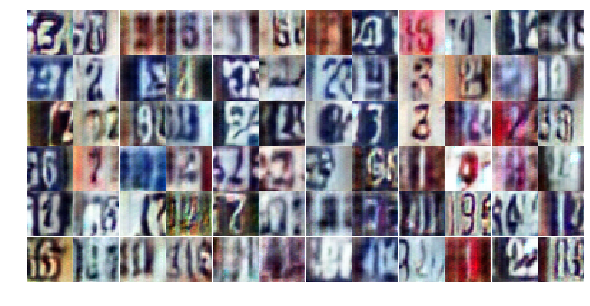

Epoch 19/25... Discriminator Loss: 0.5836... Generator Loss: 1.0754
Epoch 19/25... Discriminator Loss: 1.0877... Generator Loss: 0.5483
Epoch 19/25... Discriminator Loss: 1.3488... Generator Loss: 0.4336
Epoch 19/25... Discriminator Loss: 0.9063... Generator Loss: 2.0631
Epoch 19/25... Discriminator Loss: 1.3268... Generator Loss: 0.4065
Epoch 19/25... Discriminator Loss: 1.9047... Generator Loss: 0.5454
Epoch 19/25... Discriminator Loss: 0.8533... Generator Loss: 0.8983
Epoch 19/25... Discriminator Loss: 0.5911... Generator Loss: 1.2181
Epoch 19/25... Discriminator Loss: 1.0054... Generator Loss: 0.6890
Epoch 19/25... Discriminator Loss: 0.5381... Generator Loss: 2.3287


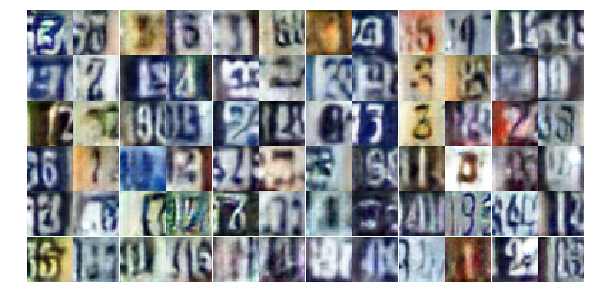

Epoch 19/25... Discriminator Loss: 1.0856... Generator Loss: 1.3619
Epoch 19/25... Discriminator Loss: 1.0410... Generator Loss: 0.7804
Epoch 19/25... Discriminator Loss: 0.8259... Generator Loss: 0.8070
Epoch 19/25... Discriminator Loss: 1.4953... Generator Loss: 0.3267
Epoch 19/25... Discriminator Loss: 1.6469... Generator Loss: 0.3026
Epoch 19/25... Discriminator Loss: 1.0259... Generator Loss: 0.8178
Epoch 19/25... Discriminator Loss: 0.6673... Generator Loss: 1.2590
Epoch 19/25... Discriminator Loss: 0.7718... Generator Loss: 0.9007
Epoch 20/25... Discriminator Loss: 0.9591... Generator Loss: 1.1610
Epoch 20/25... Discriminator Loss: 1.3279... Generator Loss: 0.5128


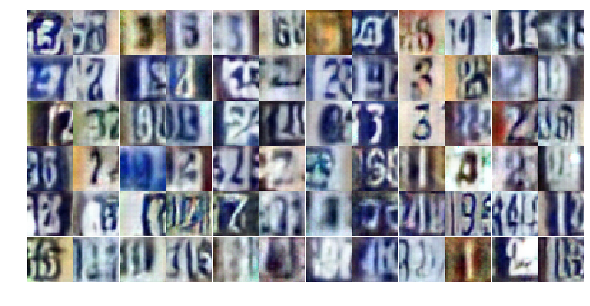

Epoch 20/25... Discriminator Loss: 0.8671... Generator Loss: 0.9079
Epoch 20/25... Discriminator Loss: 0.9301... Generator Loss: 0.8904
Epoch 20/25... Discriminator Loss: 1.4775... Generator Loss: 0.3571
Epoch 20/25... Discriminator Loss: 0.3039... Generator Loss: 1.7704
Epoch 20/25... Discriminator Loss: 0.3457... Generator Loss: 2.5656
Epoch 20/25... Discriminator Loss: 1.2087... Generator Loss: 0.5289
Epoch 20/25... Discriminator Loss: 1.8068... Generator Loss: 0.2276
Epoch 20/25... Discriminator Loss: 0.4586... Generator Loss: 1.4549
Epoch 20/25... Discriminator Loss: 0.2179... Generator Loss: 2.8410
Epoch 20/25... Discriminator Loss: 0.5834... Generator Loss: 1.1067


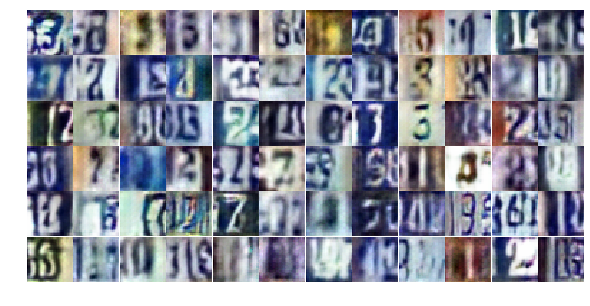

Epoch 20/25... Discriminator Loss: 1.8884... Generator Loss: 1.7592
Epoch 20/25... Discriminator Loss: 1.1198... Generator Loss: 0.5581
Epoch 20/25... Discriminator Loss: 0.9602... Generator Loss: 1.3195
Epoch 20/25... Discriminator Loss: 0.2157... Generator Loss: 2.1247
Epoch 20/25... Discriminator Loss: 0.4157... Generator Loss: 1.4766
Epoch 20/25... Discriminator Loss: 0.6679... Generator Loss: 1.4446
Epoch 20/25... Discriminator Loss: 1.0676... Generator Loss: 0.5947
Epoch 20/25... Discriminator Loss: 0.8634... Generator Loss: 0.9558
Epoch 20/25... Discriminator Loss: 0.4942... Generator Loss: 1.4433
Epoch 20/25... Discriminator Loss: 1.5443... Generator Loss: 0.3300


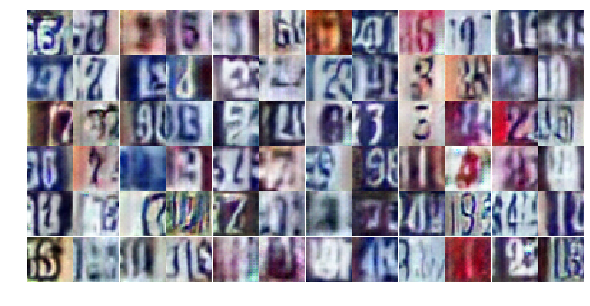

Epoch 20/25... Discriminator Loss: 0.8412... Generator Loss: 1.5041
Epoch 20/25... Discriminator Loss: 0.5391... Generator Loss: 1.2251
Epoch 20/25... Discriminator Loss: 0.6256... Generator Loss: 0.8985
Epoch 20/25... Discriminator Loss: 0.8949... Generator Loss: 1.1685
Epoch 20/25... Discriminator Loss: 1.1305... Generator Loss: 0.6114
Epoch 20/25... Discriminator Loss: 0.6628... Generator Loss: 0.9182
Epoch 20/25... Discriminator Loss: 1.0907... Generator Loss: 0.5923
Epoch 20/25... Discriminator Loss: 0.8444... Generator Loss: 0.8185
Epoch 20/25... Discriminator Loss: 0.5009... Generator Loss: 2.4167
Epoch 20/25... Discriminator Loss: 0.6391... Generator Loss: 1.0389


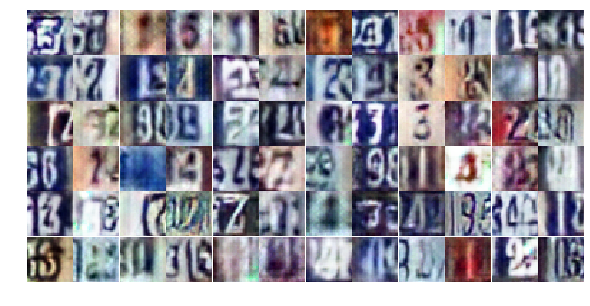

Epoch 20/25... Discriminator Loss: 0.9217... Generator Loss: 0.8504
Epoch 20/25... Discriminator Loss: 0.3703... Generator Loss: 1.6715
Epoch 20/25... Discriminator Loss: 1.0676... Generator Loss: 0.6549
Epoch 20/25... Discriminator Loss: 0.2772... Generator Loss: 1.9183
Epoch 20/25... Discriminator Loss: 0.7346... Generator Loss: 1.1681
Epoch 20/25... Discriminator Loss: 0.0443... Generator Loss: 4.7737
Epoch 20/25... Discriminator Loss: 0.7606... Generator Loss: 0.9340
Epoch 20/25... Discriminator Loss: 0.5948... Generator Loss: 1.1348
Epoch 20/25... Discriminator Loss: 0.3702... Generator Loss: 1.6276
Epoch 20/25... Discriminator Loss: 0.5297... Generator Loss: 1.2101


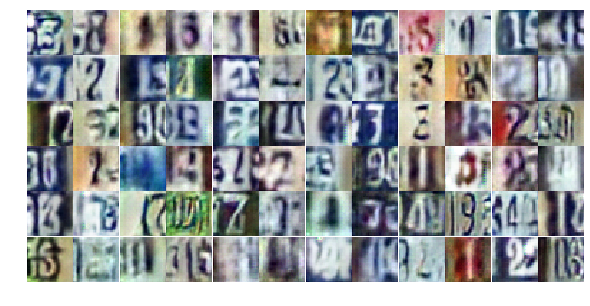

Epoch 20/25... Discriminator Loss: 0.5168... Generator Loss: 1.1851
Epoch 20/25... Discriminator Loss: 0.4581... Generator Loss: 1.3183
Epoch 20/25... Discriminator Loss: 0.7651... Generator Loss: 7.2785
Epoch 20/25... Discriminator Loss: 0.4515... Generator Loss: 1.6075
Epoch 20/25... Discriminator Loss: 1.2736... Generator Loss: 0.5253
Epoch 20/25... Discriminator Loss: 1.8606... Generator Loss: 0.2342
Epoch 20/25... Discriminator Loss: 0.3433... Generator Loss: 1.5562
Epoch 20/25... Discriminator Loss: 0.8097... Generator Loss: 0.8972
Epoch 20/25... Discriminator Loss: 0.6621... Generator Loss: 1.0992
Epoch 20/25... Discriminator Loss: 0.5566... Generator Loss: 1.2853


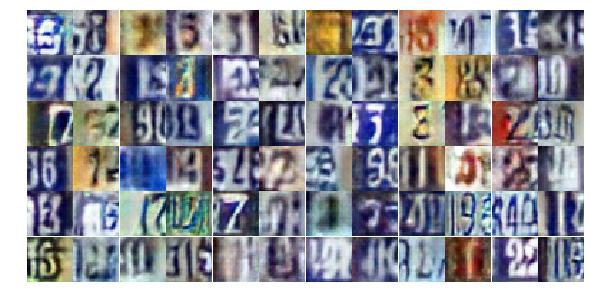

Epoch 20/25... Discriminator Loss: 0.5941... Generator Loss: 1.0464
Epoch 20/25... Discriminator Loss: 0.5581... Generator Loss: 1.1832
Epoch 20/25... Discriminator Loss: 0.9740... Generator Loss: 0.7843
Epoch 20/25... Discriminator Loss: 0.6707... Generator Loss: 1.1609
Epoch 20/25... Discriminator Loss: 0.5399... Generator Loss: 1.2628
Epoch 20/25... Discriminator Loss: 0.4929... Generator Loss: 2.9833
Epoch 21/25... Discriminator Loss: 0.8415... Generator Loss: 0.9660
Epoch 21/25... Discriminator Loss: 0.8219... Generator Loss: 0.7848
Epoch 21/25... Discriminator Loss: 0.9139... Generator Loss: 0.8489
Epoch 21/25... Discriminator Loss: 0.7456... Generator Loss: 1.0873


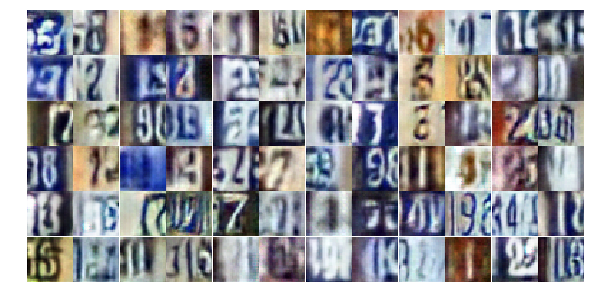

Epoch 21/25... Discriminator Loss: 0.7971... Generator Loss: 0.9320
Epoch 21/25... Discriminator Loss: 0.9533... Generator Loss: 0.7918
Epoch 21/25... Discriminator Loss: 0.2759... Generator Loss: 1.9991
Epoch 21/25... Discriminator Loss: 0.4917... Generator Loss: 1.3638
Epoch 21/25... Discriminator Loss: 1.5106... Generator Loss: 0.3788
Epoch 21/25... Discriminator Loss: 1.6554... Generator Loss: 0.3085
Epoch 21/25... Discriminator Loss: 0.7053... Generator Loss: 1.1504
Epoch 21/25... Discriminator Loss: 0.8047... Generator Loss: 0.8027
Epoch 21/25... Discriminator Loss: 0.5501... Generator Loss: 1.4589
Epoch 21/25... Discriminator Loss: 0.4588... Generator Loss: 1.2362


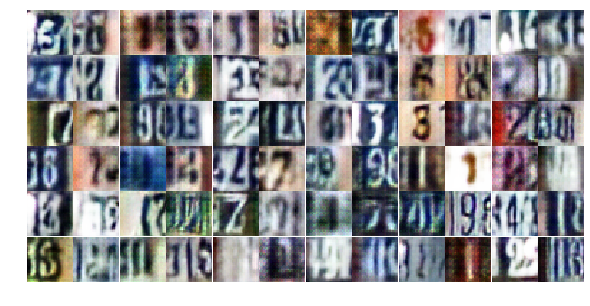

Epoch 21/25... Discriminator Loss: 0.4633... Generator Loss: 1.2918
Epoch 21/25... Discriminator Loss: 0.3866... Generator Loss: 1.5038
Epoch 21/25... Discriminator Loss: 0.2172... Generator Loss: 2.8253
Epoch 21/25... Discriminator Loss: 0.9358... Generator Loss: 1.0596
Epoch 21/25... Discriminator Loss: 0.9873... Generator Loss: 0.7107
Epoch 21/25... Discriminator Loss: 1.3676... Generator Loss: 0.3891
Epoch 21/25... Discriminator Loss: 0.6526... Generator Loss: 1.0278
Epoch 21/25... Discriminator Loss: 1.2511... Generator Loss: 0.4511
Epoch 21/25... Discriminator Loss: 0.8393... Generator Loss: 0.7426
Epoch 21/25... Discriminator Loss: 0.4500... Generator Loss: 1.3189


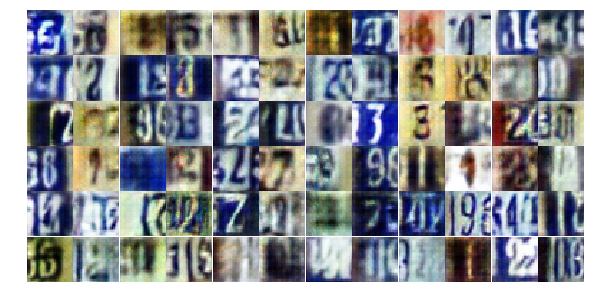

Epoch 21/25... Discriminator Loss: 0.8643... Generator Loss: 1.4957
Epoch 21/25... Discriminator Loss: 0.4030... Generator Loss: 1.5099
Epoch 21/25... Discriminator Loss: 0.6259... Generator Loss: 1.1866
Epoch 21/25... Discriminator Loss: 1.2372... Generator Loss: 0.4122
Epoch 21/25... Discriminator Loss: 1.0870... Generator Loss: 1.2472
Epoch 21/25... Discriminator Loss: 1.0732... Generator Loss: 0.6421
Epoch 21/25... Discriminator Loss: 0.9175... Generator Loss: 1.8888
Epoch 21/25... Discriminator Loss: 1.2989... Generator Loss: 0.4901
Epoch 21/25... Discriminator Loss: 0.7601... Generator Loss: 1.1230
Epoch 21/25... Discriminator Loss: 0.7149... Generator Loss: 1.4223


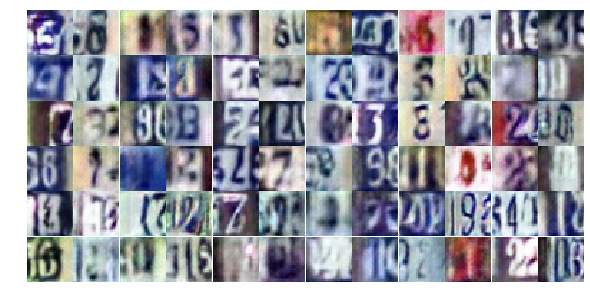

Epoch 21/25... Discriminator Loss: 1.0843... Generator Loss: 0.5818
Epoch 21/25... Discriminator Loss: 0.7437... Generator Loss: 0.9668
Epoch 21/25... Discriminator Loss: 0.0946... Generator Loss: 2.9716
Epoch 21/25... Discriminator Loss: 0.6326... Generator Loss: 1.0502
Epoch 21/25... Discriminator Loss: 0.7323... Generator Loss: 0.8408
Epoch 21/25... Discriminator Loss: 0.3542... Generator Loss: 1.7503
Epoch 21/25... Discriminator Loss: 0.6377... Generator Loss: 1.0256
Epoch 21/25... Discriminator Loss: 2.3465... Generator Loss: 0.1477
Epoch 21/25... Discriminator Loss: 0.8689... Generator Loss: 1.1389
Epoch 21/25... Discriminator Loss: 0.4147... Generator Loss: 1.5555


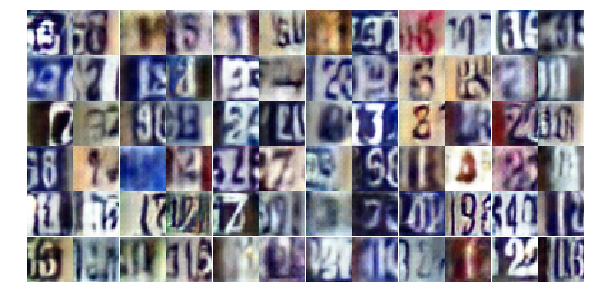

Epoch 21/25... Discriminator Loss: 0.8925... Generator Loss: 0.7172
Epoch 21/25... Discriminator Loss: 1.0881... Generator Loss: 0.5558
Epoch 21/25... Discriminator Loss: 0.4635... Generator Loss: 1.4031
Epoch 21/25... Discriminator Loss: 0.9653... Generator Loss: 0.7987
Epoch 21/25... Discriminator Loss: 0.3942... Generator Loss: 1.9506
Epoch 21/25... Discriminator Loss: 0.7590... Generator Loss: 1.0415
Epoch 21/25... Discriminator Loss: 0.9740... Generator Loss: 0.7804
Epoch 21/25... Discriminator Loss: 1.2963... Generator Loss: 0.4177
Epoch 21/25... Discriminator Loss: 1.2161... Generator Loss: 0.4870
Epoch 21/25... Discriminator Loss: 0.7141... Generator Loss: 0.9257


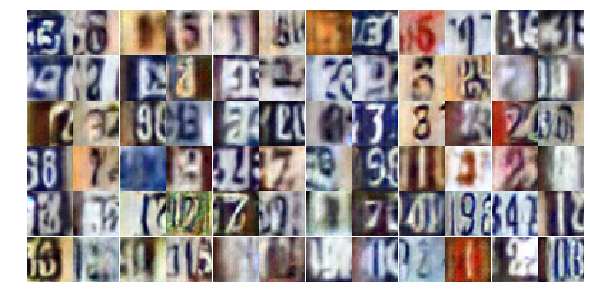

Epoch 21/25... Discriminator Loss: 0.4134... Generator Loss: 1.7048
Epoch 21/25... Discriminator Loss: 1.0546... Generator Loss: 0.5878
Epoch 21/25... Discriminator Loss: 0.9760... Generator Loss: 0.7131
Epoch 22/25... Discriminator Loss: 0.7908... Generator Loss: 0.9911
Epoch 22/25... Discriminator Loss: 0.0252... Generator Loss: 10.0817
Epoch 22/25... Discriminator Loss: 1.0202... Generator Loss: 0.5825
Epoch 22/25... Discriminator Loss: 0.4936... Generator Loss: 1.2745
Epoch 22/25... Discriminator Loss: 0.4948... Generator Loss: 1.2342
Epoch 22/25... Discriminator Loss: 0.1026... Generator Loss: 3.6832
Epoch 22/25... Discriminator Loss: 0.2735... Generator Loss: 2.1159


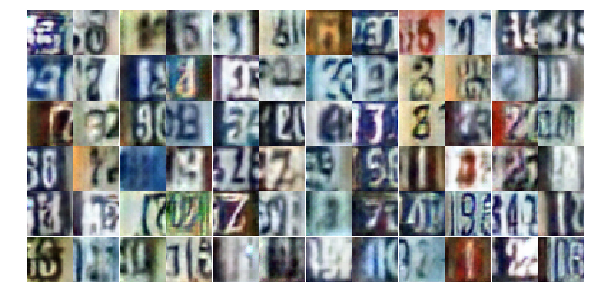

Epoch 22/25... Discriminator Loss: 1.3159... Generator Loss: 0.4183
Epoch 22/25... Discriminator Loss: 0.8096... Generator Loss: 0.7812
Epoch 22/25... Discriminator Loss: 0.5261... Generator Loss: 1.7635
Epoch 22/25... Discriminator Loss: 1.1238... Generator Loss: 0.5501
Epoch 22/25... Discriminator Loss: 1.2638... Generator Loss: 0.5018
Epoch 22/25... Discriminator Loss: 1.1545... Generator Loss: 1.7439
Epoch 22/25... Discriminator Loss: 0.1907... Generator Loss: 2.6212
Epoch 22/25... Discriminator Loss: 0.2253... Generator Loss: 2.7975
Epoch 22/25... Discriminator Loss: 1.4133... Generator Loss: 0.5121
Epoch 22/25... Discriminator Loss: 0.4704... Generator Loss: 1.5997


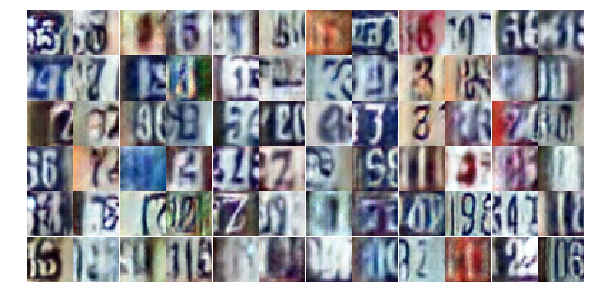

Epoch 22/25... Discriminator Loss: 0.6244... Generator Loss: 1.1291
Epoch 22/25... Discriminator Loss: 0.4807... Generator Loss: 1.4141
Epoch 22/25... Discriminator Loss: 0.8145... Generator Loss: 0.9190
Epoch 22/25... Discriminator Loss: 0.1411... Generator Loss: 4.7410
Epoch 22/25... Discriminator Loss: 0.7070... Generator Loss: 0.9892
Epoch 22/25... Discriminator Loss: 0.8424... Generator Loss: 0.7199
Epoch 22/25... Discriminator Loss: 0.9515... Generator Loss: 0.7394
Epoch 22/25... Discriminator Loss: 0.7147... Generator Loss: 0.9149
Epoch 22/25... Discriminator Loss: 1.6505... Generator Loss: 0.3017
Epoch 22/25... Discriminator Loss: 0.7585... Generator Loss: 0.8262


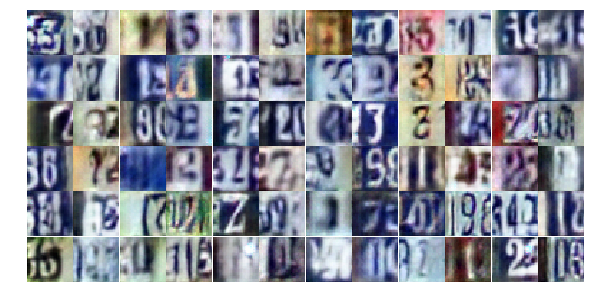

Epoch 22/25... Discriminator Loss: 0.6166... Generator Loss: 1.1374
Epoch 22/25... Discriminator Loss: 0.3492... Generator Loss: 2.1822
Epoch 22/25... Discriminator Loss: 0.7051... Generator Loss: 0.9102
Epoch 22/25... Discriminator Loss: 1.1061... Generator Loss: 0.5782
Epoch 22/25... Discriminator Loss: 1.0685... Generator Loss: 0.5890
Epoch 22/25... Discriminator Loss: 1.4615... Generator Loss: 0.4067
Epoch 22/25... Discriminator Loss: 1.2587... Generator Loss: 0.4807
Epoch 22/25... Discriminator Loss: 0.9587... Generator Loss: 2.8778
Epoch 22/25... Discriminator Loss: 0.8187... Generator Loss: 0.8265
Epoch 22/25... Discriminator Loss: 0.7727... Generator Loss: 0.8897


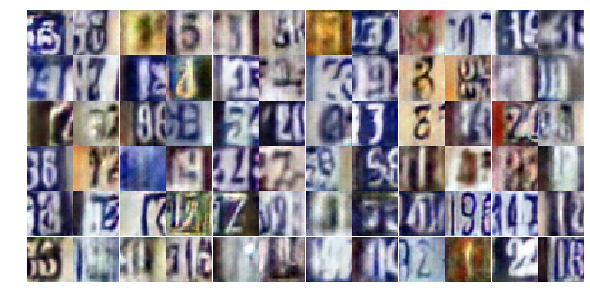

Epoch 22/25... Discriminator Loss: 0.7427... Generator Loss: 1.0136
Epoch 22/25... Discriminator Loss: 0.2462... Generator Loss: 2.2145
Epoch 22/25... Discriminator Loss: 0.8317... Generator Loss: 1.0020
Epoch 22/25... Discriminator Loss: 0.9054... Generator Loss: 1.3264
Epoch 22/25... Discriminator Loss: 0.4700... Generator Loss: 1.3995
Epoch 22/25... Discriminator Loss: 0.4382... Generator Loss: 1.4330
Epoch 22/25... Discriminator Loss: 0.7007... Generator Loss: 0.9747
Epoch 22/25... Discriminator Loss: 0.8437... Generator Loss: 0.8861
Epoch 22/25... Discriminator Loss: 0.9116... Generator Loss: 0.7851
Epoch 22/25... Discriminator Loss: 0.6664... Generator Loss: 1.0986


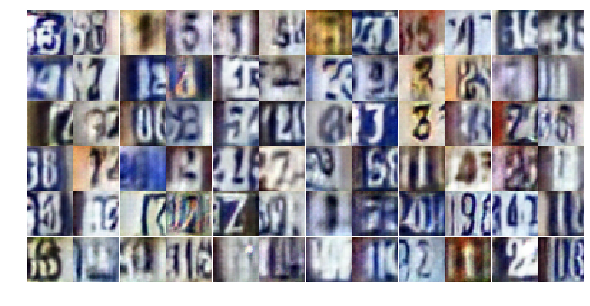

Epoch 22/25... Discriminator Loss: 1.0386... Generator Loss: 0.6540
Epoch 22/25... Discriminator Loss: 0.9832... Generator Loss: 0.6868
Epoch 22/25... Discriminator Loss: 1.0021... Generator Loss: 0.8708
Epoch 22/25... Discriminator Loss: 0.9388... Generator Loss: 0.8794
Epoch 22/25... Discriminator Loss: 0.7144... Generator Loss: 1.0043
Epoch 22/25... Discriminator Loss: 1.1038... Generator Loss: 0.6486
Epoch 22/25... Discriminator Loss: 1.1483... Generator Loss: 3.0576
Epoch 22/25... Discriminator Loss: 0.7884... Generator Loss: 0.7810
Epoch 22/25... Discriminator Loss: 0.8395... Generator Loss: 0.7806
Epoch 22/25... Discriminator Loss: 0.5806... Generator Loss: 1.2758


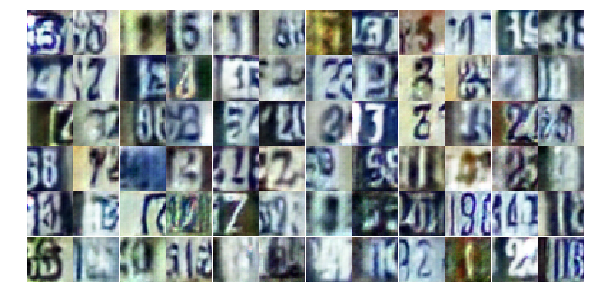

Epoch 23/25... Discriminator Loss: 0.7303... Generator Loss: 0.8795
Epoch 23/25... Discriminator Loss: 0.8290... Generator Loss: 1.2937
Epoch 23/25... Discriminator Loss: 0.8466... Generator Loss: 0.8599
Epoch 23/25... Discriminator Loss: 0.7535... Generator Loss: 1.3027
Epoch 23/25... Discriminator Loss: 0.5762... Generator Loss: 1.1363
Epoch 23/25... Discriminator Loss: 1.3723... Generator Loss: 0.4154
Epoch 23/25... Discriminator Loss: 0.7281... Generator Loss: 0.8841
Epoch 23/25... Discriminator Loss: 0.3073... Generator Loss: 1.7928
Epoch 23/25... Discriminator Loss: 0.7478... Generator Loss: 1.1838
Epoch 23/25... Discriminator Loss: 0.7297... Generator Loss: 1.1115


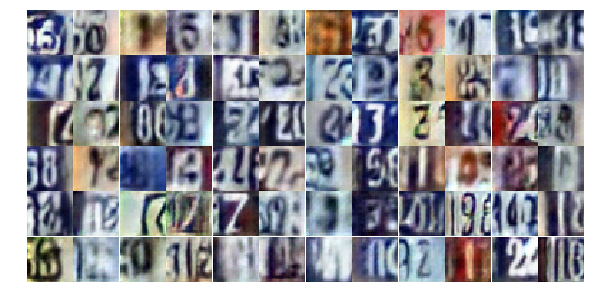

Epoch 23/25... Discriminator Loss: 0.7068... Generator Loss: 1.0180
Epoch 23/25... Discriminator Loss: 0.6792... Generator Loss: 0.9830
Epoch 23/25... Discriminator Loss: 1.1406... Generator Loss: 0.5370
Epoch 23/25... Discriminator Loss: 1.3535... Generator Loss: 0.4094
Epoch 23/25... Discriminator Loss: 0.7163... Generator Loss: 1.8077
Epoch 23/25... Discriminator Loss: 0.8585... Generator Loss: 0.7703
Epoch 23/25... Discriminator Loss: 0.0517... Generator Loss: 4.9347
Epoch 23/25... Discriminator Loss: 0.3709... Generator Loss: 1.5255
Epoch 23/25... Discriminator Loss: 1.9422... Generator Loss: 0.2145
Epoch 23/25... Discriminator Loss: 1.5364... Generator Loss: 0.3237


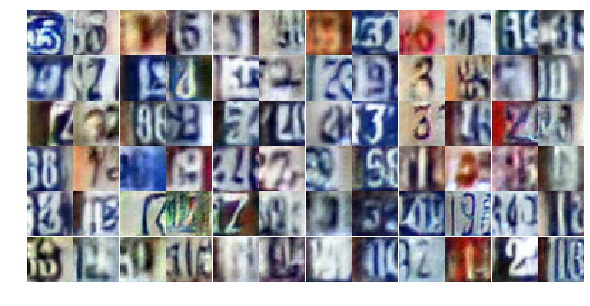

Epoch 23/25... Discriminator Loss: 0.6065... Generator Loss: 1.3148
Epoch 23/25... Discriminator Loss: 0.9009... Generator Loss: 0.7769
Epoch 23/25... Discriminator Loss: 0.3683... Generator Loss: 1.6141
Epoch 23/25... Discriminator Loss: 0.4473... Generator Loss: 1.3546
Epoch 23/25... Discriminator Loss: 1.4887... Generator Loss: 0.4270
Epoch 23/25... Discriminator Loss: 0.3571... Generator Loss: 1.9230
Epoch 23/25... Discriminator Loss: 0.5097... Generator Loss: 1.3222
Epoch 23/25... Discriminator Loss: 0.9332... Generator Loss: 0.6752
Epoch 23/25... Discriminator Loss: 0.7809... Generator Loss: 1.7130
Epoch 23/25... Discriminator Loss: 0.9230... Generator Loss: 0.8910


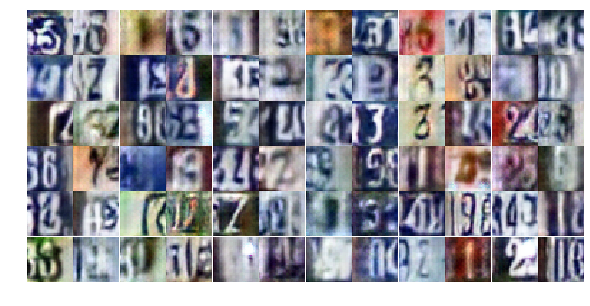

Epoch 23/25... Discriminator Loss: 0.9933... Generator Loss: 0.7171
Epoch 23/25... Discriminator Loss: 0.7745... Generator Loss: 0.9482
Epoch 23/25... Discriminator Loss: 1.2849... Generator Loss: 0.4660
Epoch 23/25... Discriminator Loss: 0.9530... Generator Loss: 0.7581
Epoch 23/25... Discriminator Loss: 2.1455... Generator Loss: 2.7810
Epoch 23/25... Discriminator Loss: 1.9420... Generator Loss: 0.2164
Epoch 23/25... Discriminator Loss: 1.2019... Generator Loss: 0.7011
Epoch 23/25... Discriminator Loss: 0.7096... Generator Loss: 0.9441
Epoch 23/25... Discriminator Loss: 0.4271... Generator Loss: 1.8206
Epoch 23/25... Discriminator Loss: 1.2810... Generator Loss: 0.4781


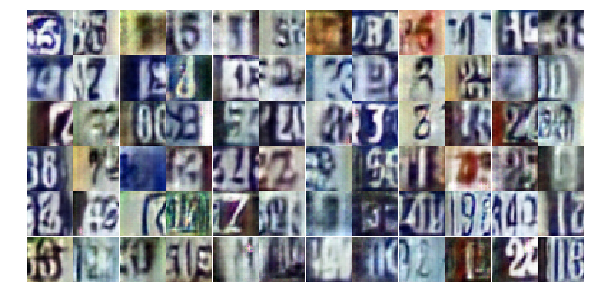

Epoch 23/25... Discriminator Loss: 0.7106... Generator Loss: 1.0726
Epoch 23/25... Discriminator Loss: 1.0517... Generator Loss: 0.5756
Epoch 23/25... Discriminator Loss: 0.7625... Generator Loss: 0.9052
Epoch 23/25... Discriminator Loss: 0.4518... Generator Loss: 1.5447
Epoch 23/25... Discriminator Loss: 2.1604... Generator Loss: 0.1860
Epoch 23/25... Discriminator Loss: 1.2042... Generator Loss: 0.5750
Epoch 23/25... Discriminator Loss: 0.5869... Generator Loss: 1.9713
Epoch 23/25... Discriminator Loss: 0.7397... Generator Loss: 1.5829
Epoch 23/25... Discriminator Loss: 0.7539... Generator Loss: 1.0365
Epoch 23/25... Discriminator Loss: 0.7095... Generator Loss: 1.0129


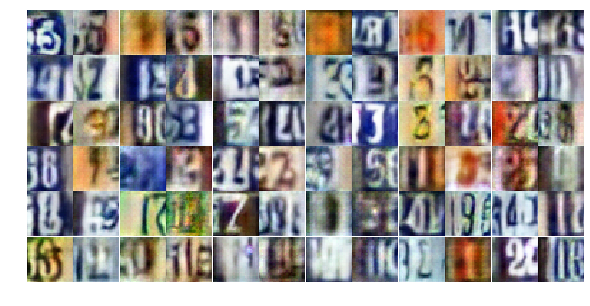

Epoch 23/25... Discriminator Loss: 0.8310... Generator Loss: 0.7418
Epoch 23/25... Discriminator Loss: 1.0451... Generator Loss: 0.5699
Epoch 23/25... Discriminator Loss: 1.0936... Generator Loss: 0.5905
Epoch 23/25... Discriminator Loss: 0.8028... Generator Loss: 0.7728
Epoch 23/25... Discriminator Loss: 0.8707... Generator Loss: 0.9449
Epoch 23/25... Discriminator Loss: 0.2618... Generator Loss: 2.0262
Epoch 23/25... Discriminator Loss: 0.5295... Generator Loss: 1.1065
Epoch 24/25... Discriminator Loss: 0.7650... Generator Loss: 1.6137
Epoch 24/25... Discriminator Loss: 0.9231... Generator Loss: 0.7130
Epoch 24/25... Discriminator Loss: 0.7764... Generator Loss: 0.8635


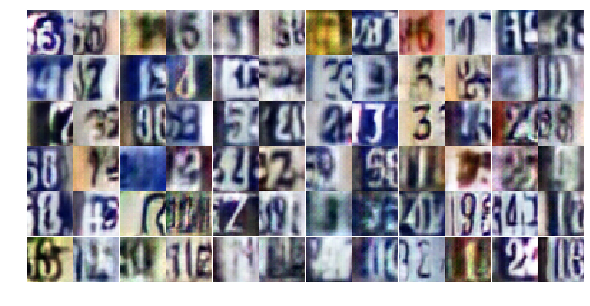

Epoch 24/25... Discriminator Loss: 0.6892... Generator Loss: 0.9794
Epoch 24/25... Discriminator Loss: 0.9558... Generator Loss: 0.6675
Epoch 24/25... Discriminator Loss: 0.8476... Generator Loss: 0.8790
Epoch 24/25... Discriminator Loss: 0.9220... Generator Loss: 0.8988
Epoch 24/25... Discriminator Loss: 1.4437... Generator Loss: 0.3922
Epoch 24/25... Discriminator Loss: 0.5733... Generator Loss: 1.5223
Epoch 24/25... Discriminator Loss: 0.7194... Generator Loss: 1.0398
Epoch 24/25... Discriminator Loss: 1.0216... Generator Loss: 0.6503
Epoch 24/25... Discriminator Loss: 0.7285... Generator Loss: 0.8669
Epoch 24/25... Discriminator Loss: 0.2057... Generator Loss: 2.7398


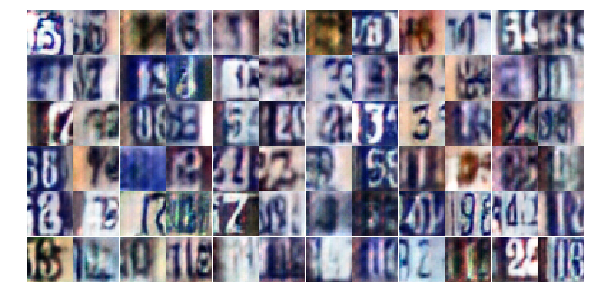

Epoch 24/25... Discriminator Loss: 0.3347... Generator Loss: 1.7127
Epoch 24/25... Discriminator Loss: 1.4009... Generator Loss: 0.3820
Epoch 24/25... Discriminator Loss: 0.9484... Generator Loss: 0.6877
Epoch 24/25... Discriminator Loss: 0.5835... Generator Loss: 1.3458
Epoch 24/25... Discriminator Loss: 0.5707... Generator Loss: 1.4770
Epoch 24/25... Discriminator Loss: 0.5561... Generator Loss: 1.2402
Epoch 24/25... Discriminator Loss: 0.8990... Generator Loss: 0.7297
Epoch 24/25... Discriminator Loss: 0.4633... Generator Loss: 1.6362
Epoch 24/25... Discriminator Loss: 1.1599... Generator Loss: 0.7203
Epoch 24/25... Discriminator Loss: 1.4342... Generator Loss: 0.3928


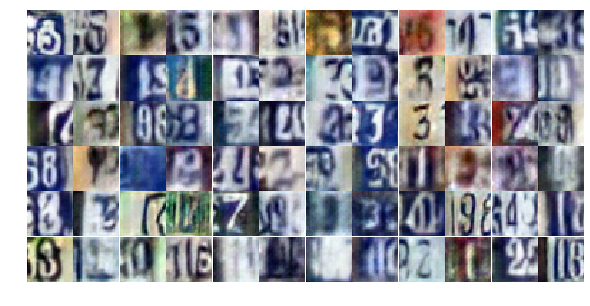

Epoch 24/25... Discriminator Loss: 0.7632... Generator Loss: 0.8236
Epoch 24/25... Discriminator Loss: 0.9143... Generator Loss: 0.7302
Epoch 24/25... Discriminator Loss: 0.8169... Generator Loss: 0.7998
Epoch 24/25... Discriminator Loss: 0.2761... Generator Loss: 2.0990
Epoch 24/25... Discriminator Loss: 1.0793... Generator Loss: 0.5983
Epoch 24/25... Discriminator Loss: 0.4143... Generator Loss: 1.9633
Epoch 24/25... Discriminator Loss: 0.4872... Generator Loss: 1.6974
Epoch 24/25... Discriminator Loss: 0.4968... Generator Loss: 1.3337
Epoch 24/25... Discriminator Loss: 0.4366... Generator Loss: 1.9047
Epoch 24/25... Discriminator Loss: 1.0925... Generator Loss: 0.6263


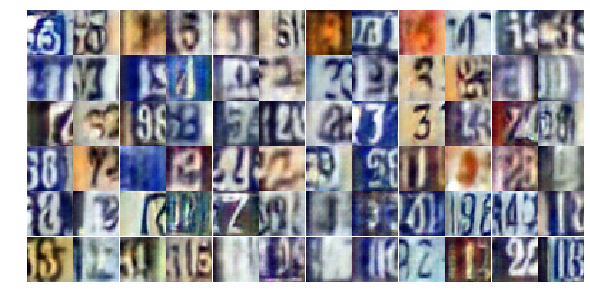

Epoch 24/25... Discriminator Loss: 0.6964... Generator Loss: 1.1362
Epoch 24/25... Discriminator Loss: 0.9031... Generator Loss: 0.6758
Epoch 24/25... Discriminator Loss: 0.6475... Generator Loss: 0.9841
Epoch 24/25... Discriminator Loss: 0.5972... Generator Loss: 1.4935
Epoch 24/25... Discriminator Loss: 0.2937... Generator Loss: 3.0743
Epoch 24/25... Discriminator Loss: 0.6219... Generator Loss: 1.2376
Epoch 24/25... Discriminator Loss: 0.7563... Generator Loss: 0.9248
Epoch 24/25... Discriminator Loss: 0.6185... Generator Loss: 1.1344
Epoch 24/25... Discriminator Loss: 0.6270... Generator Loss: 1.1769
Epoch 24/25... Discriminator Loss: 1.5561... Generator Loss: 1.2712


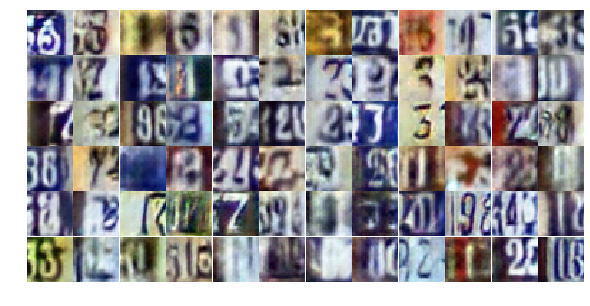

Epoch 24/25... Discriminator Loss: 0.9102... Generator Loss: 1.2575
Epoch 24/25... Discriminator Loss: 0.6374... Generator Loss: 1.0318
Epoch 24/25... Discriminator Loss: 1.2536... Generator Loss: 0.5236
Epoch 24/25... Discriminator Loss: 0.7710... Generator Loss: 1.4555
Epoch 24/25... Discriminator Loss: 0.7296... Generator Loss: 0.9396
Epoch 24/25... Discriminator Loss: 0.7275... Generator Loss: 1.2850
Epoch 24/25... Discriminator Loss: 1.4451... Generator Loss: 0.4503
Epoch 24/25... Discriminator Loss: 0.7185... Generator Loss: 0.8840
Epoch 24/25... Discriminator Loss: 1.2015... Generator Loss: 0.5847
Epoch 24/25... Discriminator Loss: 0.5846... Generator Loss: 1.2030


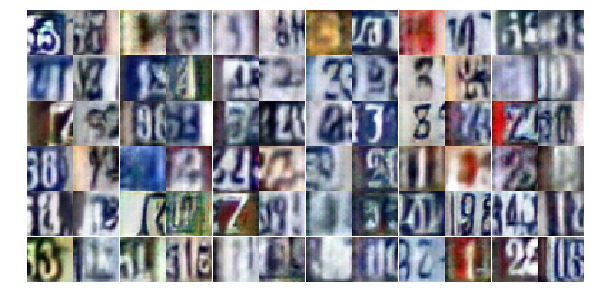

Epoch 24/25... Discriminator Loss: 0.4904... Generator Loss: 3.7955
Epoch 24/25... Discriminator Loss: 0.7352... Generator Loss: 0.8580
Epoch 24/25... Discriminator Loss: 0.3045... Generator Loss: 2.2005
Epoch 24/25... Discriminator Loss: 1.0000... Generator Loss: 2.0135
Epoch 24/25... Discriminator Loss: 0.1828... Generator Loss: 2.1513
Epoch 25/25... Discriminator Loss: 0.2018... Generator Loss: 4.0621
Epoch 25/25... Discriminator Loss: 0.5359... Generator Loss: 1.1574
Epoch 25/25... Discriminator Loss: 0.0220... Generator Loss: 6.5424
Epoch 25/25... Discriminator Loss: 0.1397... Generator Loss: 2.5466
Epoch 25/25... Discriminator Loss: 0.1661... Generator Loss: 2.2648


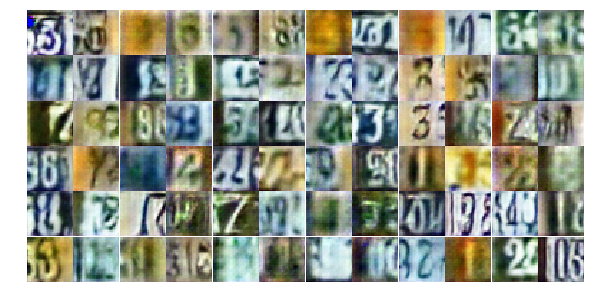

Epoch 25/25... Discriminator Loss: 0.2131... Generator Loss: 2.1982
Epoch 25/25... Discriminator Loss: 0.0386... Generator Loss: 5.6610
Epoch 25/25... Discriminator Loss: 0.2247... Generator Loss: 1.9826
Epoch 25/25... Discriminator Loss: 0.0341... Generator Loss: 4.6700
Epoch 25/25... Discriminator Loss: 0.2324... Generator Loss: 1.9727
Epoch 25/25... Discriminator Loss: 0.1239... Generator Loss: 2.6306
Epoch 25/25... Discriminator Loss: 0.0541... Generator Loss: 4.5138
Epoch 25/25... Discriminator Loss: 0.0378... Generator Loss: 3.9446
Epoch 25/25... Discriminator Loss: 0.0510... Generator Loss: 3.5097
Epoch 25/25... Discriminator Loss: 0.0493... Generator Loss: 3.7881


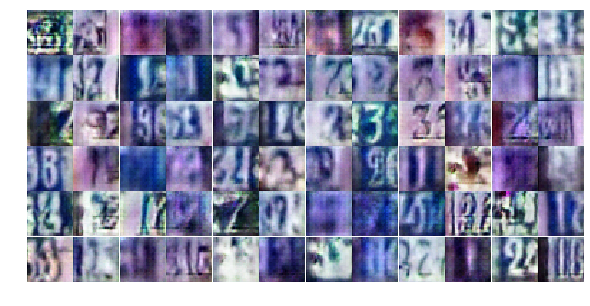

Epoch 25/25... Discriminator Loss: 0.5306... Generator Loss: 1.2021
Epoch 25/25... Discriminator Loss: 0.0732... Generator Loss: 3.3720
Epoch 25/25... Discriminator Loss: 0.1229... Generator Loss: 2.6401
Epoch 25/25... Discriminator Loss: 0.4431... Generator Loss: 1.6082
Epoch 25/25... Discriminator Loss: 1.1285... Generator Loss: 0.9434
Epoch 25/25... Discriminator Loss: 0.7797... Generator Loss: 3.9489
Epoch 25/25... Discriminator Loss: 0.6299... Generator Loss: 1.3446
Epoch 25/25... Discriminator Loss: 0.3800... Generator Loss: 2.3780
Epoch 25/25... Discriminator Loss: 0.5463... Generator Loss: 1.7692
Epoch 25/25... Discriminator Loss: 1.1708... Generator Loss: 0.5990


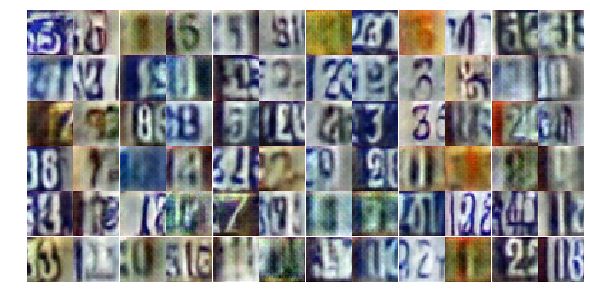

Epoch 25/25... Discriminator Loss: 0.9324... Generator Loss: 1.5852
Epoch 25/25... Discriminator Loss: 0.5932... Generator Loss: 1.9498
Epoch 25/25... Discriminator Loss: 1.2348... Generator Loss: 0.5239
Epoch 25/25... Discriminator Loss: 0.2557... Generator Loss: 2.4006
Epoch 25/25... Discriminator Loss: 0.7232... Generator Loss: 1.0012
Epoch 25/25... Discriminator Loss: 0.6141... Generator Loss: 2.1647
Epoch 25/25... Discriminator Loss: 1.0126... Generator Loss: 0.6605
Epoch 25/25... Discriminator Loss: 0.6926... Generator Loss: 1.0024
Epoch 25/25... Discriminator Loss: 0.7537... Generator Loss: 0.9453
Epoch 25/25... Discriminator Loss: 0.9528... Generator Loss: 0.8252


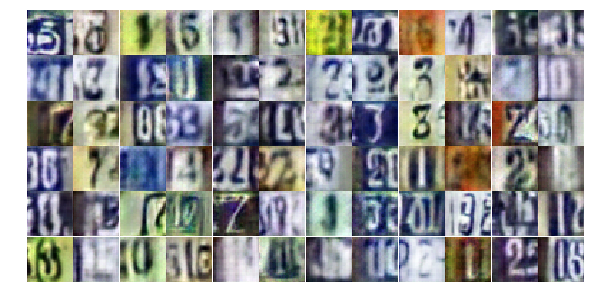

Epoch 25/25... Discriminator Loss: 0.6665... Generator Loss: 1.2437
Epoch 25/25... Discriminator Loss: 0.7947... Generator Loss: 0.8687
Epoch 25/25... Discriminator Loss: 0.6873... Generator Loss: 1.3934
Epoch 25/25... Discriminator Loss: 0.8016... Generator Loss: 0.9373
Epoch 25/25... Discriminator Loss: 0.7486... Generator Loss: 0.9814
Epoch 25/25... Discriminator Loss: 1.3082... Generator Loss: 0.4528
Epoch 25/25... Discriminator Loss: 0.8961... Generator Loss: 0.7799
Epoch 25/25... Discriminator Loss: 0.4543... Generator Loss: 1.3879
Epoch 25/25... Discriminator Loss: 1.4016... Generator Loss: 0.4345
Epoch 25/25... Discriminator Loss: 1.3868... Generator Loss: 0.4695


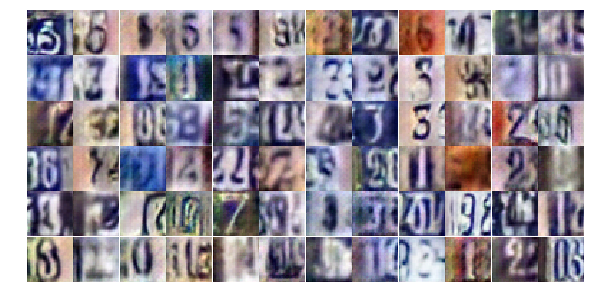

Epoch 25/25... Discriminator Loss: 1.3433... Generator Loss: 0.4199
Epoch 25/25... Discriminator Loss: 0.9518... Generator Loss: 0.6927
Epoch 25/25... Discriminator Loss: 0.8256... Generator Loss: 1.1982
Epoch 25/25... Discriminator Loss: 2.4592... Generator Loss: 0.1329
Epoch 25/25... Discriminator Loss: 1.0209... Generator Loss: 0.6448
Epoch 25/25... Discriminator Loss: 0.5509... Generator Loss: 1.2792
Epoch 25/25... Discriminator Loss: 0.6400... Generator Loss: 1.0239
Epoch 25/25... Discriminator Loss: 0.4475... Generator Loss: 1.6581
Epoch 25/25... Discriminator Loss: 0.5609... Generator Loss: 1.6200
Epoch 25/25... Discriminator Loss: 0.8393... Generator Loss: 0.9551


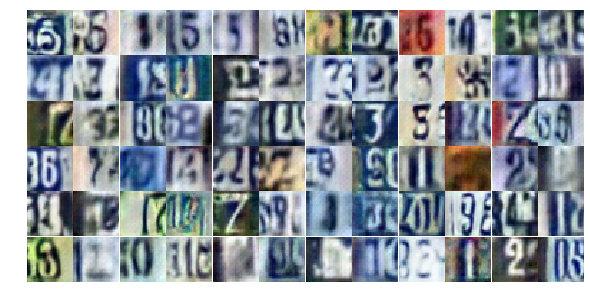

Epoch 25/25... Discriminator Loss: 2.0413... Generator Loss: 0.3728
Epoch 25/25... Discriminator Loss: 1.0928... Generator Loss: 0.6059


In [18]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

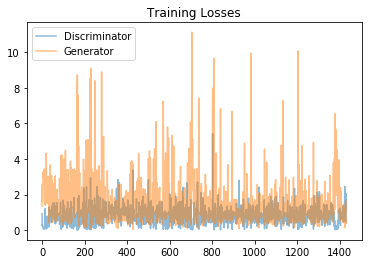

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

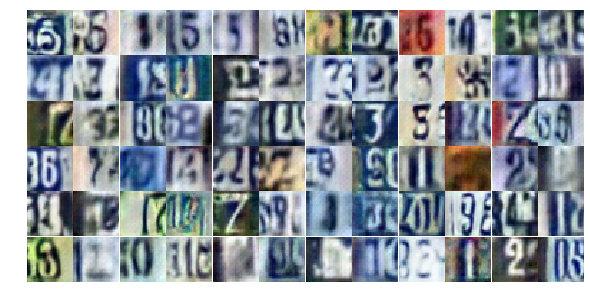

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))